In [556]:
# Libs for Data Treatment and Vizualization
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
# from google.colab import drive

In [557]:
# drive.mount('/content/drive')

# 0. Dataset Global Models (Sorocaba-Ipero 2023 | Server Side)⭐

## Data collection

In [558]:
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_A713 - Sorocaba_Ipero/2023/INMET_SE_SP_A713_SOROCABA_IPERO-Dataset_01-01-2023_A_31-12-2023.CSV'
file_path = 'Datasets Brutos/Estacao_A713 - Sorocaba_Ipero/2023/INMET_SE_SP_A713_SOROCABA_IPERO-Dataset_01-01-2023_A_31-12-2023.CSV'

# Upload CSV file into DataFrame
df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [559]:
print("Dataframe format:")
print(f" ↪Linhas: {df.shape[0]} \n ↪Colunas: {df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
df.head()

Dataframe format:
 ↪Linhas: 8760 
 ↪Colunas: 20

---

First 5 lines of the dataset:


,Data,Hora UTC,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)",Unnamed: 19
0,2023/01/01,0000 UTC,0.0,946.8,946.8,946.1,NaN,21.4,19.3,22.1,21.4,19.5,19.0,88,83,88,64,3.1,1.8,NaN
1,2023/01/01,0100 UTC,0.0,947.2,947.3,946.8,NaN,20.5,18.9,21.4,20.5,19.4,18.7,90,88,90,203,2.9,0.7,NaN
2,2023/01/01,0200 UTC,0.0,946.9,947.4,946.9,NaN,20.9,19.2,20.9,20.4,19.2,18.9,91,89,90,203,1.7,0.1,NaN
3,2023/01/01,0300 UTC,0.0,946.3,947.0,946.3,NaN,19.8,18.6,21.1,19.8,19.3,18.4,93,88,93,183,0.8,0.0,NaN
4,2023/01/01,0400 UTC,0.0,945.5,946.3,945.5,NaN,19.9,18.6,20.0,19.6,18.9,18.5,94,92,92,115,1.9,0.9,NaN


In [560]:
# Data general info
print("General Dataset Information:")
print(df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 20 columns):
 #   Column                                                 Non-Null Count  Dtype  
---  ------                                                 --------------  -----  
 0   Data                                                   8760 non-null   object 
 1   Hora UTC                                               8760 non-null   object 
 2   PRECIPITAÇÃO TOTAL, HORÁRIO (mm)                       8759 non-null   float64
 3   PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)  8760 non-null   float64
 4   PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)        8760 non-null   float64
 5   PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)       8760 non-null   float64
 6   RADIACAO GLOBAL (Kj/m²)                                4717 non-null   float64
 7   TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)           8760 non-null   float64
 8   TEMPERATURA DO PONT

In [561]:
print("Descriptive statistics:")
df.describe()

Descriptive statistics:


,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)",Unnamed: 19
count,8759.000000,8760.000000,8760.000000,8760.000000,4717.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,0.0
mean,0.165635,946.700103,946.966233,946.434155,1421.047276,21.138653,15.779064,21.873710,20.436279,16.383219,15.213550,77.415753,71.224201,74.359018,183.620548,2.029475,0.528550,NaN
std,1.276997,3.714636,3.679728,3.739907,1094.599868,5.179185,3.573687,5.301524,5.058027,3.525236,3.645587,16.616353,18.817387,17.858720,85.728000,2.953847,1.293609,NaN
min,0.000000,934.200000,934.600000,933.700000,0.000000,6.000000,1.400000,6.400000,5.300000,2.800000,0.300000,21.000000,15.000000,18.000000,1.000000,0.000000,0.000000,NaN
25%,0.000000,944.100000,944.500000,943.900000,365.100000,17.800000,13.100000,18.300000,17.200000,13.700000,12.500000,67.000000,57.000000,62.000000,120.000000,0.100000,0.000000,NaN
50%,0.000000,946.700000,947.000000,946.400000,1312.200000,20.700000,16.300000,21.300000,20.200000,16.900000,15.800000,83.000000,76.000000,80.000000,175.000000,0.600000,0.000000,NaN
75%,0.000000,949.400000,949.600000,949.100000,2346.200000,24.600000,18.800000,25.500000,23.700000,19.300000,18.300000,91.000000,87.000000,89.000000,247.000000,2.800000,0.100000,NaN
max,37.000000,959.200000,959.200000,959.000000,4238.300000,37.600000,22.800000,37.700000,37.000000,23.600000,22.500000,97.000000,97.000000,97.000000,360.000000,25.400000,8.700000,NaN


## Data Pre-Processing

In [562]:
# --------------------
# Data Pre-Processing
# --------------------

# Removing 'UTC' from the time column
df['Hora UTC'] = df['Hora UTC'].str.replace(' UTC', '')

# Convert the UTC format to datetime format (only hour and minute)
df['Hora Datetime'] = pd.to_datetime(df['Hora UTC'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
df['Data e Hora (datetime)'] = df['Data'] + ' ' + df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
df['Data e Hora (datetime)'] = pd.to_datetime(df['Data e Hora (datetime)'])

df['Data e Hora (datetime)'].head()

0   2023-01-01 00:00:00
1   2023-01-01 01:00:00
2   2023-01-01 02:00:00
3   2023-01-01 03:00:00
4   2023-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [563]:
df.head()

,Data,Hora UTC,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),...,TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)",Unnamed: 19,Hora Datetime,Data e Hora (datetime)
0,2023/01/01,0000,0.0,946.8,946.8,946.1,NaN,21.4,19.3,22.1,...,19.0,88,83,88,64,3.1,1.8,NaN,00:00:00,2023-01-01 00:00:00
1,2023/01/01,0100,0.0,947.2,947.3,946.8,NaN,20.5,18.9,21.4,...,18.7,90,88,90,203,2.9,0.7,NaN,01:00:00,2023-01-01 01:00:00
2,2023/01/01,0200,0.0,946.9,947.4,946.9,NaN,20.9,19.2,20.9,...,18.9,91,89,90,203,1.7,0.1,NaN,02:00:00,2023-01-01 02:00:00
3,2023/01/01,0300,0.0,946.3,947.0,946.3,NaN,19.8,18.6,21.1,...,18.4,93,88,93,183,0.8,0.0,NaN,03:00:00,2023-01-01 03:00:00
4,2023/01/01,0400,0.0,945.5,946.3,945.5,NaN,19.9,18.6,20.0,...,18.5,94,92,92,115,1.9,0.9,NaN,04:00:00,2023-01-01 04:00:00


In [564]:
# Removing "Data", "Hora UTC", "Hora Datetime" columns and one with no values
df = df.drop(columns=['Data', 'Hora UTC', 'Hora Datetime', 'Unnamed: 19'])
# df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = df.pop(column)          # remove the column
df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(df.shape)

df.head()

DataFrame format:
(8760, 18)


,Data e Hora (datetime),"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)"
0,2023-01-01 00:00:00,0.0,946.8,946.8,946.1,NaN,21.4,19.3,22.1,21.4,19.5,19.0,88,83,88,64,3.1,1.8
1,2023-01-01 01:00:00,0.0,947.2,947.3,946.8,NaN,20.5,18.9,21.4,20.5,19.4,18.7,90,88,90,203,2.9,0.7
2,2023-01-01 02:00:00,0.0,946.9,947.4,946.9,NaN,20.9,19.2,20.9,20.4,19.2,18.9,91,89,90,203,1.7,0.1
3,2023-01-01 03:00:00,0.0,946.3,947.0,946.3,NaN,19.8,18.6,21.1,19.8,19.3,18.4,93,88,93,183,0.8,0.0
4,2023-01-01 04:00:00,0.0,945.5,946.3,945.5,NaN,19.9,18.6,20.0,19.6,18.9,18.5,94,92,92,115,1.9,0.9


In [565]:
# Indexing of the 'Datetime' Date and Time
df.set_index('Data e Hora (datetime)', inplace=True)

df.head()

,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)"
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,0.0,946.8,946.8,946.1,NaN,21.4,19.3,22.1,21.4,19.5,19.0,88,83,88,64,3.1,1.8
2023-01-01 01:00:00,0.0,947.2,947.3,946.8,NaN,20.5,18.9,21.4,20.5,19.4,18.7,90,88,90,203,2.9,0.7
2023-01-01 02:00:00,0.0,946.9,947.4,946.9,NaN,20.9,19.2,20.9,20.4,19.2,18.9,91,89,90,203,1.7,0.1
2023-01-01 03:00:00,0.0,946.3,947.0,946.3,NaN,19.8,18.6,21.1,19.8,19.3,18.4,93,88,93,183,0.8,0.0
2023-01-01 04:00:00,0.0,945.5,946.3,945.5,NaN,19.9,18.6,20.0,19.6,18.9,18.5,94,92,92,115,1.9,0.9


In [566]:
# Check missing values
print("Amount of missing values per column:")
print(df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(df.isnull().mean() * 100)

Amount of missing values per column:
PRECIPITAÇÃO TOTAL, HORÁRIO (mm)                            1
PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)       0
PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)             0
PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)            0
RADIACAO GLOBAL (Kj/m²)                                  4043
TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)                0
TEMPERATURA DO PONTO DE ORVALHO (°C)                        0
TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)                  0
TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C)                  0
TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C)            0
TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C)            0
UMIDADE REL. MAX. NA HORA ANT. (AUT) (%)                    0
UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)                    0
UMIDADE RELATIVA DO AR, HORARIA (%)                         0
VENTO, DIREÇÃO HORARIA (gr) (° (gr))                        0
VENTO, RAJADA MAXIMA (m/s)       

In [567]:
# Fill in missing values with the median
df['RADIACAO GLOBAL (Kj/m²)'] = df['RADIACAO GLOBAL (Kj/m²)'].fillna(df['RADIACAO GLOBAL (Kj/m²)'].median())

In [568]:
# Fill missing value in 'total precipitation, time (mm)' performing the interpolation
for column in df.columns:
  if column == 'PRECIPITAÇÃO TOTAL, HORÁRIO (mm)':
    df[column] = df[column].interpolate(method='linear')  # Interpolação linear

In [569]:
# Check missing values
print("Amount of missing values per column:")
print(df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(df.isnull().mean() * 100)

Amount of missing values per column:
PRECIPITAÇÃO TOTAL, HORÁRIO (mm)                         0
PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)    0
PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)          0
PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)         0
RADIACAO GLOBAL (Kj/m²)                                  0
TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)             0
TEMPERATURA DO PONTO DE ORVALHO (°C)                     0
TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)               0
TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C)               0
TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C)         0
TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C)         0
UMIDADE REL. MAX. NA HORA ANT. (AUT) (%)                 0
UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)                 0
UMIDADE RELATIVA DO AR, HORARIA (%)                      0
VENTO, DIREÇÃO HORARIA (gr) (° (gr))                     0
VENTO, RAJADA MAXIMA (m/s)                               0
VENTO, VELOCIDADE H

Checking the main features visually

In [570]:
# Filters the data by interval
df_intervalo = df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

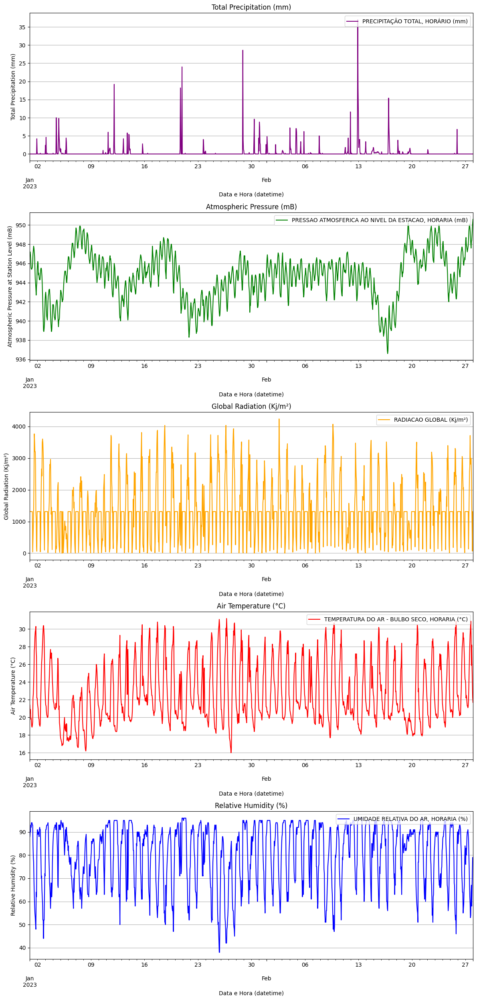

In [571]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
df_intervalo.plot(y='PRECIPITAÇÃO TOTAL, HORÁRIO (mm)', ax=axes[0], color='purple', legend=True, title='Total Precipitation (mm)')
df_intervalo.plot(y='PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)', ax=axes[1], color='green', legend=True, title='Atmospheric Pressure (mB)')
df_intervalo.plot(y='RADIACAO GLOBAL (Kj/m²)', ax=axes[2], color='orange', legend=True, title='Global Radiation (Kj/m²)')
df_intervalo.plot(y='TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)', ax=axes[3], color='red', legend=True, title='Air Temperature (°C)')
df_intervalo.plot(y='UMIDADE RELATIVA DO AR, HORARIA (%)', ax=axes[4], color='blue', legend=True, title='Relative Humidity (%)')

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel('Total Precipitation (mm)')
axes[1].set_ylabel('Atmospheric Pressure at Station Level (mB)')
axes[2].set_ylabel('Global Radiation (Kj/m²)')
axes[3].set_ylabel('Air Temperature (°C)')
axes[4].set_ylabel('Relative Humidity (%)')
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

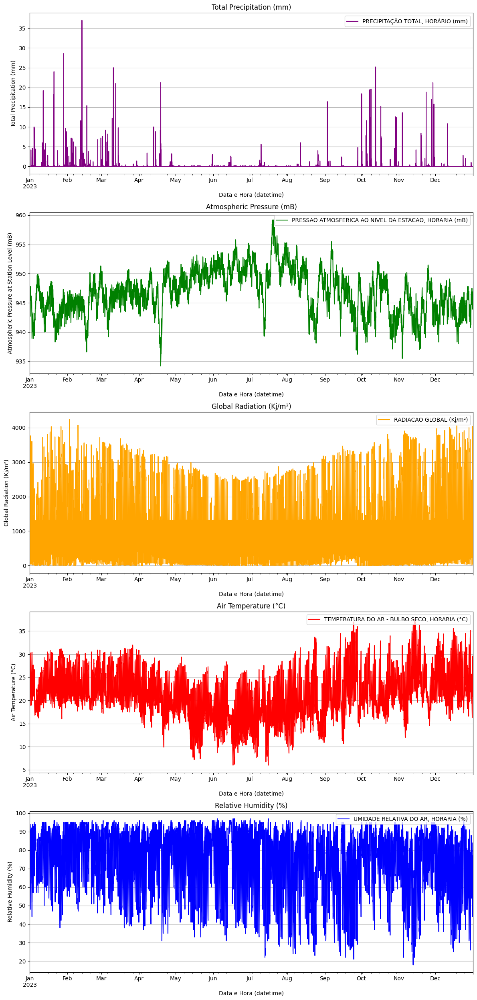

In [572]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
df.plot(y='PRECIPITAÇÃO TOTAL, HORÁRIO (mm)', ax=axes[0], color='purple', legend=True, title='Total Precipitation (mm)')
df.plot(y='PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)', ax=axes[1], color='green', legend=True, title='Atmospheric Pressure (mB)')
df.plot(y='RADIACAO GLOBAL (Kj/m²)', ax=axes[2], color='orange', legend=True, title='Global Radiation (Kj/m²)')
df.plot(y='TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)', ax=axes[3], color='red', legend=True, title='Air Temperature (°C)')
df.plot(y='UMIDADE RELATIVA DO AR, HORARIA (%)', ax=axes[4], color='blue', legend=True, title='Relative Humidity (%)')

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel('Total Precipitation (mm)')
axes[1].set_ylabel('Atmospheric Pressure at Station Level (mB)')
axes[2].set_ylabel('Global Radiation (Kj/m²)')
axes[3].set_ylabel('Air Temperature (°C)')
axes[4].set_ylabel('Relative Humidity (%)')
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature

In [573]:
# ----------------------------------------------------------------------
# Creating the Target feature 'PRECIPITAÇÃO TOTAL, HORÁRIO (mm) (t+1)'
# ----------------------------------------------------------------------

df['PRECIPITAÇÃO TOTAL, HORÁRIO (mm) (t+1)'] = df['PRECIPITAÇÃO TOTAL, HORÁRIO (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'PRECIPITAÇÃO TOTAL, HORÁRIO (mm) (t+1)'
removed_target_column = df.pop(target_column)
df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
df.dropna(subset=['PRECIPITAÇÃO TOTAL, HORÁRIO (mm) (t+1)'], inplace=True)

df.tail()

,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm) (t+1)","PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)"
Data e Hora (datetime),,,,,,,,,,,,,,,,,,
2023-12-31 18:00:00,0.0,0.0,944.3,944.8,944.2,3318.6,29.3,16.9,30.6,28.1,17.2,15.3,47,41,47,121,1.3,0.3
2023-12-31 19:00:00,0.0,0.0,943.9,944.3,943.9,2869.1,27.5,17.3,29.4,27.4,18.1,15.8,55,45,54,138,10.0,5.8
2023-12-31 20:00:00,0.0,0.0,944.1,944.1,943.9,1812.9,26.3,17.0,27.5,26.2,17.8,16.6,57,53,57,142,8.8,4.5
2023-12-31 21:00:00,0.0,0.0,944.4,944.4,944.1,1079.6,24.6,16.8,26.6,24.6,17.3,16.6,62,56,62,133,9.1,5.7
2023-12-31 22:00:00,0.0,0.0,944.9,945.0,944.4,234.9,22.1,16.8,24.6,22.1,17.0,16.5,72,62,72,163,10.0,4.1


## Saving data as `.csv`

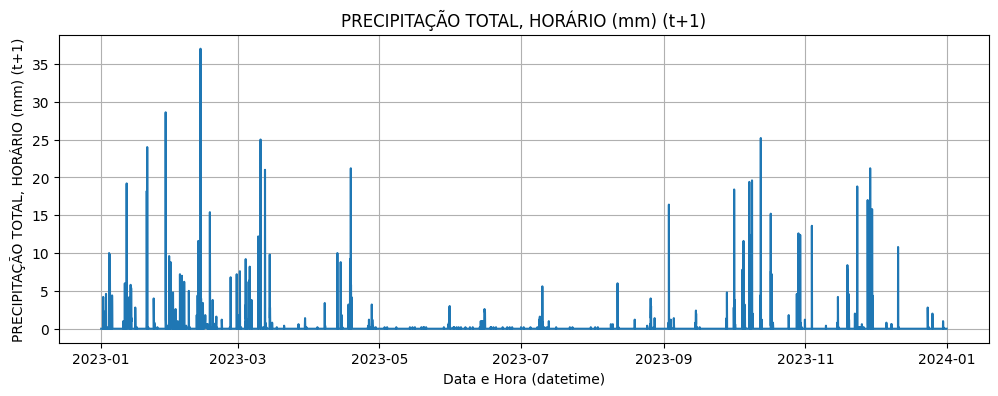

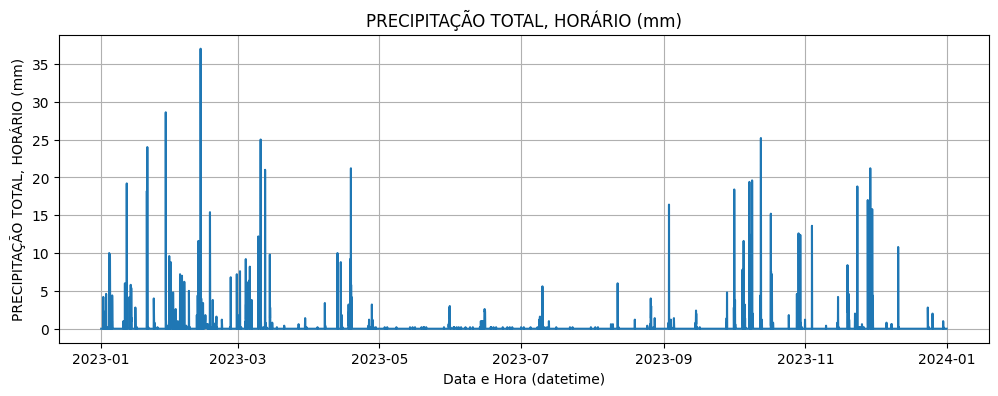

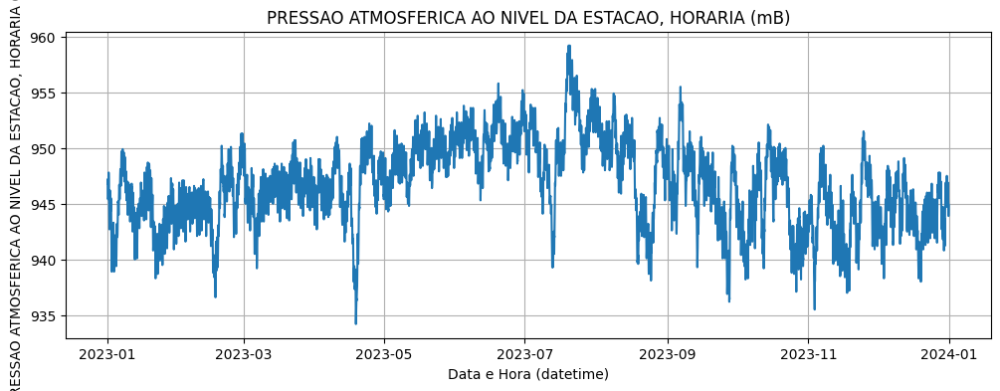

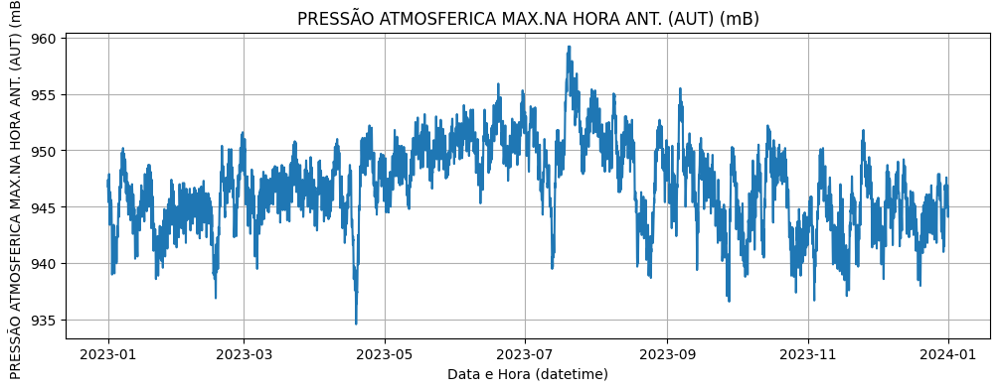

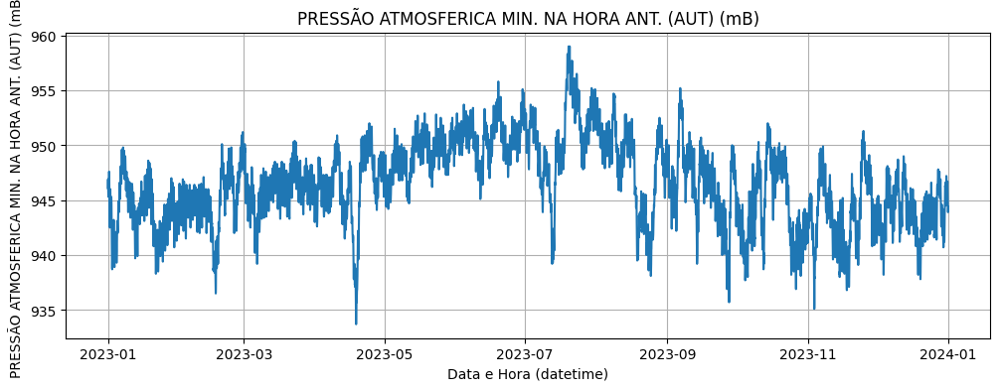

...

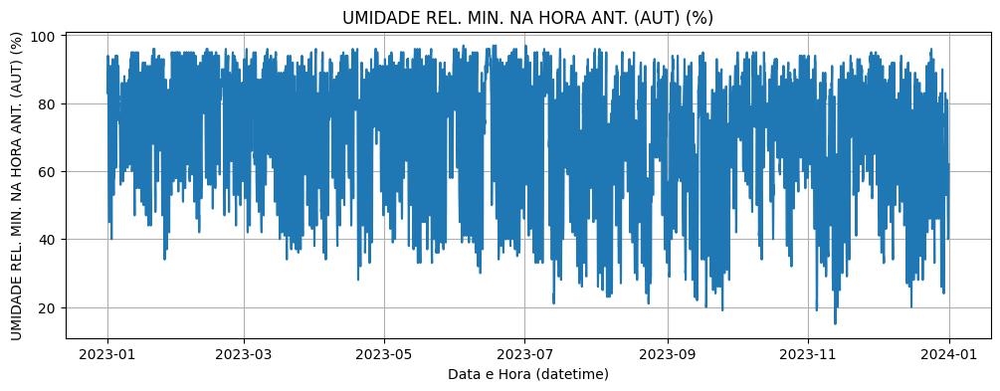

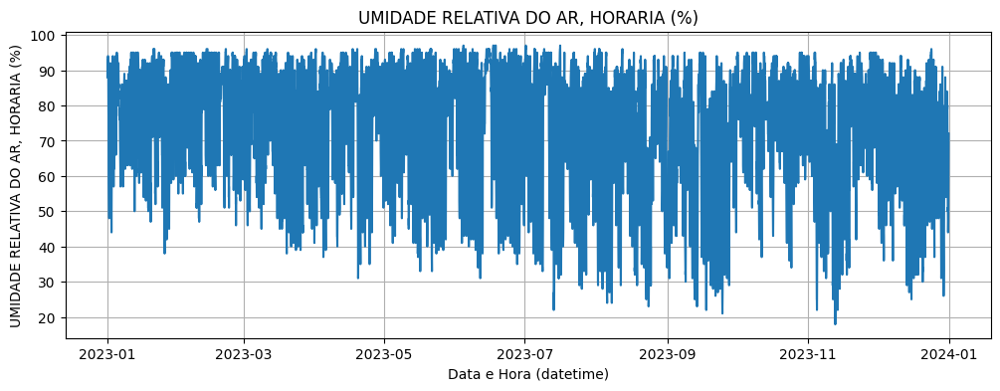

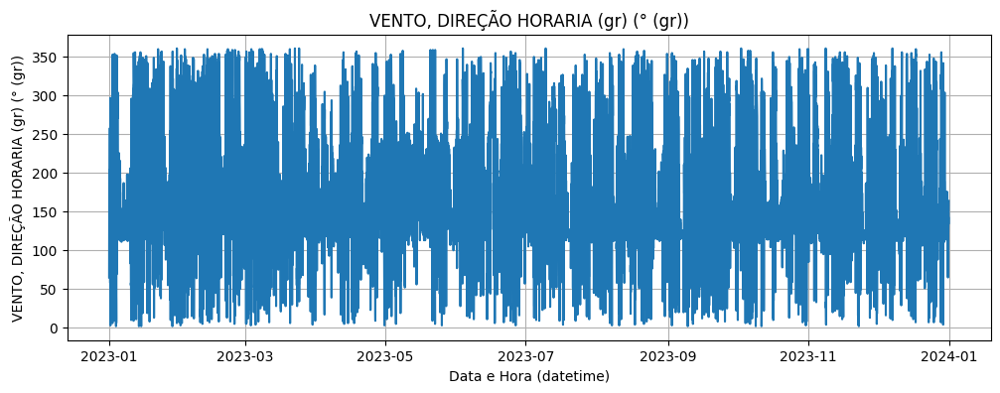

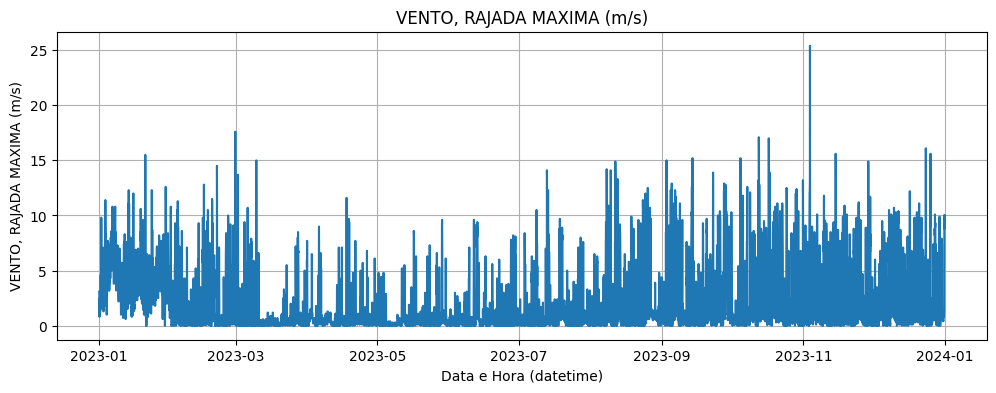

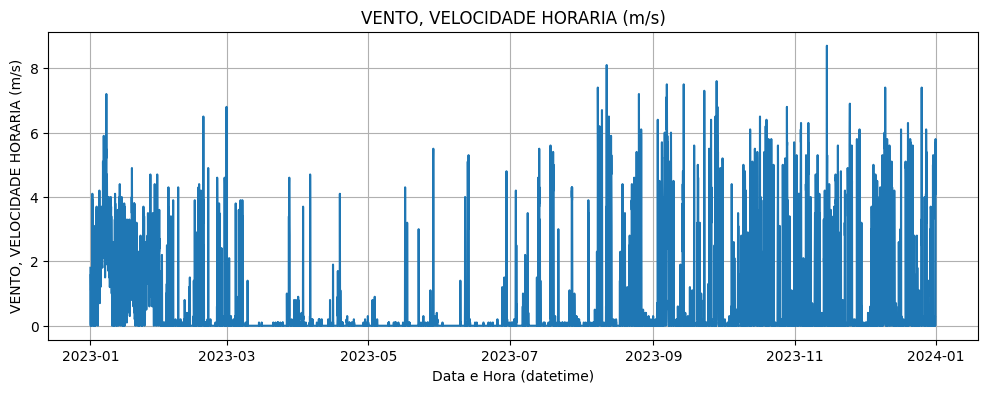

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8759 entries, 2023-01-01 00:00:00 to 2023-12-31 22:00:00
Data columns (total 18 columns):
 #   Column                                                 Non-Null Count  Dtype  
---  ------                                                 --------------  -----  
 0   PRECIPITAÇÃO TOTAL, HORÁRIO (mm) (t+1)                 8759 non-null   float64
 1   PRECIPITAÇÃO TOTAL, HORÁRIO (mm)                       8759 non-null   float64
 2   PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)  8759 non-null   float64
 3   PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)        8759 non-null   float64
 4   PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)       8759 non-null   float64
 5   RADIACAO GLOBAL (Kj/m²)                                8759 non-null   float64
 6   TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)           8759 non-null   float64
 7   TEMPERATURA DO PONTO DE ORVALHO (°C)                   8759 non-null   float64
 8   TEMPERATURA 

In [574]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(df.index, df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

df.info()

In [575]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2023'
output_dir = 'Datasets tratados/2023'

os.makedirs(output_dir, exist_ok=True)

df.to_csv(os.path.join(output_dir, 'Processed_Data_2023-A713_Sorocaba_Ipero.csv'),
          index=True,          # Include Index in the CSV file
          date_format='%Y-%m-%d %H:%M:%S'  # Format for the datetime index
          )


# 1. Client-1 Dataset (Cerquilho-ETEC)⭐

## Data collection and pre-processing

In [576]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0350 - Cerquilho-ETEC/2023/INMET_SE_SP_V0350_CERQUILHO-ETEC-Dataset_01-01-2023_A_31-12-2023.csv'
file_path = 'Datasets Brutos/Estacao_V0350 - Cerquilho-ETEC/2023/INMET_SE_SP_V0350_CERQUILHO-ETEC-Dataset_01-01-2023_A_31-12-2023.csv'

# Upload CSV file into DataFrame
client1_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [577]:
print("Dataframe format:")
print(f" ↪Linhas: {client1_df.shape[0]} \n ↪Colunas: {client1_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client1_df.head()

Dataframe format:
 ↪Linhas: 8760 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2023,0,23.8,NaN,NaN,79.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,01/01/2023,100,23.5,NaN,NaN,79.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,01/01/2023,200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,01/01/2023,300,22.8,NaN,NaN,82.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,01/01/2023,400,22.4,NaN,NaN,84.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [578]:
# Data general info
print("General Dataset Information:")
print(client1_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8760 non-null   object 
 1   Hora (UTC)            8760 non-null   int64  
 2   Temp. Ins. (C)        8341 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8341 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      8341 non-null   float

In [579]:
print("Descriptive statistics:")
client1_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8760.000000,8341.000000,0.0,0.0,8341.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8341.000000,0.0,0.0,0.0,8341.000000
mean,1150.000000,22.907541,NaN,NaN,74.325165,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.039875,NaN,NaN,NaN,0.089869
std,692.258169,5.644926,NaN,NaN,17.316582,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.164279,NaN,NaN,NaN,0.838229
min,0.000000,7.800000,NaN,NaN,25.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,19.100000,NaN,NaN,61.300000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
50%,1150.000000,22.400000,NaN,NaN,78.700000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
75%,1725.000000,26.900000,NaN,NaN,89.200000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
max,2300.000000,39.500000,NaN,NaN,98.700000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.300000,NaN,NaN,NaN,34.600000


In [580]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client1_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client1_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client1_df['Hora (UTC)'] = client1_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client1_df['Hora Datetime'] = pd.to_datetime(client1_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client1_df['Data e Hora (datetime)'] = client1_df['ï»¿"Data"'] + ' ' + client1_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client1_df['Data e Hora (datetime)'] = pd.to_datetime(client1_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client1_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_10224\2562077892.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client1_df.loc[0, 'Hora (UTC)'] = modified_value


0   2023-01-01 00:00:00
1   2023-01-01 01:00:00
2   2023-01-01 02:00:00
3   2023-01-01 03:00:00
4   2023-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [581]:
client1_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2023,0000,23.8,NaN,NaN,79.3,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,00:00:00,2023-01-01 00:00:00
1,01/01/2023,0100,23.5,NaN,NaN,79.1,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,01:00:00,2023-01-01 01:00:00
2,01/01/2023,0200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,02:00:00,2023-01-01 02:00:00
3,01/01/2023,0300,22.8,NaN,NaN,82.7,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,03:00:00,2023-01-01 03:00:00
4,01/01/2023,0400,22.4,NaN,NaN,84.1,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,04:00:00,2023-01-01 04:00:00


In [582]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client1_df = client1_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client1_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client1_df.pop(column)          # remove the column
client1_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client1_df.shape)

client1_df.head()

DataFrame format:
(8760, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2023-01-01 00:00:00,23.8,NaN,NaN,79.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,2023-01-01 01:00:00,23.5,NaN,NaN,79.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,2023-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2023-01-01 03:00:00,22.8,NaN,NaN,82.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,2023-01-01 04:00:00,22.4,NaN,NaN,84.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [583]:
# Indexing of the 'Datetime' Date and Time
client1_df.set_index('Data e Hora (datetime)', inplace=True)

client1_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,23.8,NaN,NaN,79.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 01:00:00,23.5,NaN,NaN,79.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-01 03:00:00,22.8,NaN,NaN,82.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 04:00:00,22.4,NaN,NaN,84.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [584]:
# Check missing values
print("Amount of missing values per column:")
print(client1_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client1_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           419
Temp. Max. (C)          8760
Temp. Min. (C)          8760
Umi. Ins. (%)            419
Umi. Max. (%)           8760
Umi. Min. (%)           8760
Pto Orvalho Ins. (C)    8760
Pto Orvalho Max. (C)    8760
Pto Orvalho Min. (C)    8760
Pressao Ins. (hPa)      8760
Pressao Max. (hPa)      8760
Pressao Min. (hPa)      8760
Vel. Vento (m/s)         419
Dir. Vento (m/s)        8760
Raj. Vento (m/s)        8760
Radiacao (KJ/mÂ²)       8760
Chuva (mm)               419
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            4.783105
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)             4.783105
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [585]:
# Dropping columns with 100% missing values
client1_df = client1_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client1_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      4.783105
Umi. Ins. (%)       4.783105
Vel. Vento (m/s)    4.783105
Chuva (mm)          4.783105
dtype: float64


In [586]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [587]:
client1_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,23.8,79.3,0.0,0.0
2023-01-01 01:00:00,23.5,79.1,0.0,0.0
2023-01-01 02:00:00,NaN,NaN,NaN,NaN
2023-01-01 03:00:00,22.8,82.7,0.0,0.0
2023-01-01 04:00:00,22.4,84.1,0.0,0.0


In [588]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [589]:
# Filters the data by interval
client1_df_intervalo = client1_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

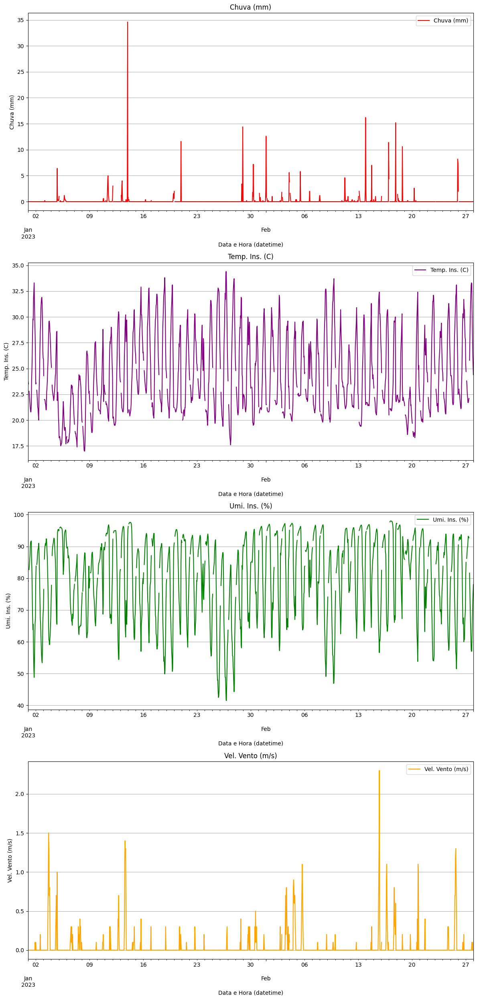

In [590]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client1_df_intervalo.plot(y=client1_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client1_df_intervalo.columns[3])
client1_df_intervalo.plot(y=client1_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client1_df_intervalo.columns[0])
client1_df_intervalo.plot(y=client1_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client1_df_intervalo.columns[1])
client1_df_intervalo.plot(y=client1_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client1_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client1_df_intervalo.columns[3])
axes[1].set_ylabel(client1_df_intervalo.columns[0])
axes[2].set_ylabel(client1_df_intervalo.columns[1])
axes[3].set_ylabel(client1_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

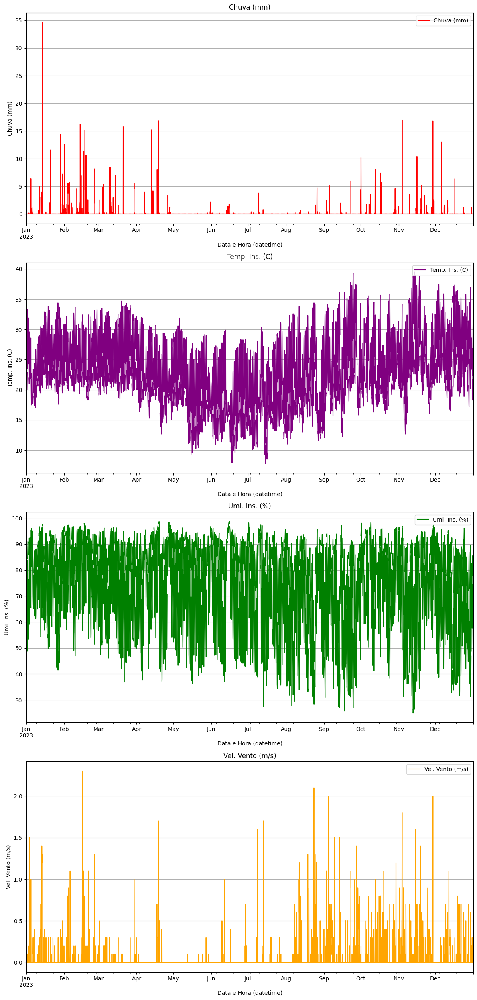

In [591]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client1_df.plot(y=client1_df.columns[3], ax=axes[0], color='red', legend=True, title=client1_df.columns[3])
client1_df.plot(y=client1_df.columns[0], ax=axes[1], color='purple', legend=True, title=client1_df.columns[0])
client1_df.plot(y=client1_df.columns[1], ax=axes[2], color='green', legend=True, title=client1_df.columns[1])
client1_df.plot(y=client1_df.columns[2], ax=axes[3], color='orange', legend=True, title=client1_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client1_df.columns[3])
axes[1].set_ylabel(client1_df.columns[0])
axes[2].set_ylabel(client1_df.columns[1])
axes[3].set_ylabel(client1_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [592]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client1_df.columns:
    if client1_df[column].isnull().any():
        client1_df[column] = client1_df[column].interpolate(method='linear')  # Interpolação linear

In [593]:
# Check missing values
print("Amount of missing values per column:")
print(client1_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client1_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [594]:
# Filters the data by interval
client1_df_intervalo = client1_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

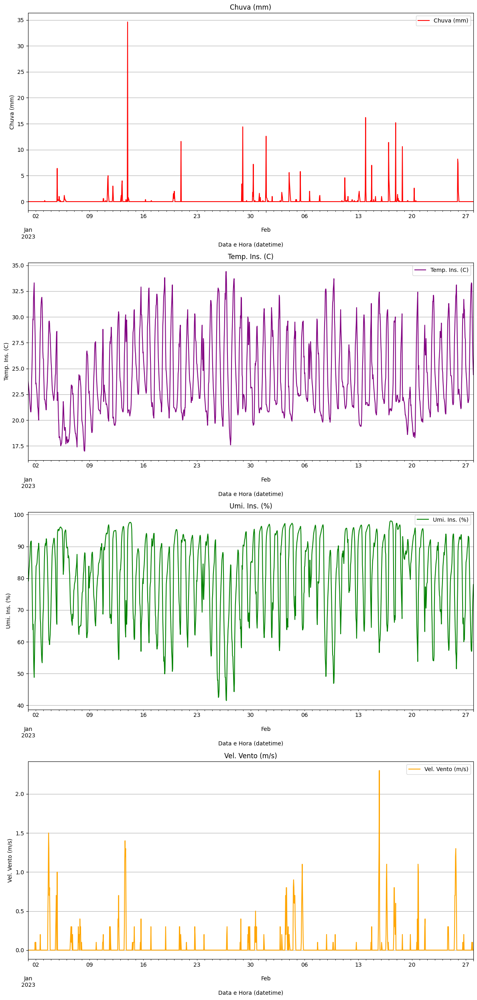

In [595]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client1_df_intervalo.plot(y=client1_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client1_df_intervalo.columns[3])
client1_df_intervalo.plot(y=client1_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client1_df_intervalo.columns[0])
client1_df_intervalo.plot(y=client1_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client1_df_intervalo.columns[1])
client1_df_intervalo.plot(y=client1_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client1_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client1_df_intervalo.columns[3])
axes[1].set_ylabel(client1_df_intervalo.columns[0])
axes[2].set_ylabel(client1_df_intervalo.columns[1])
axes[3].set_ylabel(client1_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

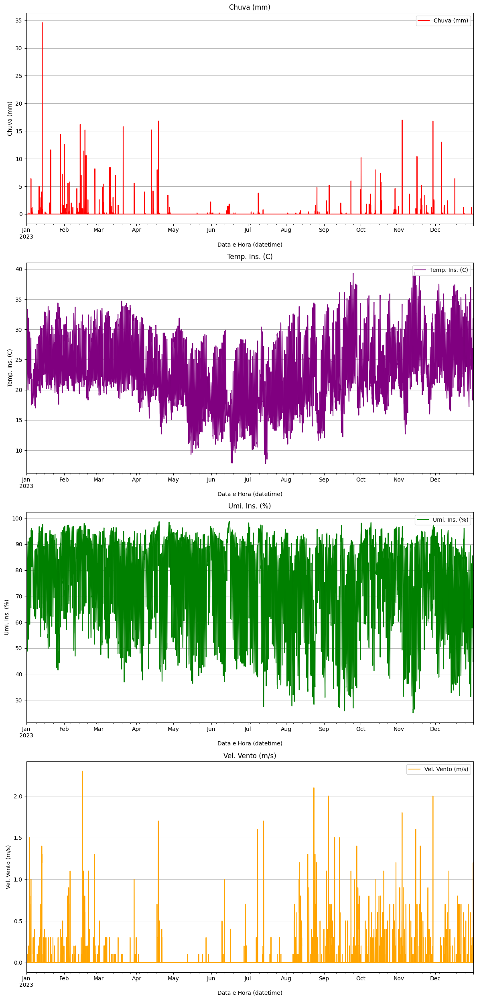

In [596]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client1_df.plot(y=client1_df.columns[3], ax=axes[0], color='red', legend=True, title=client1_df.columns[3])
client1_df.plot(y=client1_df.columns[0], ax=axes[1], color='purple', legend=True, title=client1_df.columns[0])
client1_df.plot(y=client1_df.columns[1], ax=axes[2], color='green', legend=True, title=client1_df.columns[1])
client1_df.plot(y=client1_df.columns[2], ax=axes[3], color='orange', legend=True, title=client1_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client1_df.columns[3])
axes[1].set_ylabel(client1_df.columns[0])
axes[2].set_ylabel(client1_df.columns[1])
axes[3].set_ylabel(client1_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [597]:
client1_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,23.80,79.3,0.0,0.0
2023-01-01 01:00:00,23.50,79.1,0.0,0.0
2023-01-01 02:00:00,23.15,80.9,0.0,0.0
2023-01-01 03:00:00,22.80,82.7,0.0,0.0
2023-01-01 04:00:00,22.40,84.1,0.0,0.0


In [598]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client1_df.pop(column)          # remove the column
client1_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client1_df.shape)

client1_df.head()

DataFrame format:
(8760, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,0.0,23.80,79.3,0.0
2023-01-01 01:00:00,0.0,23.50,79.1,0.0
2023-01-01 02:00:00,0.0,23.15,80.9,0.0
2023-01-01 03:00:00,0.0,22.80,82.7,0.0
2023-01-01 04:00:00,0.0,22.40,84.1,0.0


In [599]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client1_df['Chuva (mm) (t+1)'] = client1_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client1_df.pop(target_column)
client1_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client1_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client1_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2023-12-31 18:00:00,0.0,0.0,31.8,44.9,0.0
2023-12-31 19:00:00,0.0,0.0,31.6,44.7,0.3
2023-12-31 20:00:00,0.0,0.0,30.4,52.0,1.2
2023-12-31 21:00:00,0.0,0.0,28.7,55.2,0.7
2023-12-31 22:00:00,0.0,0.0,26.7,60.3,0.6


## Saving data as `.csv`

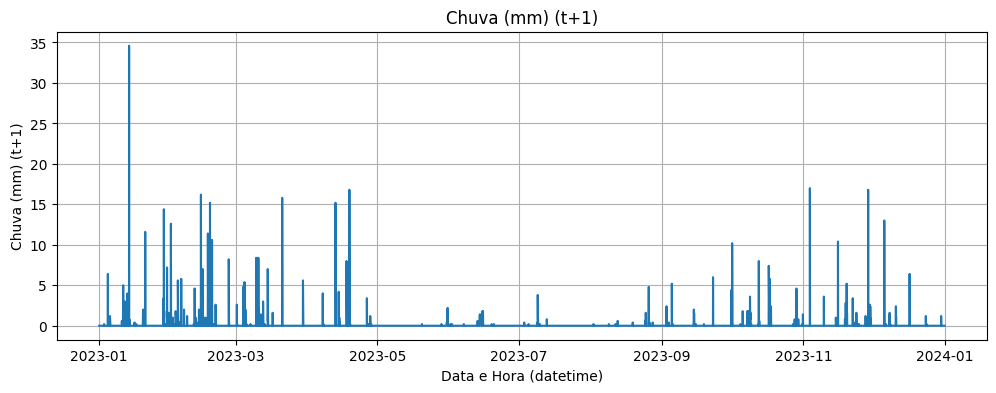

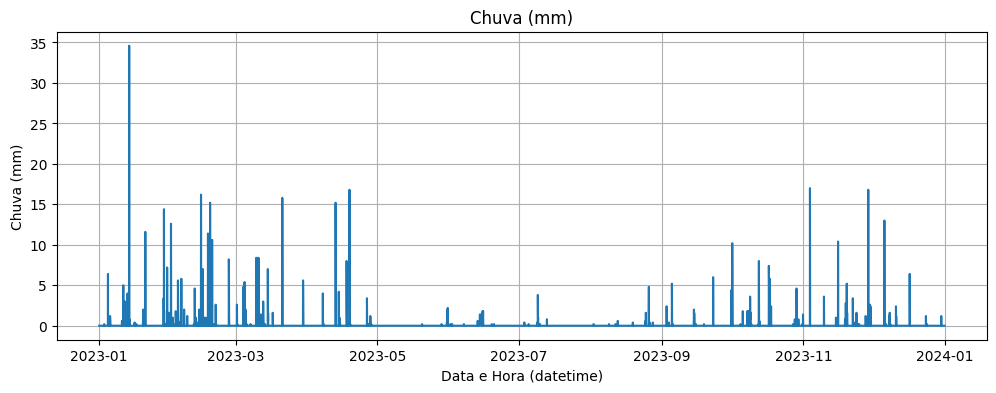

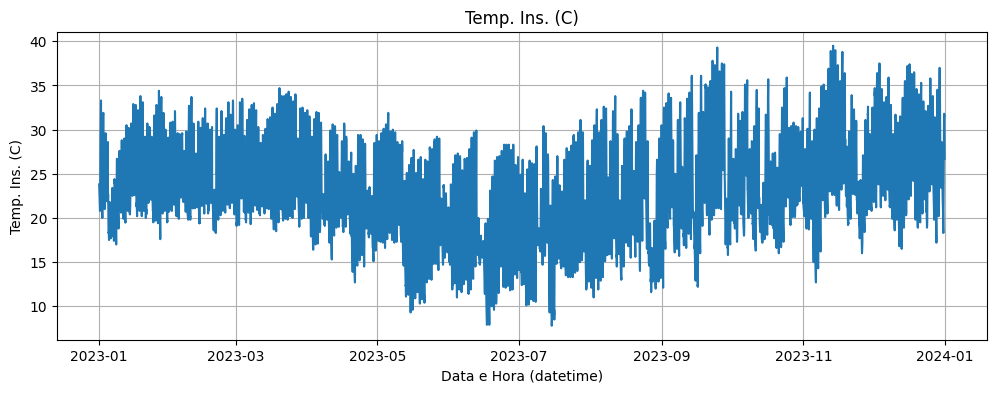

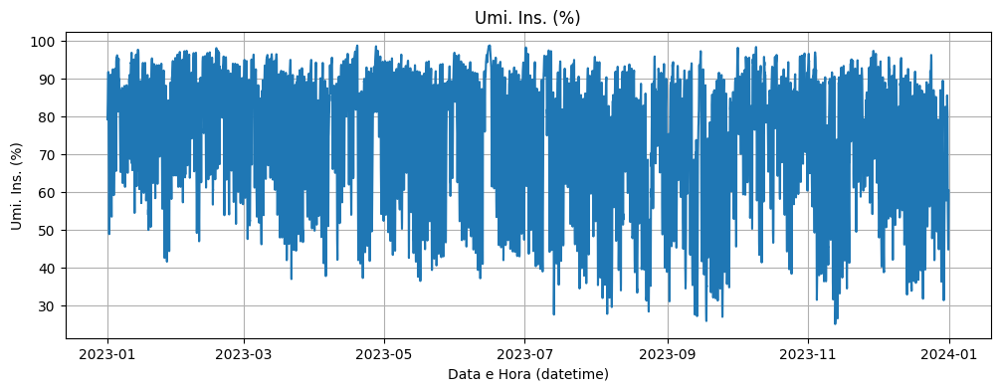

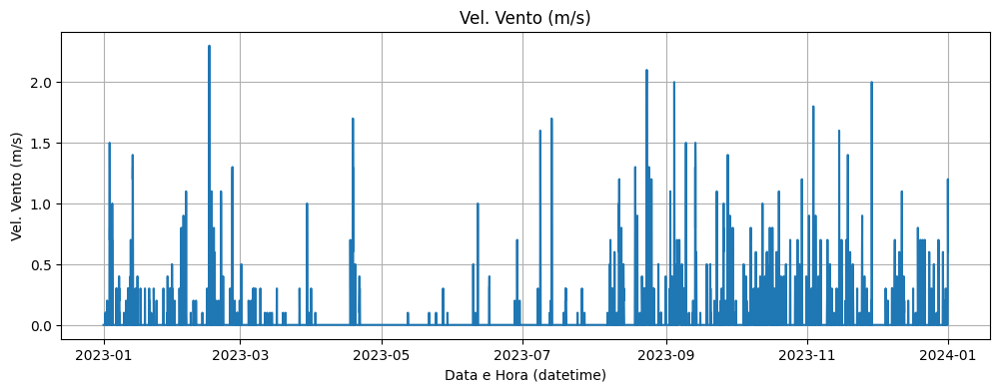

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8759 entries, 2023-01-01 00:00:00 to 2023-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8759 non-null   float64
 1   Chuva (mm)        8759 non-null   float64
 2   Temp. Ins. (C)    8759 non-null   float64
 3   Umi. Ins. (%)     8759 non-null   float64
 4   Vel. Vento (m/s)  8759 non-null   float64
dtypes: float64(5)
memory usage: 410.6 KB


In [600]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client1_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client1_df.index, client1_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client1_df.info()

In [601]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2023'
output_dir = 'Datasets tratados/2023'

os.makedirs(output_dir, exist_ok=True)

client1_df.to_csv(os.path.join(output_dir, 'Processed_Data_2023-Client-1_V0350_Cerquilho-ETEC.csv'), 
                  index=True,          # Include Index in the CSV file
                  date_format='%Y-%m-%d %H:%M:%S'  # Format for the datetime index
                  )

# 2. Client-2 Dataset (Ibiuna)⭐

## Data collection and pre-processing

In [602]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0377 - Ibiuna/2023/INMET_SE_SP_V0377_IBIUNA-Dataset_01-01-2023_A_31-12-2023.csv'
file_path = 'Datasets Brutos/Estacao_V0377 - Ibiuna/2023/INMET_SE_SP_V0377_IBIUNA-Dataset_01-01-2023_A_31-12-2023.csv'

# Upload CSV file into DataFrame
client2_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [603]:
print("Dataframe format:")
print(f" ↪Linhas: {client2_df.shape[0]} \n ↪Colunas: {client2_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client2_df.head()

Dataframe format:
 ↪Linhas: 8760 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2023,0,20.0,NaN,NaN,89.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,01/01/2023,100,19.4,NaN,NaN,90.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,01/01/2023,200,18.9,NaN,NaN,91.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,01/01/2023,300,18.6,NaN,NaN,92.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,01/01/2023,400,18.5,NaN,NaN,93.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [604]:
# Data general info
print("General Dataset Information:")
print(client2_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8760 non-null   object 
 1   Hora (UTC)            8760 non-null   int64  
 2   Temp. Ins. (C)        8386 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8386 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      8385 non-null   float

In [605]:
print("Descriptive statistics:")
client2_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8760.000000,8386.000000,0.0,0.0,8386.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8385.000000,0.0,0.0,0.0,8386.000000
mean,1150.000000,19.292213,NaN,NaN,79.073396,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000549,NaN,NaN,NaN,0.171536
std,692.258169,5.133613,NaN,NaN,17.067591,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.039373,NaN,NaN,NaN,1.249093
min,0.000000,4.900000,NaN,NaN,20.900000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,15.700000,NaN,NaN,68.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
50%,1150.000000,19.100000,NaN,NaN,86.900000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
75%,1725.000000,22.400000,NaN,NaN,92.300000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
max,2300.000000,35.900000,NaN,NaN,98.600000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.400000,NaN,NaN,NaN,56.300000


In [606]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client2_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client2_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client2_df['Hora (UTC)'] = client2_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client2_df['Hora Datetime'] = pd.to_datetime(client2_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client2_df['Data e Hora (datetime)'] = client2_df['ï»¿"Data"'] + ' ' + client2_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client2_df['Data e Hora (datetime)'] = pd.to_datetime(client2_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client2_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_10224\2898631049.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client2_df.loc[0, 'Hora (UTC)'] = modified_value


0   2023-01-01 00:00:00
1   2023-01-01 01:00:00
2   2023-01-01 02:00:00
3   2023-01-01 03:00:00
4   2023-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [607]:
client2_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2023,0000,20.0,NaN,NaN,89.1,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,00:00:00,2023-01-01 00:00:00
1,01/01/2023,0100,19.4,NaN,NaN,90.3,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,01:00:00,2023-01-01 01:00:00
2,01/01/2023,0200,18.9,NaN,NaN,91.5,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,02:00:00,2023-01-01 02:00:00
3,01/01/2023,0300,18.6,NaN,NaN,92.3,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,03:00:00,2023-01-01 03:00:00
4,01/01/2023,0400,18.5,NaN,NaN,93.2,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,04:00:00,2023-01-01 04:00:00


In [608]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client2_df = client2_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client2_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client2_df.pop(column)          # remove the column
client2_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client2_df.shape)

client2_df.head()

DataFrame format:
(8760, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2023-01-01 00:00:00,20.0,NaN,NaN,89.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,2023-01-01 01:00:00,19.4,NaN,NaN,90.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,2023-01-01 02:00:00,18.9,NaN,NaN,91.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,2023-01-01 03:00:00,18.6,NaN,NaN,92.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,2023-01-01 04:00:00,18.5,NaN,NaN,93.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [609]:
# Indexing of the 'Datetime' Date and Time
client2_df.set_index('Data e Hora (datetime)', inplace=True)

client2_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,20.0,NaN,NaN,89.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 01:00:00,19.4,NaN,NaN,90.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 02:00:00,18.9,NaN,NaN,91.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 03:00:00,18.6,NaN,NaN,92.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 04:00:00,18.5,NaN,NaN,93.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [610]:
# Check missing values
print("Amount of missing values per column:")
print(client2_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client2_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           374
Temp. Max. (C)          8760
Temp. Min. (C)          8760
Umi. Ins. (%)            374
Umi. Max. (%)           8760
Umi. Min. (%)           8760
Pto Orvalho Ins. (C)    8760
Pto Orvalho Max. (C)    8760
Pto Orvalho Min. (C)    8760
Pressao Ins. (hPa)      8760
Pressao Max. (hPa)      8760
Pressao Min. (hPa)      8760
Vel. Vento (m/s)         375
Dir. Vento (m/s)        8760
Raj. Vento (m/s)        8760
Radiacao (KJ/mÂ²)       8760
Chuva (mm)               374
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            4.269406
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)             4.269406
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [611]:
# Dropping columns with 100% missing values
client2_df = client2_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client2_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      4.269406
Umi. Ins. (%)       4.269406
Vel. Vento (m/s)    4.280822
Chuva (mm)          4.269406
dtype: float64


In [612]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [613]:
client2_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,20.0,89.1,0.0,0.0
2023-01-01 01:00:00,19.4,90.3,0.0,0.0
2023-01-01 02:00:00,18.9,91.5,0.0,0.0
2023-01-01 03:00:00,18.6,92.3,0.0,0.0
2023-01-01 04:00:00,18.5,93.2,0.0,0.0


In [614]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [615]:
# Filters the data by interval
client2_df_intervalo = client2_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

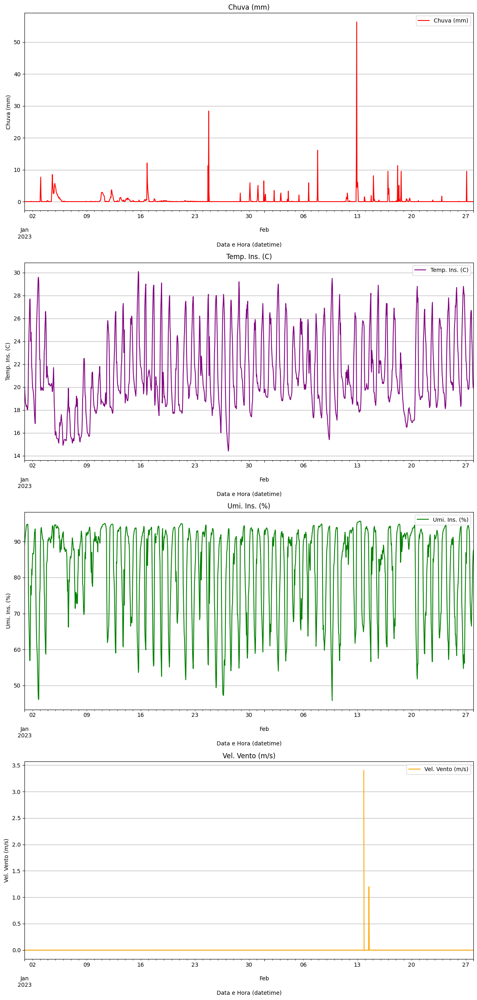

In [616]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df_intervalo.plot(y=client2_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client2_df_intervalo.columns[3])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df_intervalo.columns[0])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client2_df_intervalo.columns[1])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df_intervalo.columns[3])
axes[1].set_ylabel(client2_df_intervalo.columns[0])
axes[2].set_ylabel(client2_df_intervalo.columns[1])
axes[3].set_ylabel(client2_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

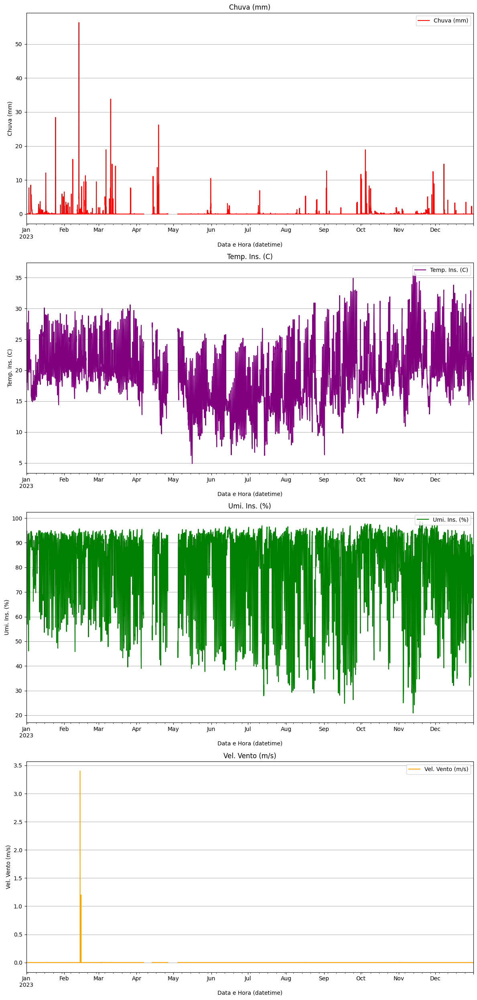

In [617]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df.plot(y=client2_df.columns[3], ax=axes[0], color='red', legend=True, title=client2_df.columns[3])
client2_df.plot(y=client2_df.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df.columns[0])
client2_df.plot(y=client2_df.columns[1], ax=axes[2], color='green', legend=True, title=client2_df.columns[1])
client2_df.plot(y=client2_df.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df.columns[3])
axes[1].set_ylabel(client2_df.columns[0])
axes[2].set_ylabel(client2_df.columns[1])
axes[3].set_ylabel(client2_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [618]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client2_df.columns:
    if client2_df[column].isnull().any():
        client2_df[column] = client2_df[column].interpolate(method='linear')  # Interpolação linear

In [619]:
# Check missing values
print("Amount of missing values per column:")
print(client2_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client2_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [620]:
# Filters the data by interval
client2_df_intervalo = client2_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

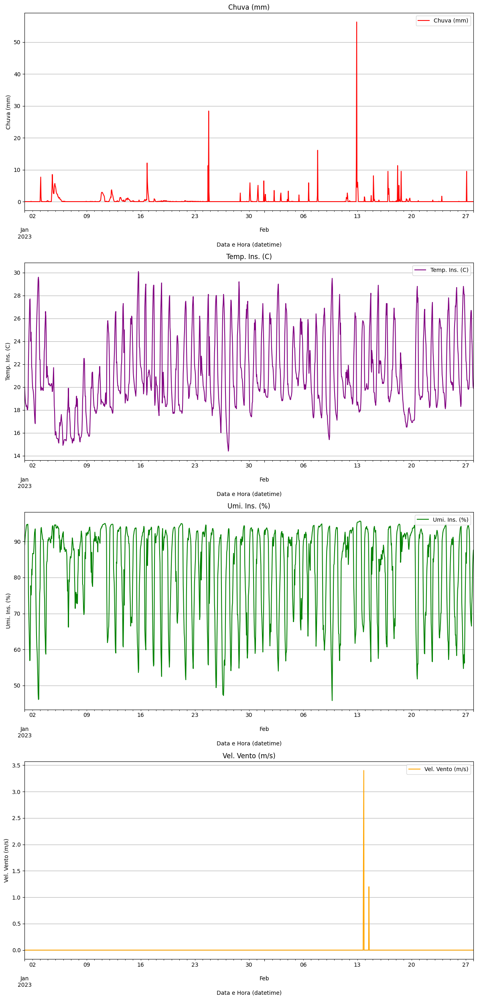

In [621]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df_intervalo.plot(y=client2_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client2_df_intervalo.columns[3])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df_intervalo.columns[0])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client2_df_intervalo.columns[1])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df_intervalo.columns[3])
axes[1].set_ylabel(client2_df_intervalo.columns[0])
axes[2].set_ylabel(client2_df_intervalo.columns[1])
axes[3].set_ylabel(client2_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

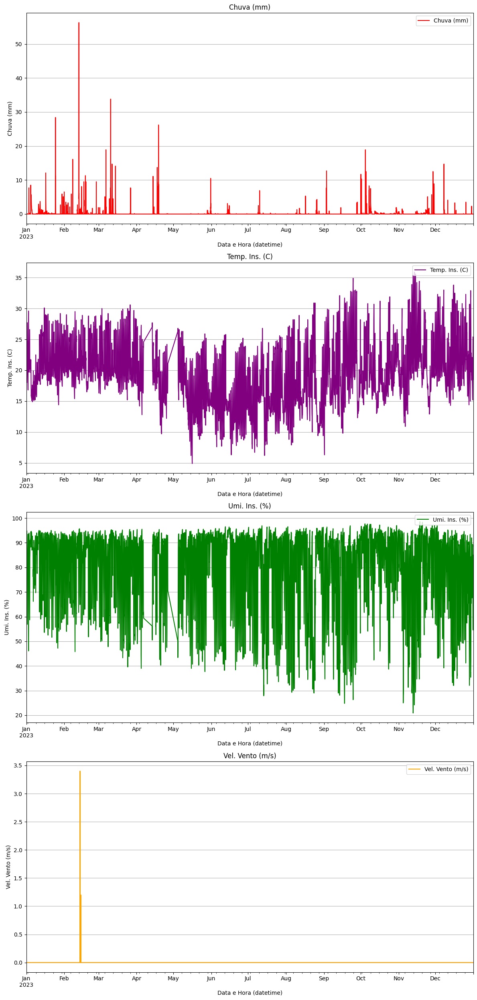

In [622]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df.plot(y=client2_df.columns[3], ax=axes[0], color='red', legend=True, title=client2_df.columns[3])
client2_df.plot(y=client2_df.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df.columns[0])
client2_df.plot(y=client2_df.columns[1], ax=axes[2], color='green', legend=True, title=client2_df.columns[1])
client2_df.plot(y=client2_df.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df.columns[3])
axes[1].set_ylabel(client2_df.columns[0])
axes[2].set_ylabel(client2_df.columns[1])
axes[3].set_ylabel(client2_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [623]:
client2_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,20.0,89.1,0.0,0.0
2023-01-01 01:00:00,19.4,90.3,0.0,0.0
2023-01-01 02:00:00,18.9,91.5,0.0,0.0
2023-01-01 03:00:00,18.6,92.3,0.0,0.0
2023-01-01 04:00:00,18.5,93.2,0.0,0.0


In [624]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client2_df.pop(column)          # remove the column
client2_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client2_df.shape)

client2_df.head()

DataFrame format:
(8760, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,0.0,20.0,89.1,0.0
2023-01-01 01:00:00,0.0,19.4,90.3,0.0
2023-01-01 02:00:00,0.0,18.9,91.5,0.0
2023-01-01 03:00:00,0.0,18.6,92.3,0.0
2023-01-01 04:00:00,0.0,18.5,93.2,0.0


In [625]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client2_df['Chuva (mm) (t+1)'] = client2_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client2_df.pop(target_column)
client2_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client2_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client2_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2023-12-31 18:00:00,0.0,0.0,23.6,66.8,0.0
2023-12-31 19:00:00,0.0,0.0,23.2,68.5,0.0
2023-12-31 20:00:00,0.0,0.0,22.7,69.7,0.0
2023-12-31 21:00:00,0.0,0.0,21.3,74.6,0.0
2023-12-31 22:00:00,0.0,0.0,19.5,81.4,0.0


## Saving data as `.csv`

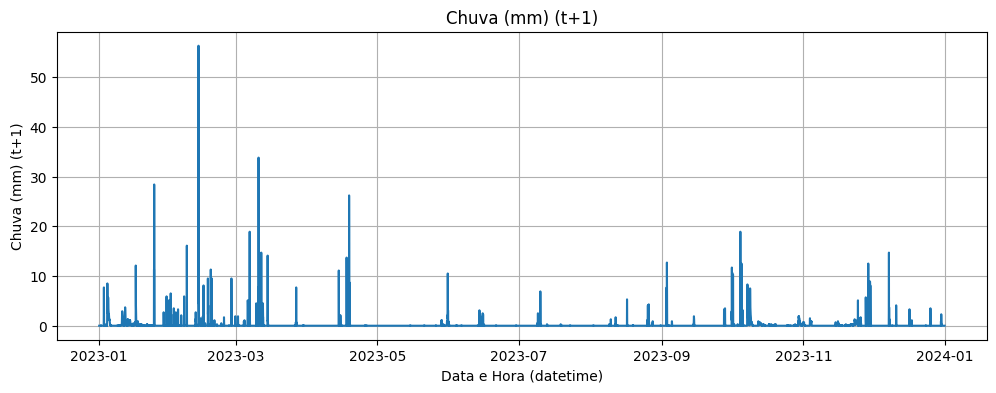

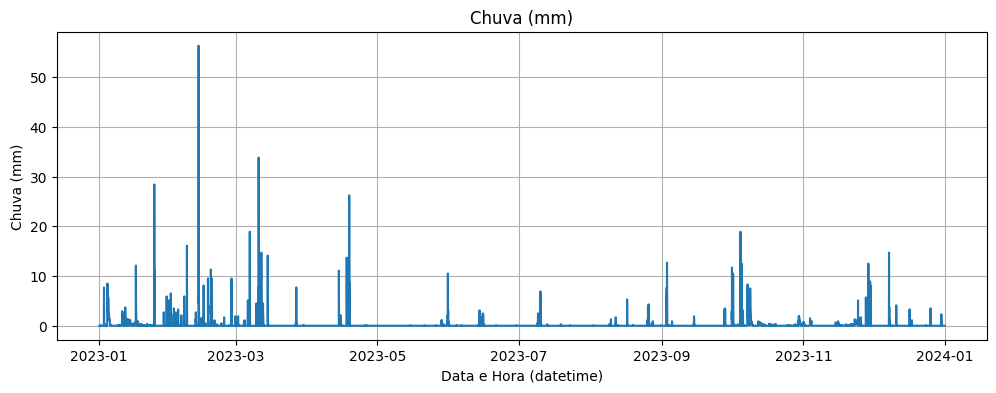

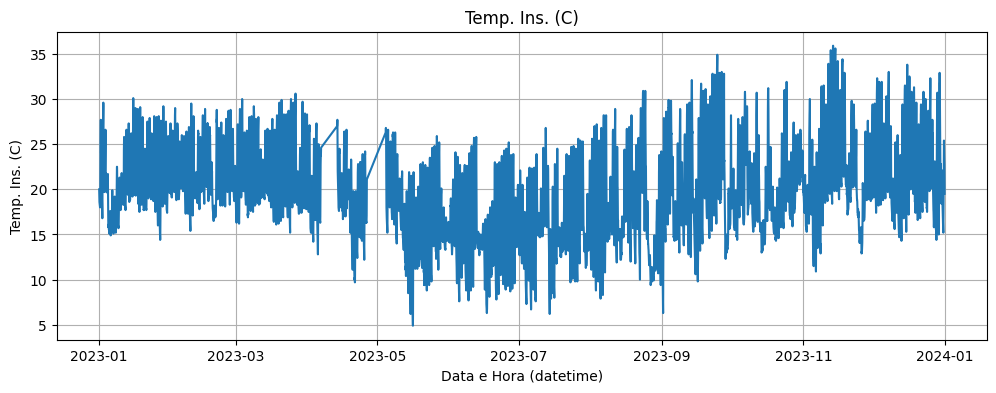

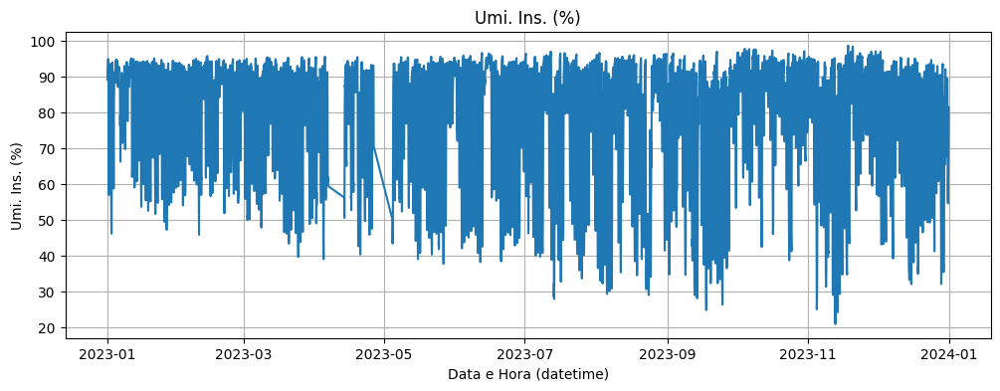

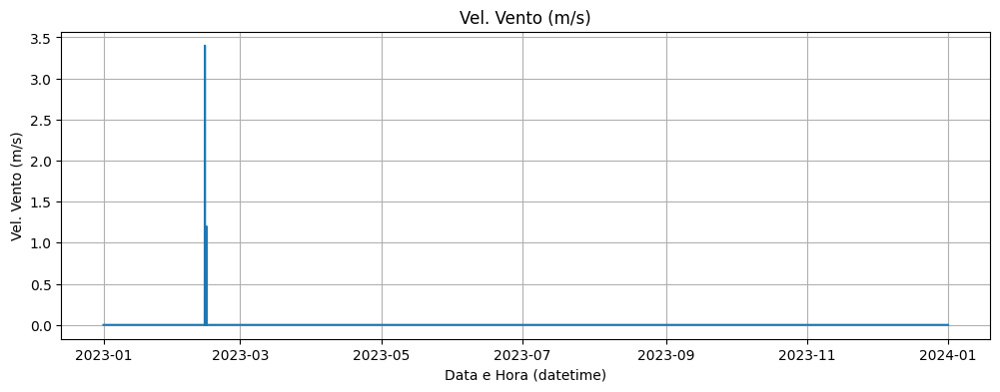

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8759 entries, 2023-01-01 00:00:00 to 2023-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8759 non-null   float64
 1   Chuva (mm)        8759 non-null   float64
 2   Temp. Ins. (C)    8759 non-null   float64
 3   Umi. Ins. (%)     8759 non-null   float64
 4   Vel. Vento (m/s)  8759 non-null   float64
dtypes: float64(5)
memory usage: 410.6 KB


In [626]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client2_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client2_df.index, client2_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client2_df.info()

In [627]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2023'
output_dir = 'Datasets tratados/2023'

os.makedirs(output_dir, exist_ok=True)

client2_df.to_csv(os.path.join(output_dir, 'Processed_Data_2023-Client-2_V0377_Ibiuna.csv'),
                  index=True,                      # Include Index in the CSV file
                  date_format='%Y-%m-%d %H:%M:%S'  # Format for the datetime index
                  )

# 3. Client- Dataset (Itu)⭐

## Data collection and pre-processing

In [628]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0397 - Itu/2023/INMET_SE_SP_V0397_ITU-Dataset_01-01-2023_A_31-12-2023.csv'
file_path = 'Datasets Brutos/Estacao_V0397 - Itu/2023/INMET_SE_SP_V0397_ITU-Dataset_01-01-2023_A_31-12-2023.csv'

# Upload CSV file into DataFrame
client3_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [629]:
print("Dataframe format:")
print(f" ↪Linhas: {client3_df.shape[0]} \n ↪Colunas: {client3_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client3_df.head()

Dataframe format:
 ↪Linhas: 8760 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2023,0,21.5,NaN,NaN,89.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.2,NaN,NaN,NaN,0.0
1,01/01/2023,100,21.1,NaN,NaN,92.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.5,NaN,NaN,NaN,0.0
2,01/01/2023,200,20.5,NaN,NaN,94.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.4,NaN,NaN,NaN,0.0
3,01/01/2023,300,20.2,NaN,NaN,95.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.8,NaN,NaN,NaN,0.0
4,01/01/2023,400,19.8,NaN,NaN,95.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.2,NaN,NaN,NaN,0.0


In [630]:
# Data general info
print("General Dataset Information:")
print(client3_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8760 non-null   object 
 1   Hora (UTC)            8760 non-null   int64  
 2   Temp. Ins. (C)        8728 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8728 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      8728 non-null   float

In [631]:
print("Descriptive statistics:")
client3_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8760.000000,8728.000000,0.0,0.0,8728.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8728.000000,0.0,0.0,0.0,8728.000000
mean,1150.000000,21.728689,NaN,NaN,75.799347,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.799954,NaN,NaN,NaN,0.157413
std,692.258169,4.845698,NaN,NaN,20.036466,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.927833,NaN,NaN,NaN,1.375229
min,0.000000,7.500000,NaN,NaN,18.300000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.200000,NaN,NaN,NaN,0.000000
25%,575.000000,18.400000,NaN,NaN,60.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.200000,NaN,NaN,NaN,0.000000
50%,1150.000000,21.100000,NaN,NaN,80.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.500000,NaN,NaN,NaN,0.000000
75%,1725.000000,25.000000,NaN,NaN,93.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.200000,NaN,NaN,NaN,0.000000
max,2300.000000,37.800000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.200000,NaN,NaN,NaN,40.300000


In [632]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client3_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client3_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client3_df['Hora (UTC)'] = client3_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client3_df['Hora Datetime'] = pd.to_datetime(client3_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client3_df['Data e Hora (datetime)'] = client3_df['ï»¿"Data"'] + ' ' + client3_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client3_df['Data e Hora (datetime)'] = pd.to_datetime(client3_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client3_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_10224\3394291670.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client3_df.loc[0, 'Hora (UTC)'] = modified_value


0   2023-01-01 00:00:00
1   2023-01-01 01:00:00
2   2023-01-01 02:00:00
3   2023-01-01 03:00:00
4   2023-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [633]:
client3_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2023,0000,21.5,NaN,NaN,89.5,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,4.2,NaN,NaN,NaN,0.0,00:00:00,2023-01-01 00:00:00
1,01/01/2023,0100,21.1,NaN,NaN,92.8,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.5,NaN,NaN,NaN,0.0,01:00:00,2023-01-01 01:00:00
2,01/01/2023,0200,20.5,NaN,NaN,94.7,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.4,NaN,NaN,NaN,0.0,02:00:00,2023-01-01 02:00:00
3,01/01/2023,0300,20.2,NaN,NaN,95.1,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.8,NaN,NaN,NaN,0.0,03:00:00,2023-01-01 03:00:00
4,01/01/2023,0400,19.8,NaN,NaN,95.7,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.2,NaN,NaN,NaN,0.0,04:00:00,2023-01-01 04:00:00


In [634]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client3_df = client3_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client3_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client3_df.pop(column)          # remove the column
client3_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client3_df.shape)

client3_df.head()

DataFrame format:
(8760, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2023-01-01 00:00:00,21.5,NaN,NaN,89.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.2,NaN,NaN,NaN,0.0
1,2023-01-01 01:00:00,21.1,NaN,NaN,92.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.5,NaN,NaN,NaN,0.0
2,2023-01-01 02:00:00,20.5,NaN,NaN,94.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.4,NaN,NaN,NaN,0.0
3,2023-01-01 03:00:00,20.2,NaN,NaN,95.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.8,NaN,NaN,NaN,0.0
4,2023-01-01 04:00:00,19.8,NaN,NaN,95.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.2,NaN,NaN,NaN,0.0


In [635]:
# Indexing of the 'Datetime' Date and Time
client3_df.set_index('Data e Hora (datetime)', inplace=True)

client3_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,21.5,NaN,NaN,89.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.2,NaN,NaN,NaN,0.0
2023-01-01 01:00:00,21.1,NaN,NaN,92.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.5,NaN,NaN,NaN,0.0
2023-01-01 02:00:00,20.5,NaN,NaN,94.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.4,NaN,NaN,NaN,0.0
2023-01-01 03:00:00,20.2,NaN,NaN,95.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.8,NaN,NaN,NaN,0.0
2023-01-01 04:00:00,19.8,NaN,NaN,95.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.2,NaN,NaN,NaN,0.0


In [636]:
# Check missing values
print("Amount of missing values per column:")
print(client3_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client3_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)            32
Temp. Max. (C)          8760
Temp. Min. (C)          8760
Umi. Ins. (%)             32
Umi. Max. (%)           8760
Umi. Min. (%)           8760
Pto Orvalho Ins. (C)    8760
Pto Orvalho Max. (C)    8760
Pto Orvalho Min. (C)    8760
Pressao Ins. (hPa)      8760
Pressao Max. (hPa)      8760
Pressao Min. (hPa)      8760
Vel. Vento (m/s)          32
Dir. Vento (m/s)        8760
Raj. Vento (m/s)        8760
Radiacao (KJ/mÂ²)       8760
Chuva (mm)                32
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            0.365297
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)             0.365297
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [637]:
# Dropping columns with 100% missing values
client3_df = client3_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client3_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      0.365297
Umi. Ins. (%)       0.365297
Vel. Vento (m/s)    0.365297
Chuva (mm)          0.365297
dtype: float64


In [638]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [639]:
client3_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,21.5,89.5,4.2,0.0
2023-01-01 01:00:00,21.1,92.8,1.5,0.0
2023-01-01 02:00:00,20.5,94.7,1.4,0.0
2023-01-01 03:00:00,20.2,95.1,0.8,0.0
2023-01-01 04:00:00,19.8,95.7,1.2,0.0


In [640]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [641]:
# Filters the data by interval
client3_df_intervalo = client3_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

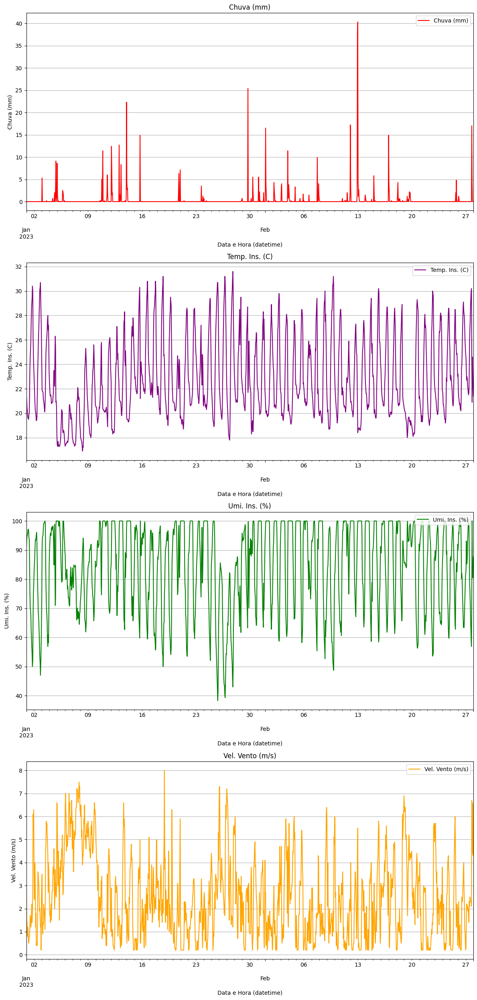

In [642]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client3_df_intervalo.plot(y=client3_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client3_df_intervalo.columns[3])
client3_df_intervalo.plot(y=client3_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client3_df_intervalo.columns[0])
client3_df_intervalo.plot(y=client3_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client3_df_intervalo.columns[1])
client3_df_intervalo.plot(y=client3_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client3_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client3_df_intervalo.columns[3])
axes[1].set_ylabel(client3_df_intervalo.columns[0])
axes[2].set_ylabel(client3_df_intervalo.columns[1])
axes[3].set_ylabel(client3_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

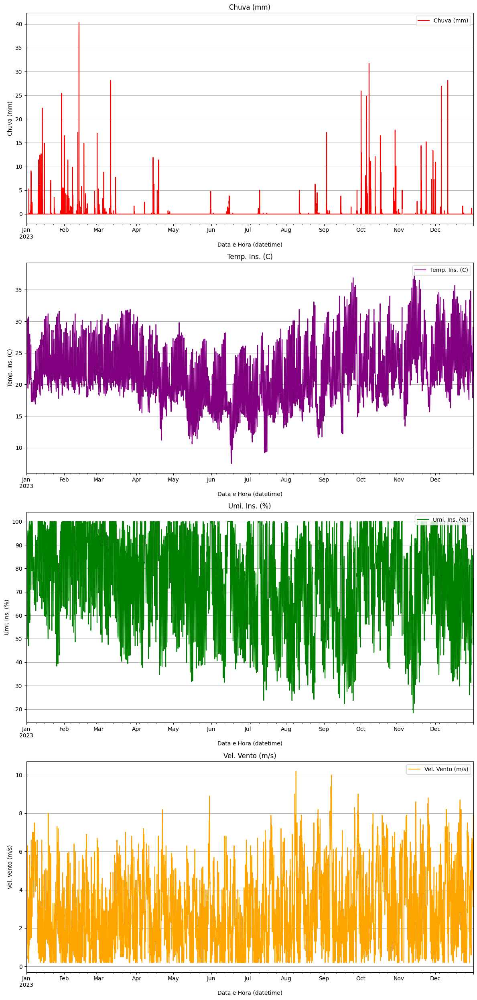

In [643]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client3_df.plot(y=client3_df.columns[3], ax=axes[0], color='red', legend=True, title=client3_df.columns[3])
client3_df.plot(y=client3_df.columns[0], ax=axes[1], color='purple', legend=True, title=client3_df.columns[0])
client3_df.plot(y=client3_df.columns[1], ax=axes[2], color='green', legend=True, title=client3_df.columns[1])
client3_df.plot(y=client3_df.columns[2], ax=axes[3], color='orange', legend=True, title=client3_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client3_df.columns[3])
axes[1].set_ylabel(client3_df.columns[0])
axes[2].set_ylabel(client3_df.columns[1])
axes[3].set_ylabel(client3_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [644]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client3_df.columns:
    if client3_df[column].isnull().any():
        client3_df[column] = client3_df[column].interpolate(method='linear')  # Interpolação linear

In [645]:
# Check missing values
print("Amount of missing values per column:")
print(client3_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client3_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [646]:
# Filters the data by interval
client3_df_intervalo = client3_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

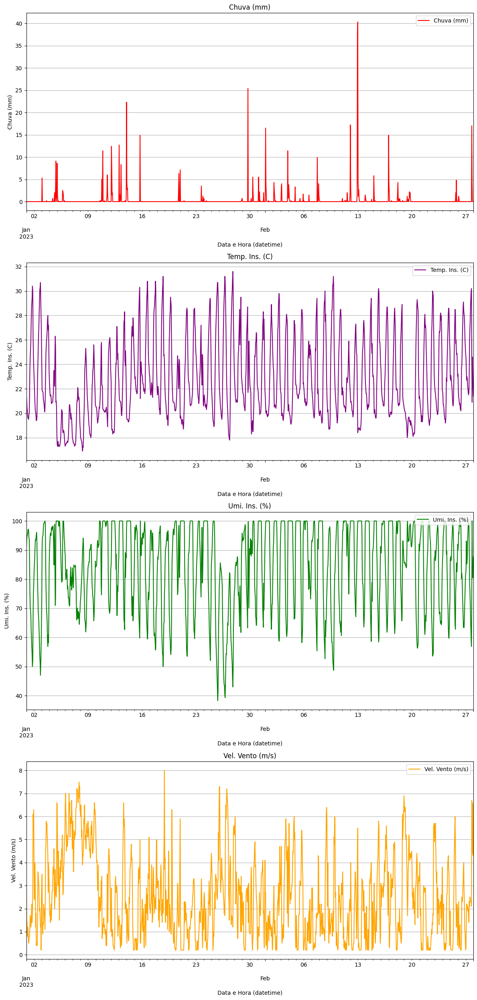

In [647]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client3_df_intervalo.plot(y=client3_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client3_df_intervalo.columns[3])
client3_df_intervalo.plot(y=client3_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client3_df_intervalo.columns[0])
client3_df_intervalo.plot(y=client3_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client3_df_intervalo.columns[1])
client3_df_intervalo.plot(y=client3_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client3_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client3_df_intervalo.columns[3])
axes[1].set_ylabel(client3_df_intervalo.columns[0])
axes[2].set_ylabel(client3_df_intervalo.columns[1])
axes[3].set_ylabel(client3_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

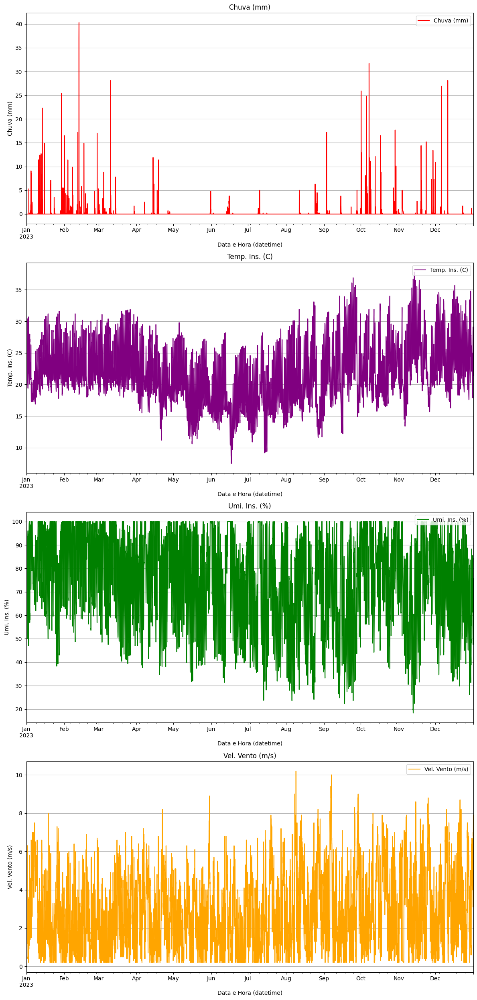

In [648]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client3_df.plot(y=client3_df.columns[3], ax=axes[0], color='red', legend=True, title=client3_df.columns[3])
client3_df.plot(y=client3_df.columns[0], ax=axes[1], color='purple', legend=True, title=client3_df.columns[0])
client3_df.plot(y=client3_df.columns[1], ax=axes[2], color='green', legend=True, title=client3_df.columns[1])
client3_df.plot(y=client3_df.columns[2], ax=axes[3], color='orange', legend=True, title=client3_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client3_df.columns[3])
axes[1].set_ylabel(client3_df.columns[0])
axes[2].set_ylabel(client3_df.columns[1])
axes[3].set_ylabel(client3_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [649]:
client3_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,21.5,89.5,4.2,0.0
2023-01-01 01:00:00,21.1,92.8,1.5,0.0
2023-01-01 02:00:00,20.5,94.7,1.4,0.0
2023-01-01 03:00:00,20.2,95.1,0.8,0.0
2023-01-01 04:00:00,19.8,95.7,1.2,0.0


In [650]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client3_df.pop(column)          # remove the column
client3_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client3_df.shape)

client3_df.head()

DataFrame format:
(8760, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,0.0,21.5,89.5,4.2
2023-01-01 01:00:00,0.0,21.1,92.8,1.5
2023-01-01 02:00:00,0.0,20.5,94.7,1.4
2023-01-01 03:00:00,0.0,20.2,95.1,0.8
2023-01-01 04:00:00,0.0,19.8,95.7,1.2


In [651]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client3_df['Chuva (mm) (t+1)'] = client3_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client3_df.pop(target_column)
client3_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client3_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client3_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2023-12-31 18:00:00,0.0,0.0,28.6,48.1,4.4
2023-12-31 19:00:00,0.0,0.0,28.4,49.3,6.1
2023-12-31 20:00:00,0.0,0.0,27.2,54.4,7.0
2023-12-31 21:00:00,0.0,0.0,25.9,57.6,6.8
2023-12-31 22:00:00,0.0,0.0,23.7,65.2,7.2


## Saving data as `.csv`

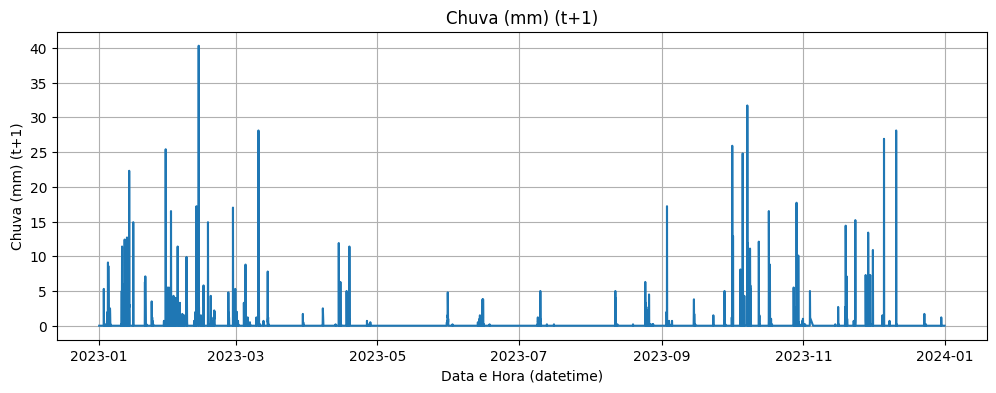

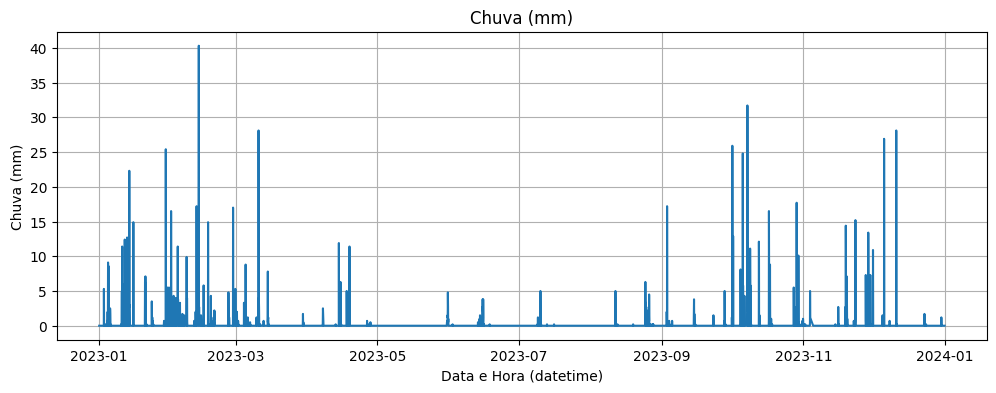

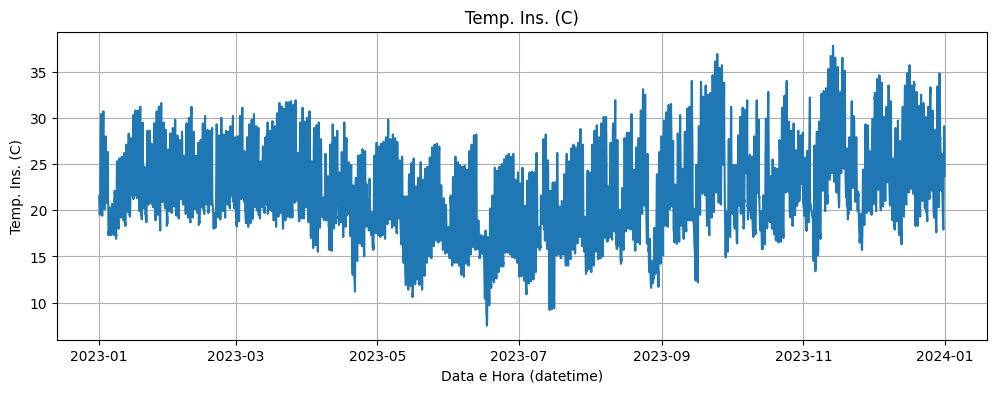

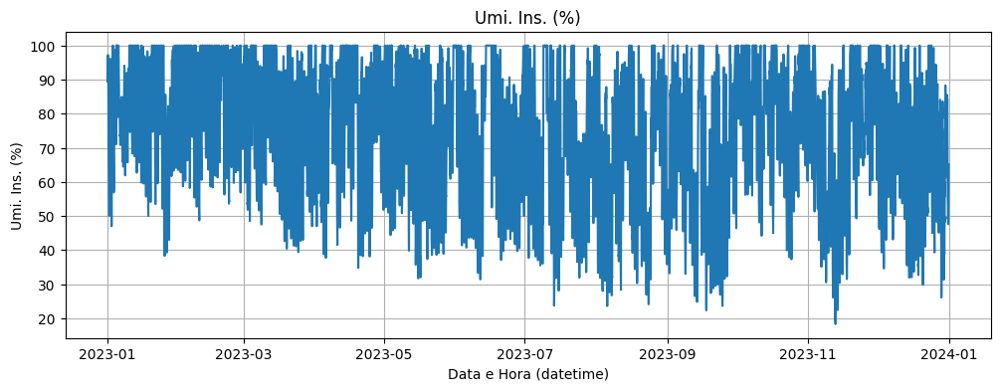

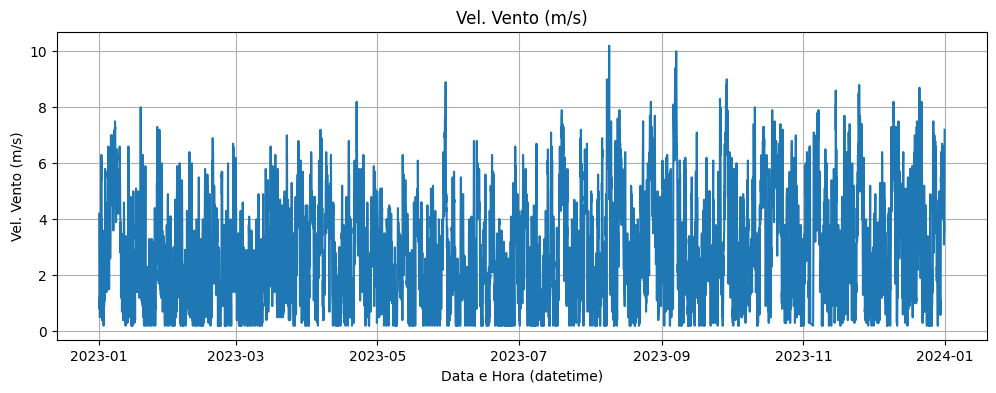

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8759 entries, 2023-01-01 00:00:00 to 2023-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8759 non-null   float64
 1   Chuva (mm)        8759 non-null   float64
 2   Temp. Ins. (C)    8759 non-null   float64
 3   Umi. Ins. (%)     8759 non-null   float64
 4   Vel. Vento (m/s)  8759 non-null   float64
dtypes: float64(5)
memory usage: 410.6 KB


In [652]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client3_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client3_df.index, client3_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client3_df.info()

In [653]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2023'
output_dir = 'Datasets tratados/2023'

os.makedirs(output_dir, exist_ok=True)

client3_df.to_csv(os.path.join(output_dir, 'Processed_Data_2023-Client-3_V0397_Itu.csv'),
                  index=True,                      # Include Index in the CSV file
                  date_format='%Y-%m-%d %H:%M:%S'  # Format for the datetime index
                  )

# 4. Client- Dataset (Piedade-ETEC)⭐

## Data collection and pre-processing

In [654]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0377 - Ibiuna/2023/INMET_SE_SP_V0377_IBIUNA-Dataset_01-01-2023_A_31-12-2023.csv'
file_path = 'Datasets Brutos/Estacao_V0455 - Piedade-ETEC/2023/INMET_SE_SP_V0455_PIEDADE-ETEC-Dataset_01-01-2023_A_31-12-2023.csv'

# Upload CSV file into DataFrame
client_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [655]:
print("Dataframe format:")
print(f" ↪Linhas: {client_df.shape[0]} \n ↪Colunas: {client_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client_df.head()

Dataframe format:
 ↪Linhas: 8760 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2023,0,21.1,NaN,NaN,88.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,01/01/2023,100,20.7,NaN,NaN,90.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1,NaN,NaN,NaN,0.0
2,01/01/2023,200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,01/01/2023,300,19.2,NaN,NaN,92.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,01/01/2023,400,18.3,NaN,NaN,94.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [656]:
# Data general info
print("General Dataset Information:")
print(client_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8760 non-null   object 
 1   Hora (UTC)            8760 non-null   int64  
 2   Temp. Ins. (C)        8281 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8281 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      7128 non-null   float

In [657]:
print("Descriptive statistics:")
client_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8760.000000,8281.000000,0.0,0.0,8281.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7128.000000,0.0,0.0,0.0,8281.000000
mean,1150.000000,20.437121,NaN,NaN,81.766465,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.457646,NaN,NaN,NaN,0.132134
std,692.258169,5.282980,NaN,NaN,15.502202,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.617520,NaN,NaN,NaN,0.958487
min,0.000000,5.100000,NaN,NaN,28.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,16.900000,NaN,NaN,72.700000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
50%,1150.000000,19.900000,NaN,NaN,87.400000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.200000,NaN,NaN,NaN,0.000000
75%,1725.000000,23.900000,NaN,NaN,93.600000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.700000,NaN,NaN,NaN,0.000000
max,2300.000000,36.700000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19.900000,NaN,NaN,NaN,26.600000


In [658]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client_df['Hora (UTC)'] = client_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client_df['Hora Datetime'] = pd.to_datetime(client_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client_df['Data e Hora (datetime)'] = client_df['ï»¿"Data"'] + ' ' + client_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client_df['Data e Hora (datetime)'] = pd.to_datetime(client_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_10224\497734369.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client_df.loc[0, 'Hora (UTC)'] = modified_value


0   2023-01-01 00:00:00
1   2023-01-01 01:00:00
2   2023-01-01 02:00:00
3   2023-01-01 03:00:00
4   2023-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [659]:
client_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2023,0000,21.1,NaN,NaN,88.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,00:00:00,2023-01-01 00:00:00
1,01/01/2023,0100,20.7,NaN,NaN,90.4,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.1,NaN,NaN,NaN,0.0,01:00:00,2023-01-01 01:00:00
2,01/01/2023,0200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,02:00:00,2023-01-01 02:00:00
3,01/01/2023,0300,19.2,NaN,NaN,92.7,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,03:00:00,2023-01-01 03:00:00
4,01/01/2023,0400,18.3,NaN,NaN,94.2,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,04:00:00,2023-01-01 04:00:00


In [660]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client_df = client_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8760, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2023-01-01 00:00:00,21.1,NaN,NaN,88.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,2023-01-01 01:00:00,20.7,NaN,NaN,90.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1,NaN,NaN,NaN,0.0
2,2023-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2023-01-01 03:00:00,19.2,NaN,NaN,92.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,2023-01-01 04:00:00,18.3,NaN,NaN,94.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [661]:
# Indexing of the 'Datetime' Date and Time
client_df.set_index('Data e Hora (datetime)', inplace=True)

client_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,21.1,NaN,NaN,88.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 01:00:00,20.7,NaN,NaN,90.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1,NaN,NaN,NaN,0.0
2023-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-01 03:00:00,19.2,NaN,NaN,92.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 04:00:00,18.3,NaN,NaN,94.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [662]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           479
Temp. Max. (C)          8760
Temp. Min. (C)          8760
Umi. Ins. (%)            479
Umi. Max. (%)           8760
Umi. Min. (%)           8760
Pto Orvalho Ins. (C)    8760
Pto Orvalho Max. (C)    8760
Pto Orvalho Min. (C)    8760
Pressao Ins. (hPa)      8760
Pressao Max. (hPa)      8760
Pressao Min. (hPa)      8760
Vel. Vento (m/s)        1632
Dir. Vento (m/s)        8760
Raj. Vento (m/s)        8760
Radiacao (KJ/mÂ²)       8760
Chuva (mm)               479
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            5.468037
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)             5.468037
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [663]:
# Dropping columns with 100% missing values
client_df = client_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)       5.468037
Umi. Ins. (%)        5.468037
Vel. Vento (m/s)    18.630137
Chuva (mm)           5.468037
dtype: float64


In [664]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [665]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,21.1,88.0,0.0,0.0
2023-01-01 01:00:00,20.7,90.4,0.1,0.0
2023-01-01 02:00:00,NaN,NaN,NaN,NaN
2023-01-01 03:00:00,19.2,92.7,0.0,0.0
2023-01-01 04:00:00,18.3,94.2,0.0,0.0


In [666]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [667]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

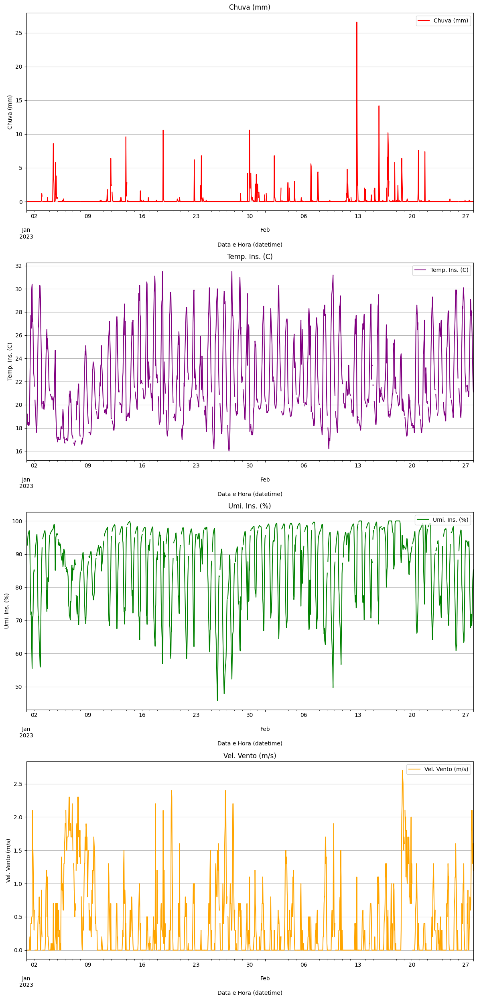

In [668]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

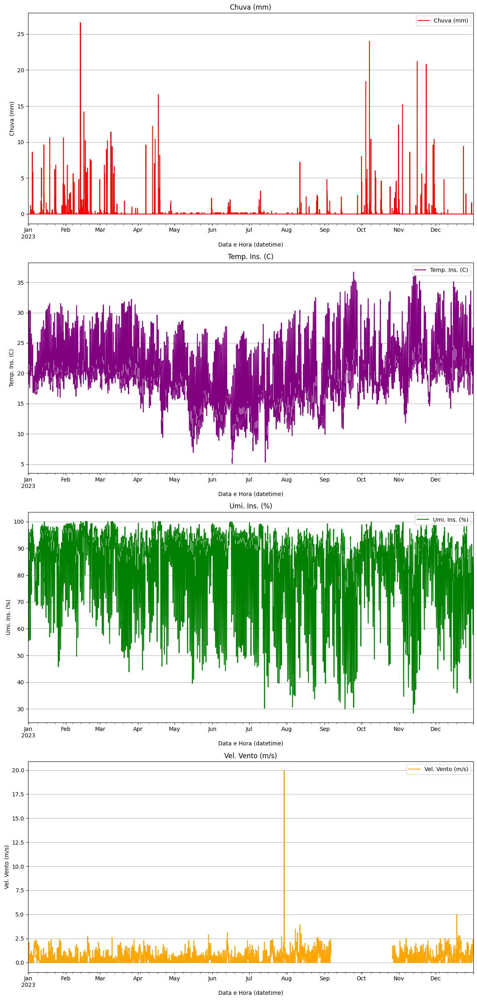

In [669]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [670]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client_df.columns:
    if client_df[column].isnull().any():
        client_df[column] = client_df[column].interpolate(method='linear')  # Interpolação linear

In [671]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [672]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

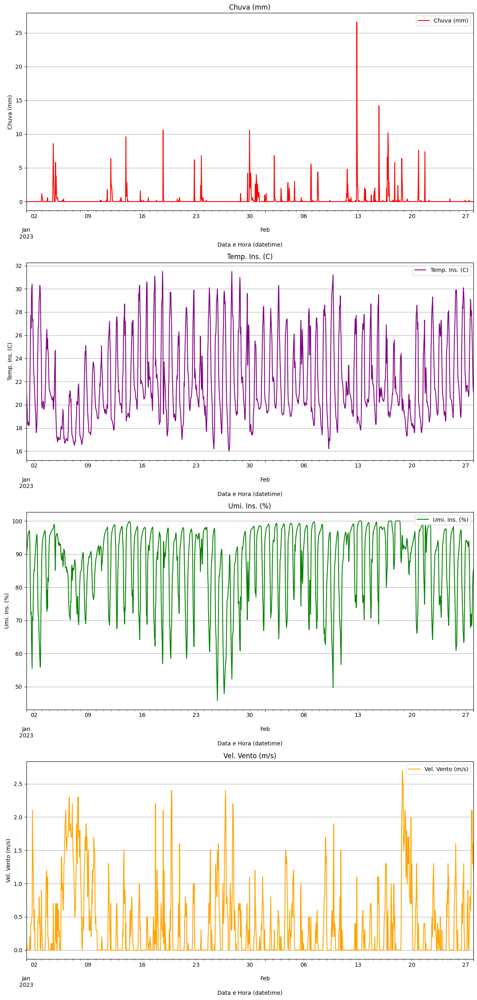

In [673]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

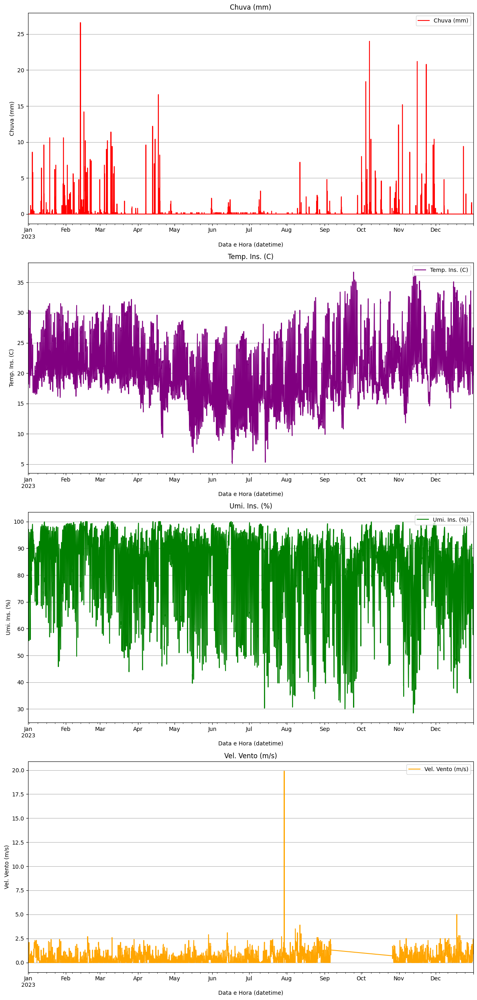

In [674]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [675]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,21.10,88.00,0.00,0.0
2023-01-01 01:00:00,20.70,90.40,0.10,0.0
2023-01-01 02:00:00,19.95,91.55,0.05,0.0
2023-01-01 03:00:00,19.20,92.70,0.00,0.0
2023-01-01 04:00:00,18.30,94.20,0.00,0.0


In [676]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8760, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,0.0,21.10,88.00,0.00
2023-01-01 01:00:00,0.0,20.70,90.40,0.10
2023-01-01 02:00:00,0.0,19.95,91.55,0.05
2023-01-01 03:00:00,0.0,19.20,92.70,0.00
2023-01-01 04:00:00,0.0,18.30,94.20,0.00


In [677]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client_df['Chuva (mm) (t+1)'] = client_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client_df.pop(target_column)
client_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2023-12-31 18:00:00,0.0,0.0,26.0,65.3,2.2
2023-12-31 19:00:00,0.0,0.0,24.7,68.3,2.4
2023-12-31 20:00:00,0.0,0.0,23.9,70.5,2.2
2023-12-31 21:00:00,0.0,0.0,21.8,78.3,2.3
2023-12-31 22:00:00,0.0,0.0,20.5,82.3,2.3


## Saving data as `.csv`

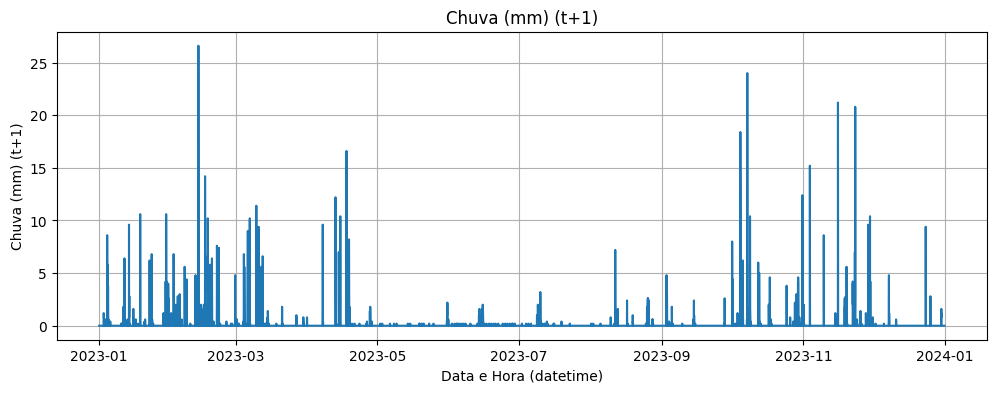

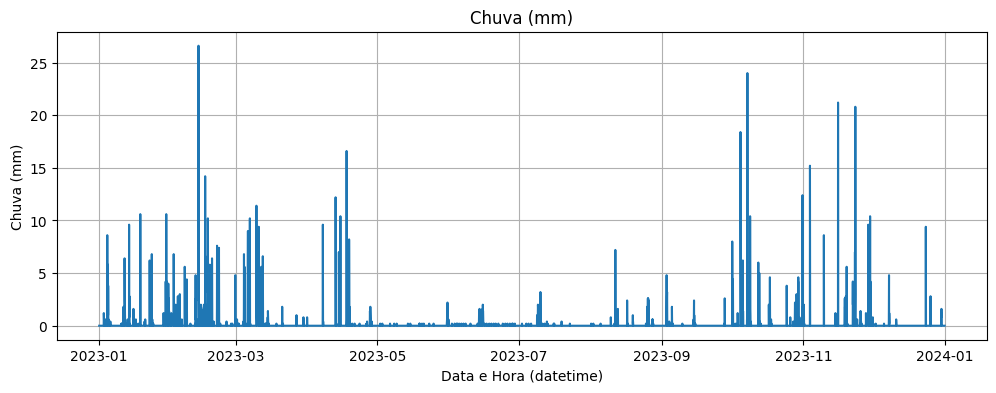

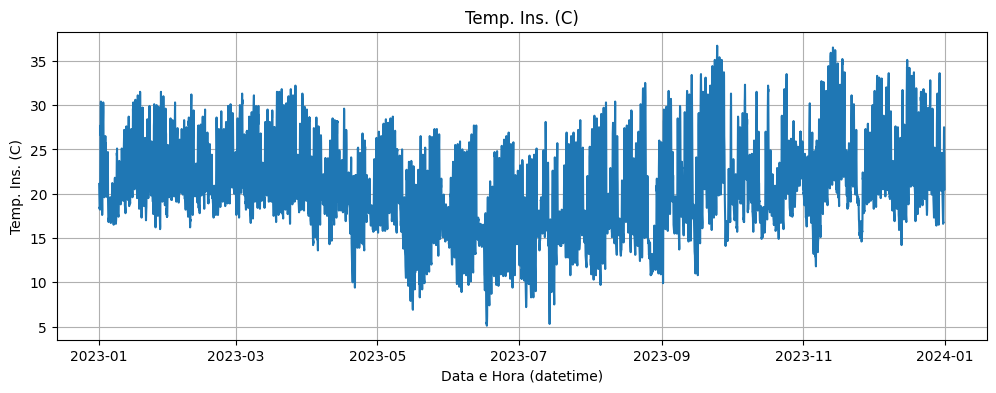

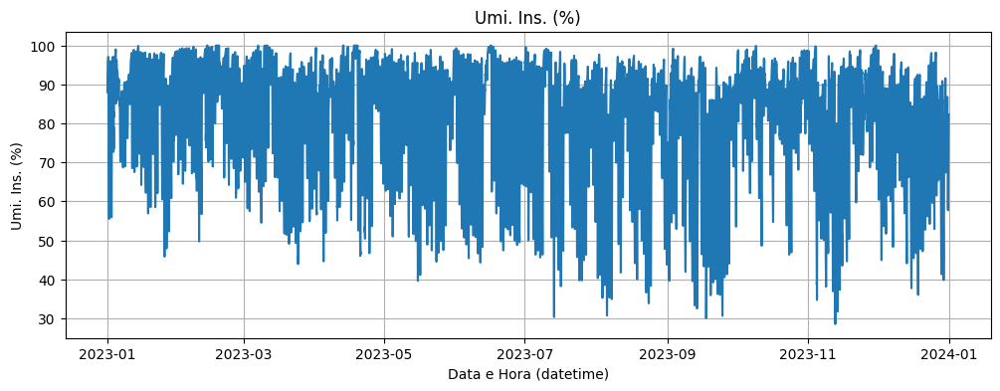

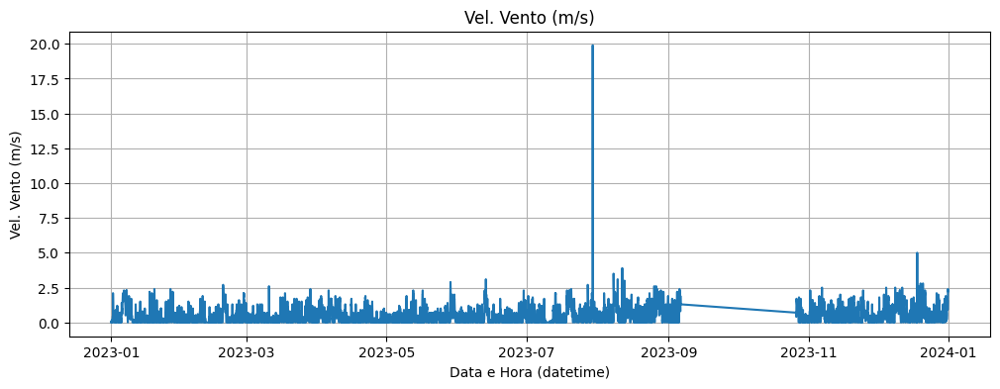

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8759 entries, 2023-01-01 00:00:00 to 2023-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8759 non-null   float64
 1   Chuva (mm)        8759 non-null   float64
 2   Temp. Ins. (C)    8759 non-null   float64
 3   Umi. Ins. (%)     8759 non-null   float64
 4   Vel. Vento (m/s)  8759 non-null   float64
dtypes: float64(5)
memory usage: 410.6 KB


In [678]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client_df.index, client_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client_df.info()

In [679]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2023'
output_dir = 'Datasets tratados/2023'

os.makedirs(output_dir, exist_ok=True)

client_df.to_csv(os.path.join(output_dir, 'Processed_Data_2023-Client-4_V0455_Piedade-ETEC.csv'),
                 index=True,                      # Include Index in the CSV file
                 date_format='%Y-%m-%d %H:%M:%S'  # Format for the datetime index
                 )


# 5. Client- Dataset (Porto Feliz)⭐

## Data collection and pre-processing

In [680]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0462 - Porto Feliz/2023/INMET_SE_SP_V0462_PORTO_FELIZ-Dataset_01-01-2023_A_31-12-2023.csv'
file_path = 'Datasets Brutos/Estacao_V0462 - Porto Feliz/2023/INMET_SE_SP_V0462_PORTO_FELIZ-Dataset_01-01-2023_A_31-12-2023.csv'

# Upload CSV file into DataFrame
client_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [681]:
print("Dataframe format:")
print(f" ↪Linhas: {client_df.shape[0]} \n ↪Colunas: {client_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client_df.head()

Dataframe format:
 ↪Linhas: 8760 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2023,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,01/01/2023,100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,01/01/2023,200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,01/01/2023,300,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,01/01/2023,400,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [682]:
# Data general info
print("General Dataset Information:")
print(client_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8760 non-null   object 
 1   Hora (UTC)            8760 non-null   int64  
 2   Temp. Ins. (C)        4808 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         4808 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      4808 non-null   float

In [683]:
print("Descriptive statistics:")
client_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8760.000000,4808.000000,0.0,0.0,4808.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4808.0,0.0,0.0,0.0,4808.000000
mean,1150.000000,22.856780,NaN,NaN,95.629659,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.193303
std,692.258169,5.190502,NaN,NaN,14.739163,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,1.677761
min,0.000000,7.200000,NaN,NaN,21.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.000000
25%,575.000000,19.700000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.000000
50%,1150.000000,22.400000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.000000
75%,1725.000000,26.600000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.000000
max,2300.000000,39.300000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,63.800000


In [684]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client_df['Hora (UTC)'] = client_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client_df['Hora Datetime'] = pd.to_datetime(client_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client_df['Data e Hora (datetime)'] = client_df['ï»¿"Data"'] + ' ' + client_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client_df['Data e Hora (datetime)'] = pd.to_datetime(client_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_10224\497734369.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client_df.loc[0, 'Hora (UTC)'] = modified_value


0   2023-01-01 00:00:00
1   2023-01-01 01:00:00
2   2023-01-01 02:00:00
3   2023-01-01 03:00:00
4   2023-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [685]:
client_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2023,0000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,00:00:00,2023-01-01 00:00:00
1,01/01/2023,0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,01:00:00,2023-01-01 01:00:00
2,01/01/2023,0200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,02:00:00,2023-01-01 02:00:00
3,01/01/2023,0300,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,03:00:00,2023-01-01 03:00:00
4,01/01/2023,0400,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,04:00:00,2023-01-01 04:00:00


In [686]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client_df = client_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8760, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2023-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2023-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2023-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2023-01-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2023-01-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [687]:
# Indexing of the 'Datetime' Date and Time
client_df.set_index('Data e Hora (datetime)', inplace=True)

client_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [688]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)          3952
Temp. Max. (C)          8760
Temp. Min. (C)          8760
Umi. Ins. (%)           3952
Umi. Max. (%)           8760
Umi. Min. (%)           8760
Pto Orvalho Ins. (C)    8760
Pto Orvalho Max. (C)    8760
Pto Orvalho Min. (C)    8760
Pressao Ins. (hPa)      8760
Pressao Max. (hPa)      8760
Pressao Min. (hPa)      8760
Vel. Vento (m/s)        3952
Dir. Vento (m/s)        8760
Raj. Vento (m/s)        8760
Radiacao (KJ/mÂ²)       8760
Chuva (mm)              3952
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)           45.114155
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)            45.114155
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [689]:
# Dropping columns with 100% missing values
client_df = client_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      45.114155
Umi. Ins. (%)       45.114155
Vel. Vento (m/s)    45.114155
Chuva (mm)          45.114155
dtype: float64


In [690]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [691]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,NaN,NaN,NaN,NaN
2023-01-01 01:00:00,NaN,NaN,NaN,NaN
2023-01-01 02:00:00,NaN,NaN,NaN,NaN
2023-01-01 03:00:00,NaN,NaN,NaN,NaN
2023-01-01 04:00:00,NaN,NaN,NaN,NaN


In [692]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [693]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

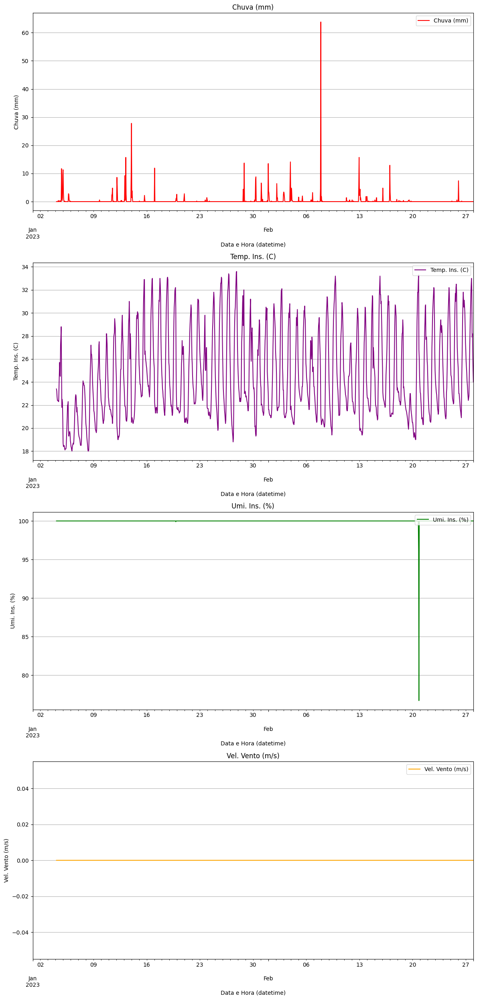

In [694]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

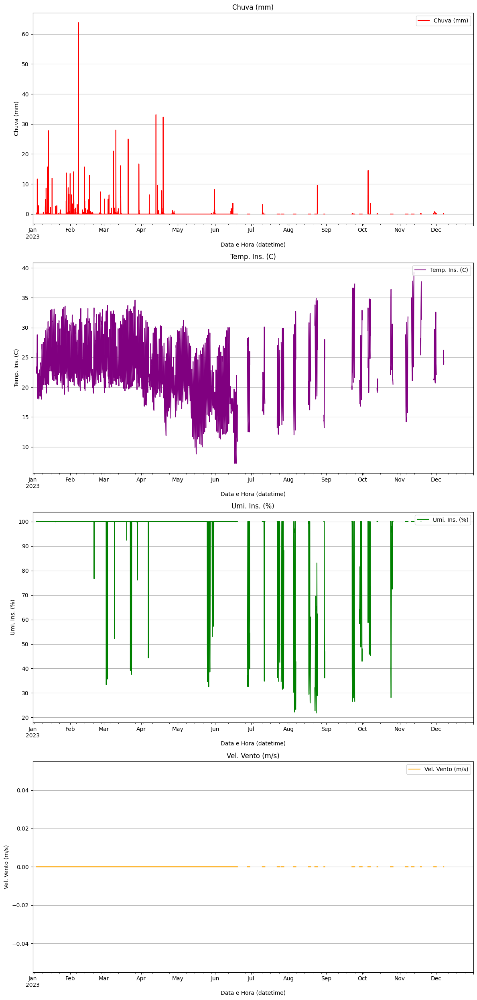

In [695]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [696]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client_df.columns:
    if client_df[column].isnull().any():
        client_df[column] = client_df[column].interpolate(method='linear')  # Interpolação linear

In [697]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      75
Umi. Ins. (%)       75
Vel. Vento (m/s)    75
Chuva (mm)          75
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.856164
Umi. Ins. (%)       0.856164
Vel. Vento (m/s)    0.856164
Chuva (mm)          0.856164
dtype: float64


Checking the main features visually

In [698]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

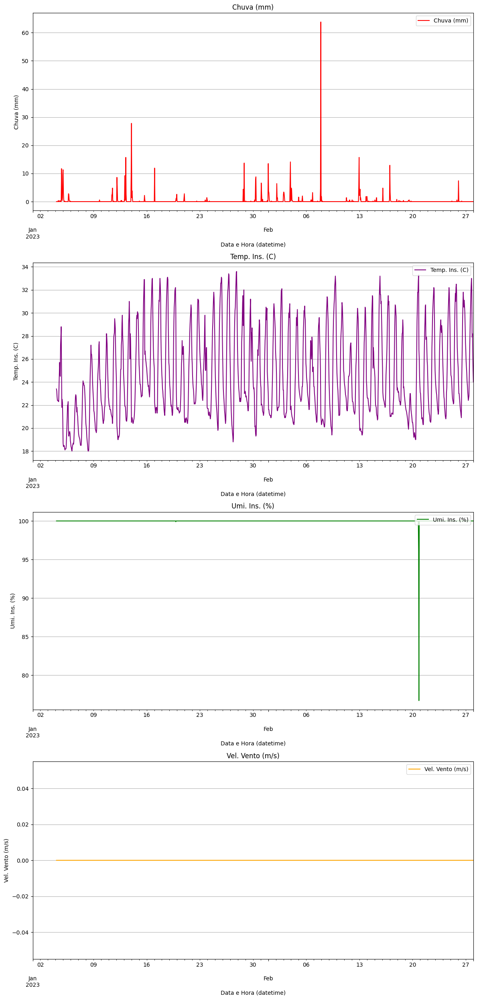

In [699]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

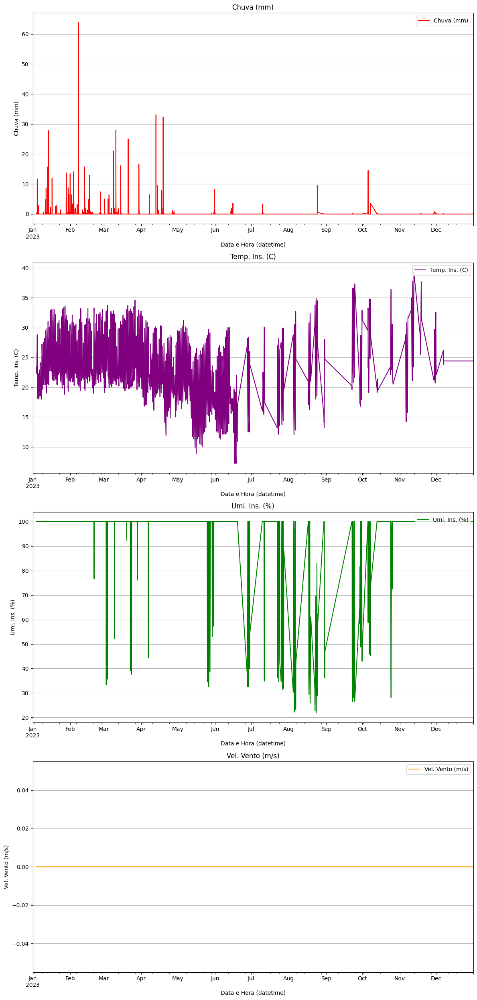

In [700]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [701]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,NaN,NaN,NaN,NaN
2023-01-01 01:00:00,NaN,NaN,NaN,NaN
2023-01-01 02:00:00,NaN,NaN,NaN,NaN
2023-01-01 03:00:00,NaN,NaN,NaN,NaN
2023-01-01 04:00:00,NaN,NaN,NaN,NaN


In [702]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8760, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,NaN,NaN,NaN,NaN
2023-01-01 01:00:00,NaN,NaN,NaN,NaN
2023-01-01 02:00:00,NaN,NaN,NaN,NaN
2023-01-01 03:00:00,NaN,NaN,NaN,NaN
2023-01-01 04:00:00,NaN,NaN,NaN,NaN


In [703]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client_df['Chuva (mm) (t+1)'] = client_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client_df.pop(target_column)
client_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2023-12-31 18:00:00,0.0,0.0,24.4,100.0,0.0
2023-12-31 19:00:00,0.0,0.0,24.4,100.0,0.0
2023-12-31 20:00:00,0.0,0.0,24.4,100.0,0.0
2023-12-31 21:00:00,0.0,0.0,24.4,100.0,0.0
2023-12-31 22:00:00,0.0,0.0,24.4,100.0,0.0


## Saving data as `.csv`

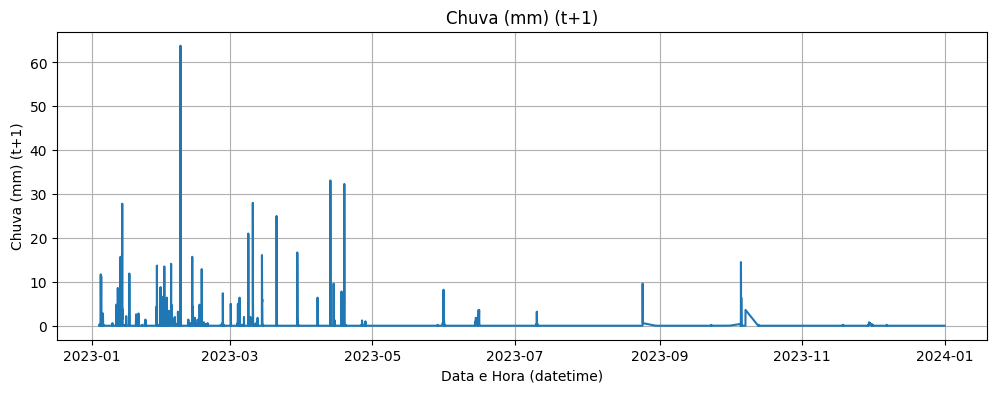

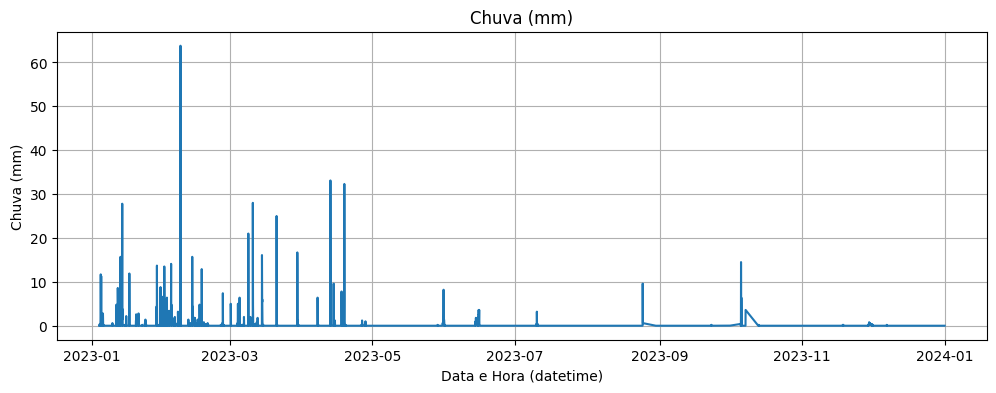

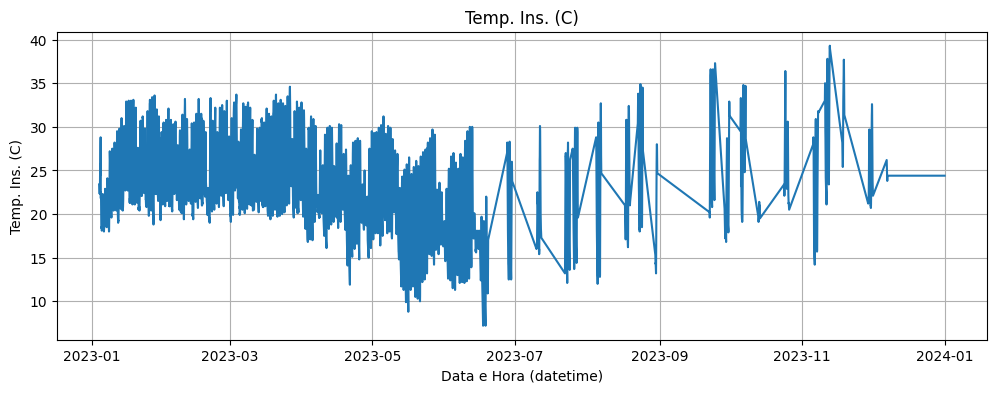

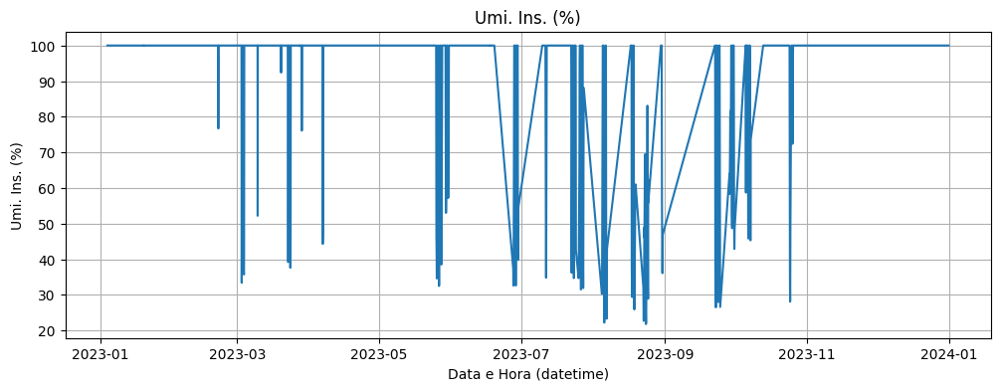

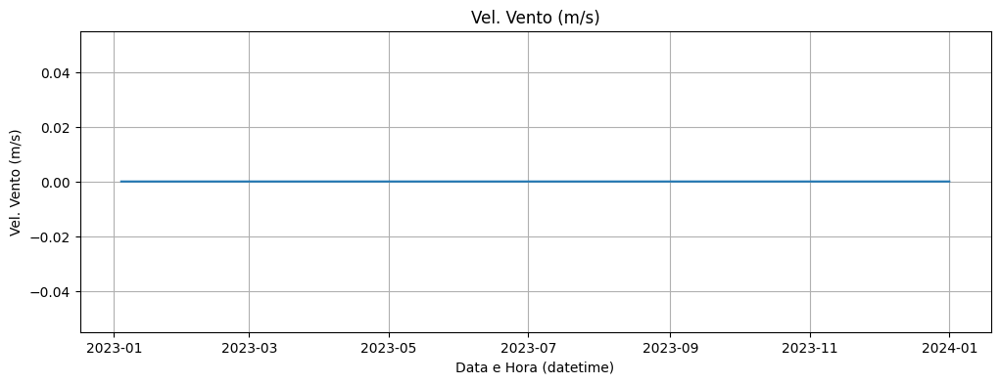

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8685 entries, 2023-01-04 02:00:00 to 2023-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8685 non-null   float64
 1   Chuva (mm)        8684 non-null   float64
 2   Temp. Ins. (C)    8684 non-null   float64
 3   Umi. Ins. (%)     8684 non-null   float64
 4   Vel. Vento (m/s)  8684 non-null   float64
dtypes: float64(5)
memory usage: 407.1 KB


In [704]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client_df.index, client_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client_df.info()

In [705]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2023'
output_dir = 'Datasets tratados/2023'

os.makedirs(output_dir, exist_ok=True)

client_df.to_csv(os.path.join(output_dir, 'Processed_Data_2023-Client-5_V0462_Porto_Feliz.csv'),
                 index=True,                        # Include Index in the CSV file
                 date_format='%Y-%m-%d %H:%M:%S'    # Format for the datetime index
                 )

# 6. Client- Dataset (Sarapui)⭐

## Data collection and pre-processing

In [706]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0492 - Sarapui/2023/INMET_SE_SP_V0492_SARAPUI-Dataset_01-01-2023_A_31-12-2023.csv'
file_path = 'Datasets Brutos/Estacao_V0492 - Sarapui/2023/INMET_SE_SP_V0492_SARAPUI-Dataset_01-01-2023_A_31-12-2023.csv'

# Upload CSV file into DataFrame
client_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [707]:
print("Dataframe format:")
print(f" ↪Linhas: {client_df.shape[0]} \n ↪Colunas: {client_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client_df.head()

Dataframe format:
 ↪Linhas: 8760 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2023,0,22.8,NaN,NaN,79.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,01/01/2023,100,22.2,NaN,NaN,82.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,01/01/2023,200,21.6,NaN,NaN,84.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,01/01/2023,300,21.2,NaN,NaN,86.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,01/01/2023,400,20.7,NaN,NaN,87.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [708]:
# Data general info
print("General Dataset Information:")
print(client_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8760 non-null   object 
 1   Hora (UTC)            8760 non-null   int64  
 2   Temp. Ins. (C)        8559 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8559 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      8559 non-null   float

In [709]:
print("Descriptive statistics:")
client_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8760.000000,8559.000000,0.0,0.0,8559.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8559.000000,0.0,0.0,0.0,8559.000000
mean,1150.000000,21.504872,NaN,NaN,73.281014,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.109370,NaN,NaN,NaN,0.148148
std,692.258169,5.392984,NaN,NaN,16.493530,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.466677,NaN,NaN,NaN,1.210518
min,0.000000,6.800000,NaN,NaN,18.700000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,17.900000,NaN,NaN,61.700000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.900000,NaN,NaN,NaN,0.000000
50%,1150.000000,21.200000,NaN,NaN,78.900000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.200000,NaN,NaN,NaN,0.000000
75%,1725.000000,25.000000,NaN,NaN,87.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.400000,NaN,NaN,NaN,0.000000
max,2300.000000,38.600000,NaN,NaN,95.400000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.100000,NaN,NaN,NaN,36.200000


In [710]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client_df['Hora (UTC)'] = client_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client_df['Hora Datetime'] = pd.to_datetime(client_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client_df['Data e Hora (datetime)'] = client_df['ï»¿"Data"'] + ' ' + client_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client_df['Data e Hora (datetime)'] = pd.to_datetime(client_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_10224\497734369.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client_df.loc[0, 'Hora (UTC)'] = modified_value


0   2023-01-01 00:00:00
1   2023-01-01 01:00:00
2   2023-01-01 02:00:00
3   2023-01-01 03:00:00
4   2023-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [711]:
client_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2023,0000,22.8,NaN,NaN,79.3,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,00:00:00,2023-01-01 00:00:00
1,01/01/2023,0100,22.2,NaN,NaN,82.1,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,01:00:00,2023-01-01 01:00:00
2,01/01/2023,0200,21.6,NaN,NaN,84.8,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,02:00:00,2023-01-01 02:00:00
3,01/01/2023,0300,21.2,NaN,NaN,86.2,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,03:00:00,2023-01-01 03:00:00
4,01/01/2023,0400,20.7,NaN,NaN,87.4,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,04:00:00,2023-01-01 04:00:00


In [712]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client_df = client_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8760, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2023-01-01 00:00:00,22.8,NaN,NaN,79.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,2023-01-01 01:00:00,22.2,NaN,NaN,82.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,2023-01-01 02:00:00,21.6,NaN,NaN,84.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,2023-01-01 03:00:00,21.2,NaN,NaN,86.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,2023-01-01 04:00:00,20.7,NaN,NaN,87.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [713]:
# Indexing of the 'Datetime' Date and Time
client_df.set_index('Data e Hora (datetime)', inplace=True)

client_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,22.8,NaN,NaN,79.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 01:00:00,22.2,NaN,NaN,82.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 02:00:00,21.6,NaN,NaN,84.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 03:00:00,21.2,NaN,NaN,86.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 04:00:00,20.7,NaN,NaN,87.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [714]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           201
Temp. Max. (C)          8760
Temp. Min. (C)          8760
Umi. Ins. (%)            201
Umi. Max. (%)           8760
Umi. Min. (%)           8760
Pto Orvalho Ins. (C)    8760
Pto Orvalho Max. (C)    8760
Pto Orvalho Min. (C)    8760
Pressao Ins. (hPa)      8760
Pressao Max. (hPa)      8760
Pressao Min. (hPa)      8760
Vel. Vento (m/s)         201
Dir. Vento (m/s)        8760
Raj. Vento (m/s)        8760
Radiacao (KJ/mÂ²)       8760
Chuva (mm)               201
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            2.294521
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)             2.294521
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [715]:
# Dropping columns with 100% missing values
client_df = client_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      2.294521
Umi. Ins. (%)       2.294521
Vel. Vento (m/s)    2.294521
Chuva (mm)          2.294521
dtype: float64


In [716]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [717]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,22.8,79.3,0.0,0.0
2023-01-01 01:00:00,22.2,82.1,0.0,0.0
2023-01-01 02:00:00,21.6,84.8,0.0,0.0
2023-01-01 03:00:00,21.2,86.2,0.0,0.0
2023-01-01 04:00:00,20.7,87.4,0.0,0.0


In [718]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [719]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

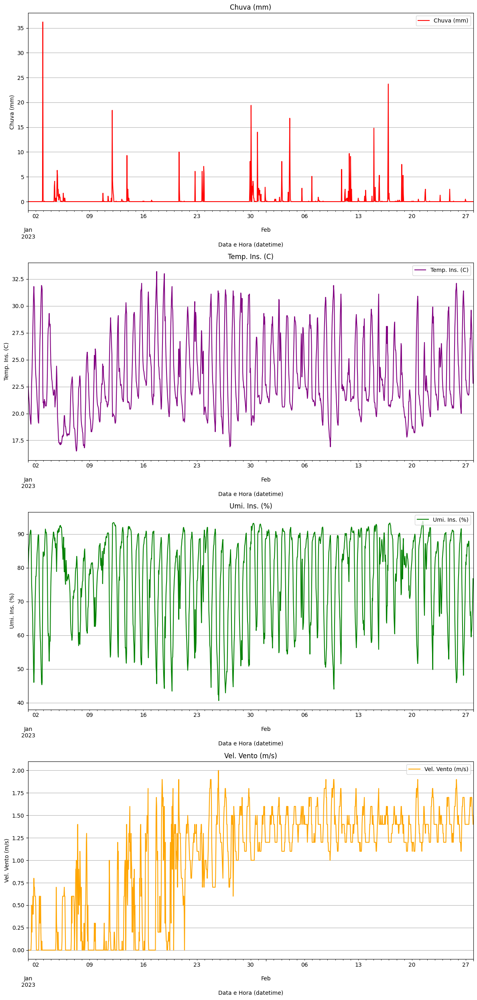

In [720]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

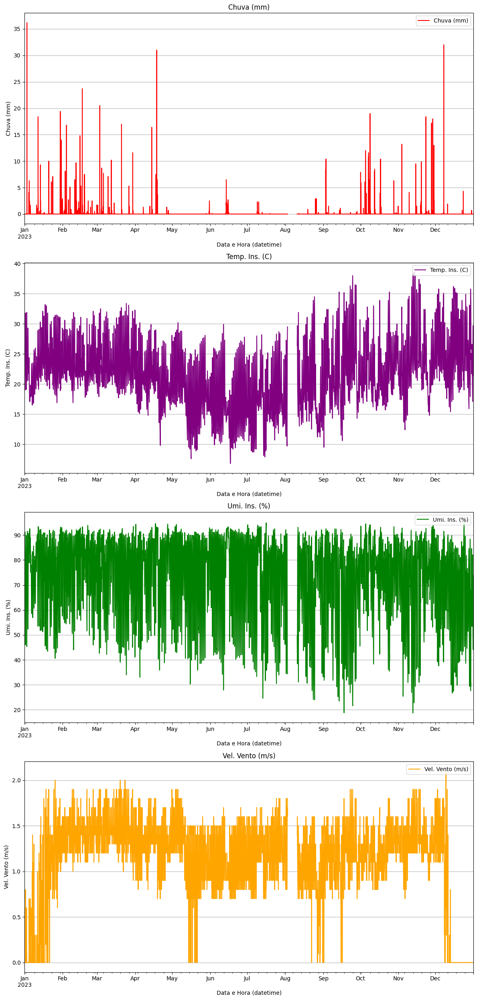

In [721]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [722]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client_df.columns:
    if client_df[column].isnull().any():
        client_df[column] = client_df[column].interpolate(method='linear')  # Interpolação linear

In [723]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [724]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

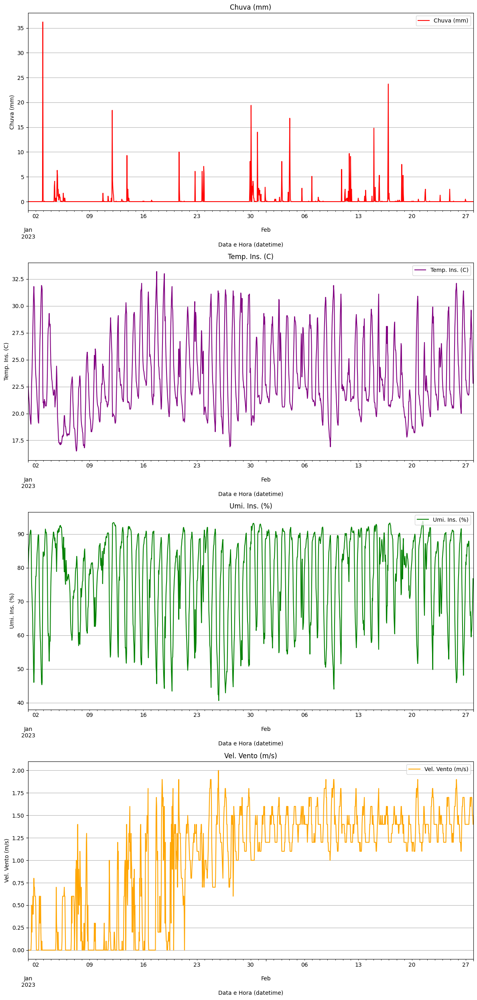

In [725]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

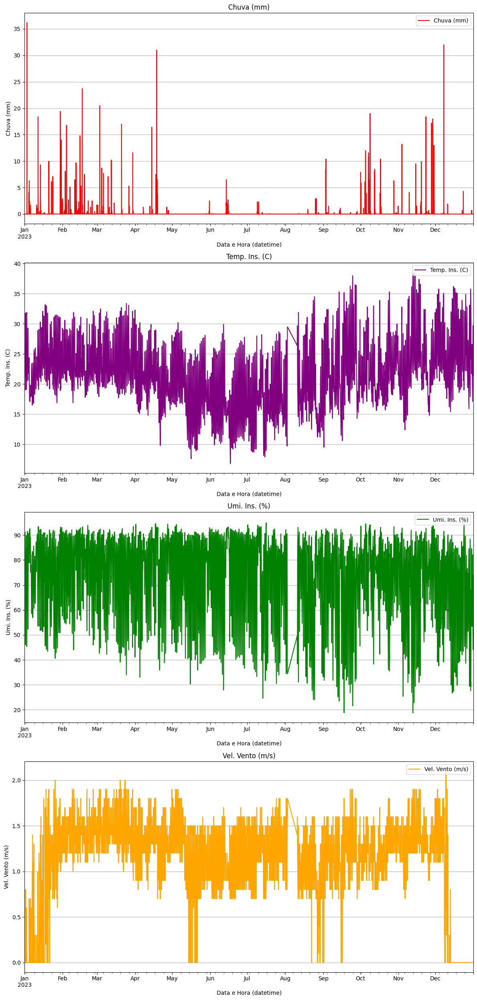

In [726]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [727]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,22.8,79.3,0.0,0.0
2023-01-01 01:00:00,22.2,82.1,0.0,0.0
2023-01-01 02:00:00,21.6,84.8,0.0,0.0
2023-01-01 03:00:00,21.2,86.2,0.0,0.0
2023-01-01 04:00:00,20.7,87.4,0.0,0.0


In [728]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8760, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,0.0,22.8,79.3,0.0
2023-01-01 01:00:00,0.0,22.2,82.1,0.0
2023-01-01 02:00:00,0.0,21.6,84.8,0.0
2023-01-01 03:00:00,0.0,21.2,86.2,0.0
2023-01-01 04:00:00,0.0,20.7,87.4,0.0


In [729]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client_df['Chuva (mm) (t+1)'] = client_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client_df.pop(target_column)
client_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2023-12-31 18:00:00,0.0,0.0,28.7,50.4,0.0
2023-12-31 19:00:00,0.0,0.0,27.5,53.2,0.0
2023-12-31 20:00:00,0.0,0.0,27.0,54.4,0.0
2023-12-31 21:00:00,0.0,0.0,24.6,61.8,0.0
2023-12-31 22:00:00,0.0,0.0,23.0,68.0,0.0


## Saving data as `.csv`

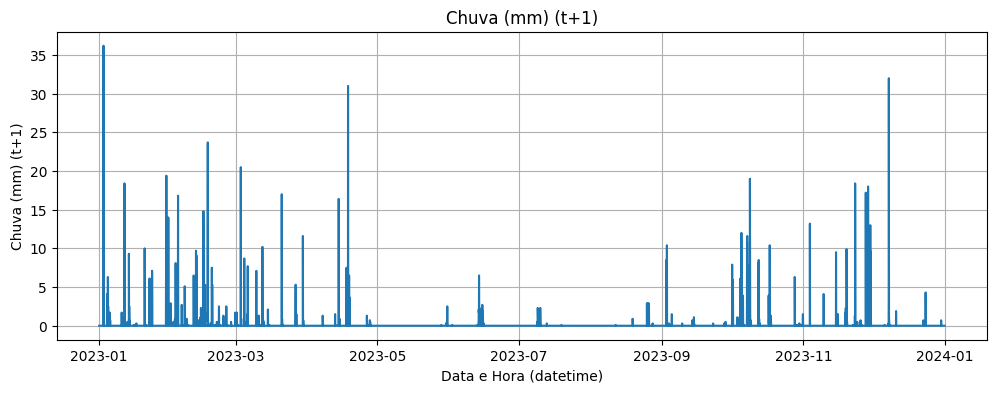

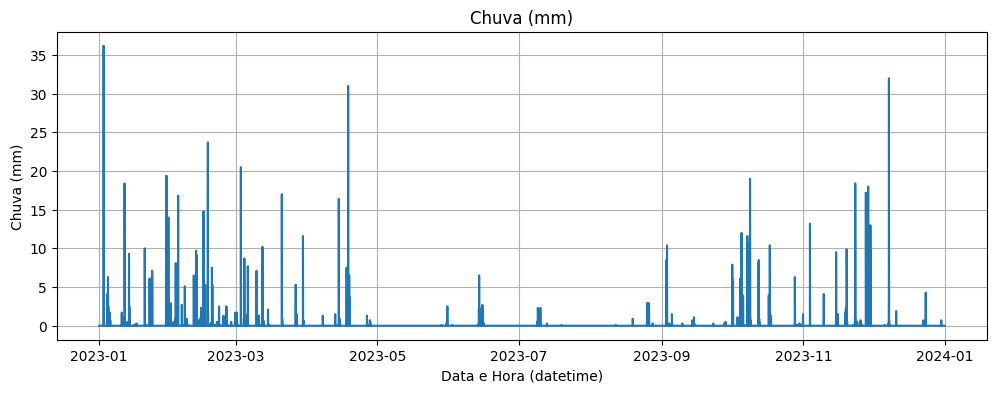

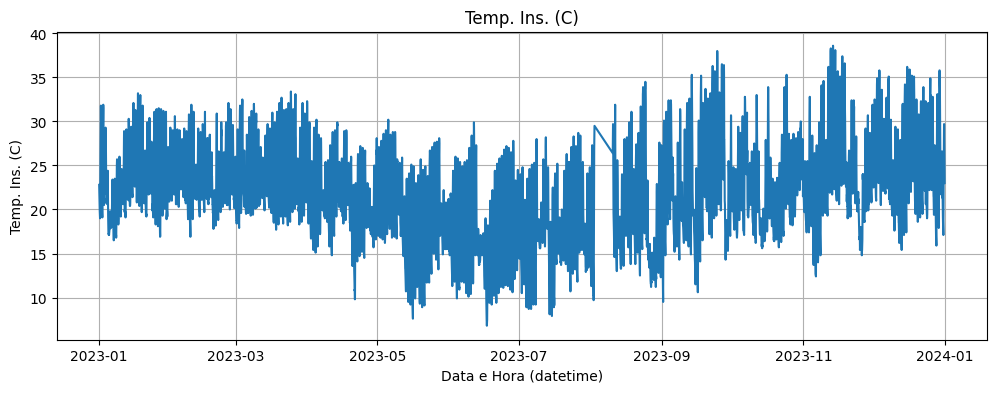

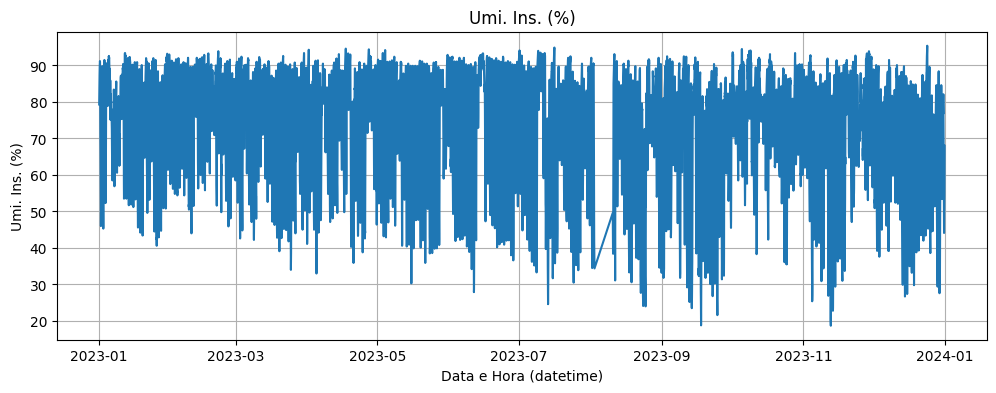

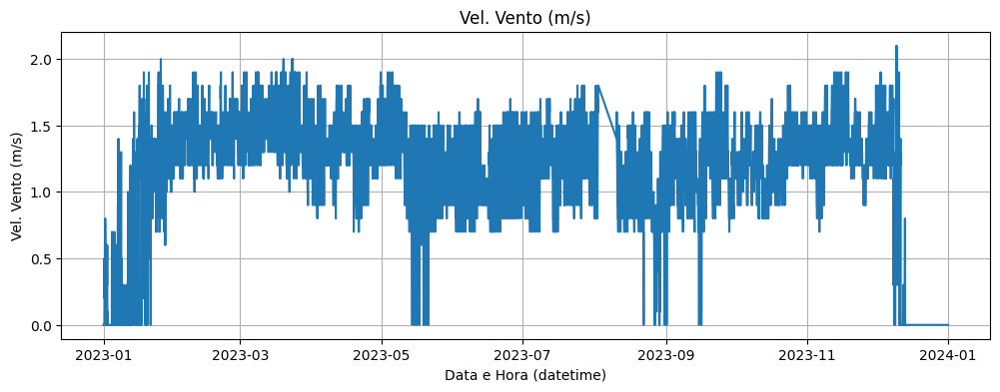

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8759 entries, 2023-01-01 00:00:00 to 2023-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8759 non-null   float64
 1   Chuva (mm)        8759 non-null   float64
 2   Temp. Ins. (C)    8759 non-null   float64
 3   Umi. Ins. (%)     8759 non-null   float64
 4   Vel. Vento (m/s)  8759 non-null   float64
dtypes: float64(5)
memory usage: 410.6 KB


In [730]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client_df.index, client_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client_df.info()

In [731]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2023'
output_dir = 'Datasets tratados/2023'

os.makedirs(output_dir, exist_ok=True)

client_df.to_csv(os.path.join(output_dir, 'Processed_Data_2023-Client-6_V0492_Sarapui.csv'),
                 index=True,                        # Include Index in the CSV file
                 date_format='%Y-%m-%d %H:%M:%S'    # Format for the datetime index
                 )

# 7. Client- Dataset (Sorocaba)⭐

## Data collection and pre-processing

In [732]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0498 - Sorocaba/2023/INMET_SE_SP_V0498_SOROCABA-Dataset_01-01-2023_A_31-12-2023.csv'
file_path = 'Datasets Brutos/Estacao_V0498 - Sorocaba/2023/INMET_SE_SP_V0498_SOROCABA-Dataset_01-01-2023_A_31-12-2023.csv'

# Upload CSV file into DataFrame
client_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [733]:
print("Dataframe format:")
print(f" ↪Linhas: {client_df.shape[0]} \n ↪Colunas: {client_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client_df.head()

Dataframe format:
 ↪Linhas: 8760 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2023,0,21.4,NaN,NaN,92.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,01/01/2023,100,21.0,NaN,NaN,92.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,01/01/2023,200,20.8,NaN,NaN,93.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.2,NaN,NaN,NaN,0.0
3,01/01/2023,300,20.6,NaN,NaN,93.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,01/01/2023,400,20.1,NaN,NaN,93.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [734]:
# Data general info
print("General Dataset Information:")
print(client_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8760 non-null   object 
 1   Hora (UTC)            8760 non-null   int64  
 2   Temp. Ins. (C)        8639 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8639 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      8639 non-null   float

In [735]:
print("Descriptive statistics:")
client_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8760.000000,8639.000000,0.0,0.0,8639.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8639.000000,0.0,0.0,0.0,8639.000000
mean,1150.000000,22.174928,NaN,NaN,69.836914,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.361246,NaN,NaN,NaN,0.163468
std,692.258169,5.141408,NaN,NaN,17.003857,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.236536,NaN,NaN,NaN,1.398501
min,0.000000,7.500000,NaN,NaN,19.100000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,18.800000,NaN,NaN,57.600000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
50%,1150.000000,21.700000,NaN,NaN,72.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.600000,NaN,NaN,NaN,0.000000
75%,1725.000000,25.600000,NaN,NaN,83.400000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.600000,NaN,NaN,NaN,0.000000
max,2300.000000,38.300000,NaN,NaN,98.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.100000,NaN,NaN,NaN,66.200000


In [736]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client_df['Hora (UTC)'] = client_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client_df['Hora Datetime'] = pd.to_datetime(client_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client_df['Data e Hora (datetime)'] = client_df['ï»¿"Data"'] + ' ' + client_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client_df['Data e Hora (datetime)'] = pd.to_datetime(client_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_10224\497734369.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client_df.loc[0, 'Hora (UTC)'] = modified_value


0   2023-01-01 00:00:00
1   2023-01-01 01:00:00
2   2023-01-01 02:00:00
3   2023-01-01 03:00:00
4   2023-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [737]:
client_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2023,0000,21.4,NaN,NaN,92.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,00:00:00,2023-01-01 00:00:00
1,01/01/2023,0100,21.0,NaN,NaN,92.9,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,01:00:00,2023-01-01 01:00:00
2,01/01/2023,0200,20.8,NaN,NaN,93.6,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.2,NaN,NaN,NaN,0.0,02:00:00,2023-01-01 02:00:00
3,01/01/2023,0300,20.6,NaN,NaN,93.5,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,03:00:00,2023-01-01 03:00:00
4,01/01/2023,0400,20.1,NaN,NaN,93.2,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,04:00:00,2023-01-01 04:00:00


In [738]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client_df = client_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8760, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2023-01-01 00:00:00,21.4,NaN,NaN,92.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,2023-01-01 01:00:00,21.0,NaN,NaN,92.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,2023-01-01 02:00:00,20.8,NaN,NaN,93.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.2,NaN,NaN,NaN,0.0
3,2023-01-01 03:00:00,20.6,NaN,NaN,93.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,2023-01-01 04:00:00,20.1,NaN,NaN,93.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [739]:
# Indexing of the 'Datetime' Date and Time
client_df.set_index('Data e Hora (datetime)', inplace=True)

client_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,21.4,NaN,NaN,92.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 01:00:00,21.0,NaN,NaN,92.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 02:00:00,20.8,NaN,NaN,93.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.2,NaN,NaN,NaN,0.0
2023-01-01 03:00:00,20.6,NaN,NaN,93.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 04:00:00,20.1,NaN,NaN,93.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [740]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           121
Temp. Max. (C)          8760
Temp. Min. (C)          8760
Umi. Ins. (%)            121
Umi. Max. (%)           8760
Umi. Min. (%)           8760
Pto Orvalho Ins. (C)    8760
Pto Orvalho Max. (C)    8760
Pto Orvalho Min. (C)    8760
Pressao Ins. (hPa)      8760
Pressao Max. (hPa)      8760
Pressao Min. (hPa)      8760
Vel. Vento (m/s)         121
Dir. Vento (m/s)        8760
Raj. Vento (m/s)        8760
Radiacao (KJ/mÂ²)       8760
Chuva (mm)               121
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            1.381279
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)             1.381279
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [741]:
# Dropping columns with 100% missing values
client_df = client_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      1.381279
Umi. Ins. (%)       1.381279
Vel. Vento (m/s)    1.381279
Chuva (mm)          1.381279
dtype: float64


In [742]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [743]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,21.4,92.0,0.0,0.0
2023-01-01 01:00:00,21.0,92.9,0.0,0.0
2023-01-01 02:00:00,20.8,93.6,0.2,0.0
2023-01-01 03:00:00,20.6,93.5,0.0,0.0
2023-01-01 04:00:00,20.1,93.2,0.0,0.0


In [744]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [745]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

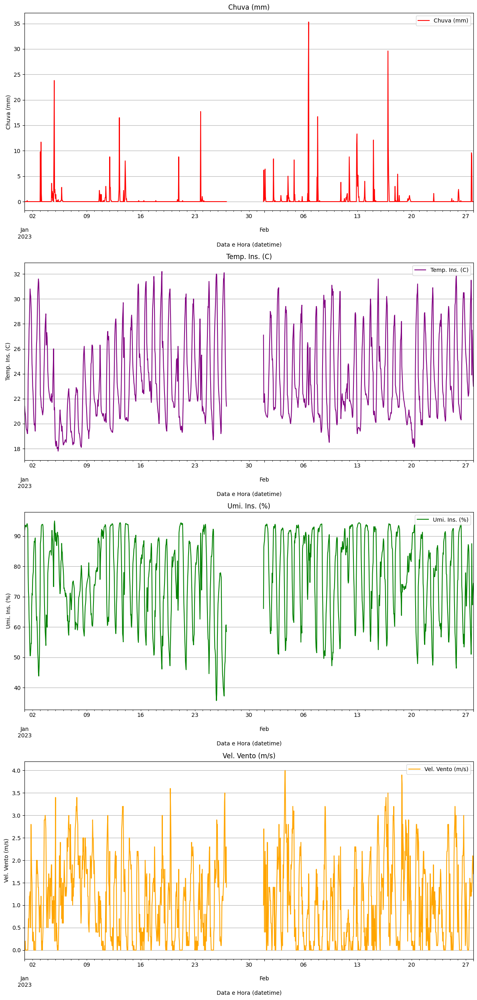

In [746]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

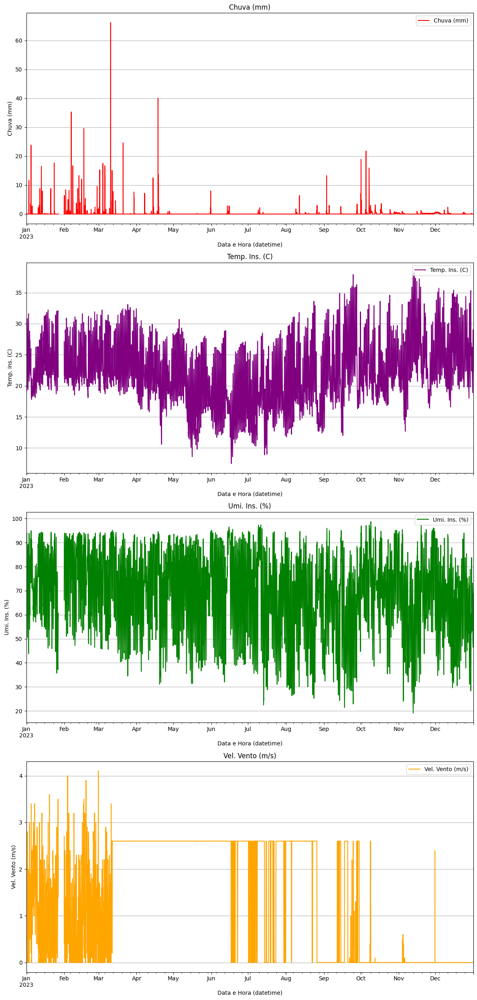

In [747]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [748]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client_df.columns:
    if client_df[column].isnull().any():
        client_df[column] = client_df[column].interpolate(method='linear')  # Interpolação linear

In [749]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [750]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

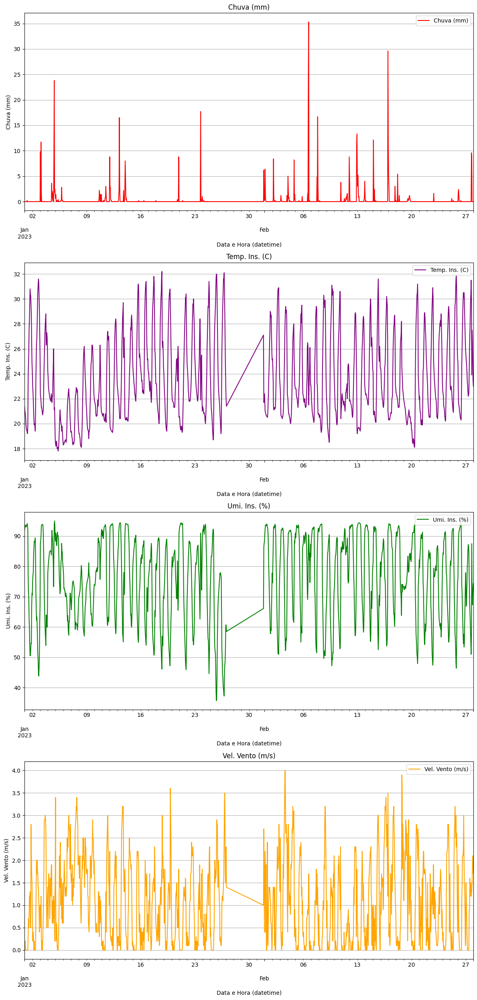

In [751]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

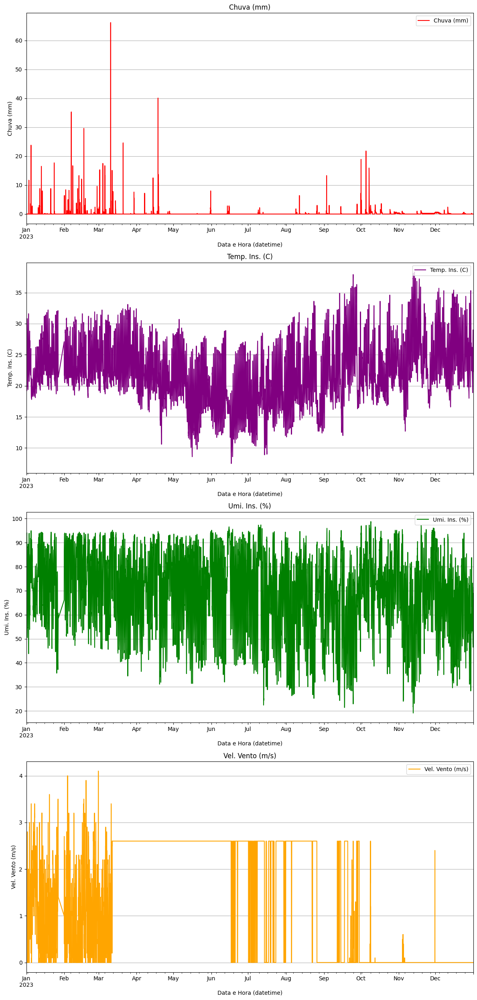

In [752]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [753]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,21.4,92.0,0.0,0.0
2023-01-01 01:00:00,21.0,92.9,0.0,0.0
2023-01-01 02:00:00,20.8,93.6,0.2,0.0
2023-01-01 03:00:00,20.6,93.5,0.0,0.0
2023-01-01 04:00:00,20.1,93.2,0.0,0.0


In [754]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8760, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,0.0,21.4,92.0,0.0
2023-01-01 01:00:00,0.0,21.0,92.9,0.0
2023-01-01 02:00:00,0.0,20.8,93.6,0.2
2023-01-01 03:00:00,0.0,20.6,93.5,0.0
2023-01-01 04:00:00,0.0,20.1,93.2,0.0


In [755]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client_df['Chuva (mm) (t+1)'] = client_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client_df.pop(target_column)
client_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2023-12-31 18:00:00,0.0,0.0,28.8,48.0,0.0
2023-12-31 19:00:00,0.0,0.0,27.4,53.8,0.0
2023-12-31 20:00:00,0.0,0.0,27.5,52.9,0.0
2023-12-31 21:00:00,0.0,0.0,26.5,55.5,0.0
2023-12-31 22:00:00,0.0,0.0,24.5,61.4,0.0


## Saving data as `.csv`

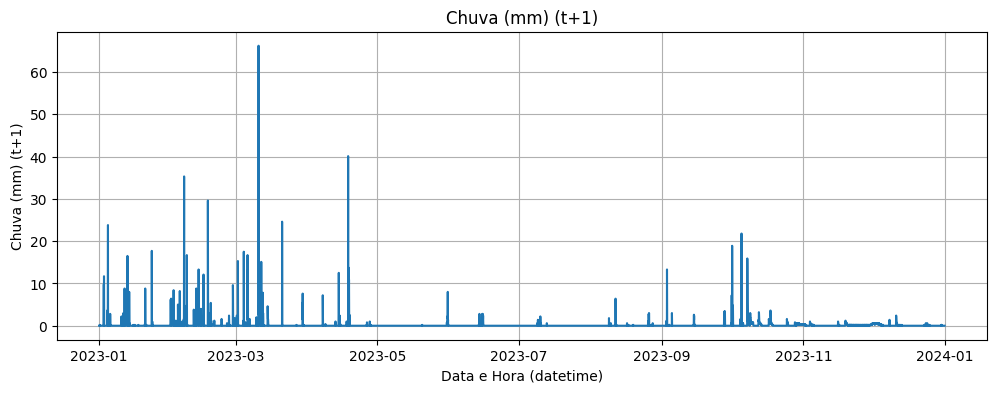

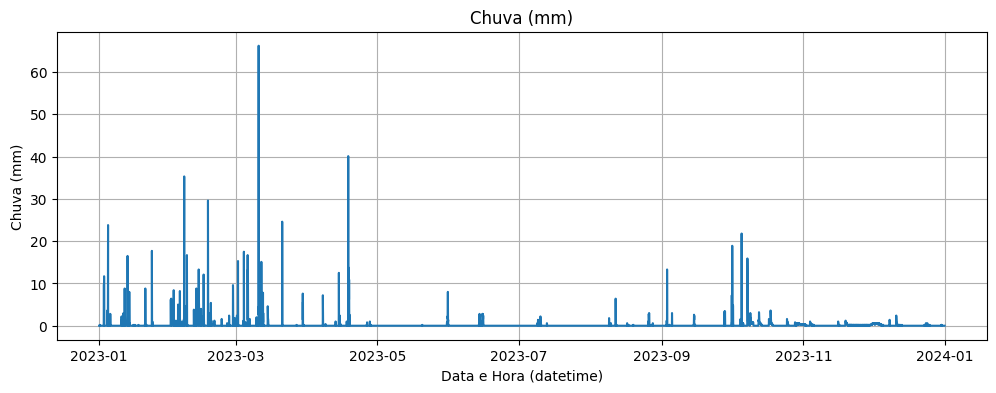

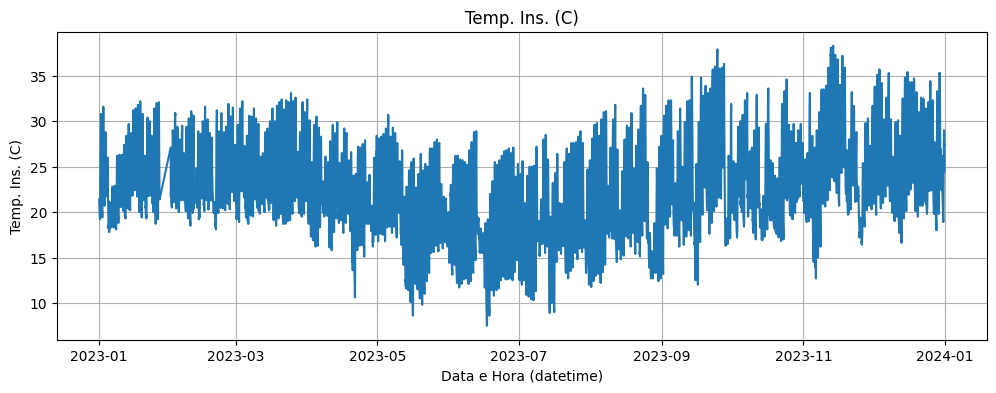

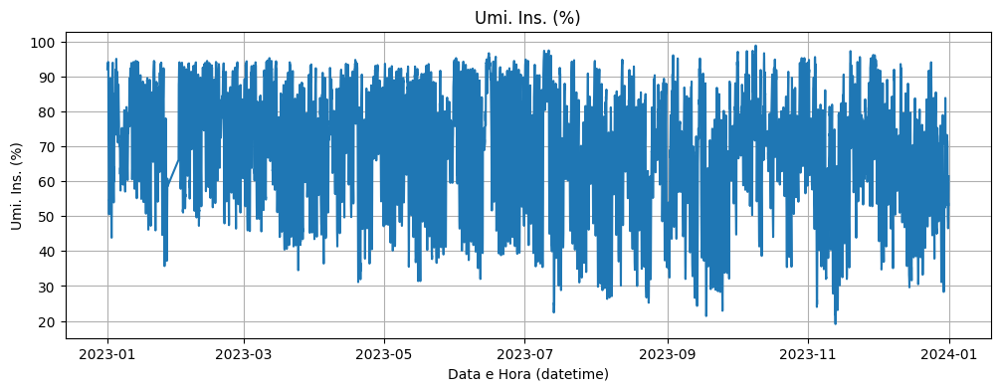

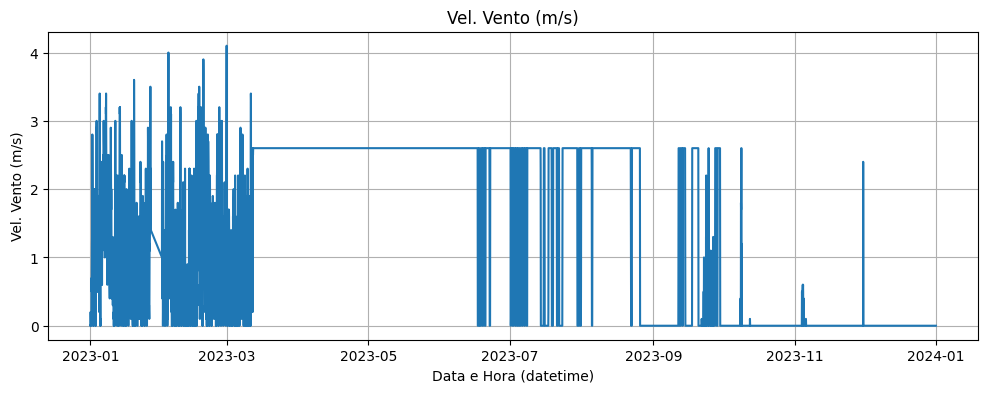

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8759 entries, 2023-01-01 00:00:00 to 2023-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8759 non-null   float64
 1   Chuva (mm)        8759 non-null   float64
 2   Temp. Ins. (C)    8759 non-null   float64
 3   Umi. Ins. (%)     8759 non-null   float64
 4   Vel. Vento (m/s)  8759 non-null   float64
dtypes: float64(5)
memory usage: 410.6 KB


In [756]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client_df.index, client_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client_df.info()

In [757]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2023'
output_dir = 'Datasets tratados/2023'

os.makedirs(output_dir, exist_ok=True)

client_df.to_csv(os.path.join(output_dir, 'Processed_Data_2023-Client-7_V0498_Sorocaba.csv'),
                 index=True,                        # Include Index in the CSV file
                 date_format='%Y-%m-%d %H:%M:%S'    # Format for the datetime index
                 )


# 8. Client- Dataset (Tatui)⭐

## Data collection and pre-processing

In [758]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0507 - Tatui/2023/INMET_SE_SP_V0507_TATUI-Dataset_01-01-2023_A_31-12-2023.csv'
file_path = 'Datasets Brutos/Estacao_V0507 - Tatui/2023/INMET_SE_SP_V0507_TATUI-Dataset_01-01-2023_A_31-12-2023.csv'

# Upload CSV file into DataFrame
client_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [759]:
print("Dataframe format:")
print(f" ↪Linhas: {client_df.shape[0]} \n ↪Colunas: {client_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client_df.head()

Dataframe format:
 ↪Linhas: 8760 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2023,0,21.1,NaN,NaN,93.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.1,NaN,NaN,NaN,0.0
1,01/01/2023,100,20.2,NaN,NaN,99.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0
2,01/01/2023,200,19.4,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0
3,01/01/2023,300,18.7,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0
4,01/01/2023,400,18.1,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.2,NaN,NaN,NaN,0.0


In [760]:
# Data general info
print("General Dataset Information:")
print(client_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8760 non-null   object 
 1   Hora (UTC)            8760 non-null   int64  
 2   Temp. Ins. (C)        7492 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         7492 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      7492 non-null   float

In [761]:
print("Descriptive statistics:")
client_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8760.000000,7492.000000,0.0,0.0,7492.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7492.000000,0.0,0.0,0.0,7492.000000
mean,1150.000000,20.805192,NaN,NaN,81.195435,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.395302,NaN,NaN,NaN,0.154378
std,692.258169,5.344091,NaN,NaN,19.849902,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.935412,NaN,NaN,NaN,1.576874
min,0.000000,5.400000,NaN,NaN,21.700000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,17.500000,NaN,NaN,67.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.700000,NaN,NaN,NaN,0.000000
50%,1150.000000,20.300000,NaN,NaN,87.900000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.300000,NaN,NaN,NaN,0.000000
75%,1725.000000,24.300000,NaN,NaN,99.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.000000,NaN,NaN,NaN,0.000000
max,2300.000000,37.300000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.300000,NaN,NaN,NaN,79.700000


In [762]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client_df['Hora (UTC)'] = client_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client_df['Hora Datetime'] = pd.to_datetime(client_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client_df['Data e Hora (datetime)'] = client_df['ï»¿"Data"'] + ' ' + client_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client_df['Data e Hora (datetime)'] = pd.to_datetime(client_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_10224\497734369.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client_df.loc[0, 'Hora (UTC)'] = modified_value


0   2023-01-01 00:00:00
1   2023-01-01 01:00:00
2   2023-01-01 02:00:00
3   2023-01-01 03:00:00
4   2023-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [763]:
client_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2023,0000,21.1,NaN,NaN,93.1,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.1,NaN,NaN,NaN,0.0,00:00:00,2023-01-01 00:00:00
1,01/01/2023,0100,20.2,NaN,NaN,99.4,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0,01:00:00,2023-01-01 01:00:00
2,01/01/2023,0200,19.4,NaN,NaN,100.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0,02:00:00,2023-01-01 02:00:00
3,01/01/2023,0300,18.7,NaN,NaN,100.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0,03:00:00,2023-01-01 03:00:00
4,01/01/2023,0400,18.1,NaN,NaN,100.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.2,NaN,NaN,NaN,0.0,04:00:00,2023-01-01 04:00:00


In [764]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client_df = client_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8760, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2023-01-01 00:00:00,21.1,NaN,NaN,93.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.1,NaN,NaN,NaN,0.0
1,2023-01-01 01:00:00,20.2,NaN,NaN,99.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0
2,2023-01-01 02:00:00,19.4,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0
3,2023-01-01 03:00:00,18.7,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0
4,2023-01-01 04:00:00,18.1,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.2,NaN,NaN,NaN,0.0


In [765]:
# Indexing of the 'Datetime' Date and Time
client_df.set_index('Data e Hora (datetime)', inplace=True)

client_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,21.1,NaN,NaN,93.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.1,NaN,NaN,NaN,0.0
2023-01-01 01:00:00,20.2,NaN,NaN,99.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0
2023-01-01 02:00:00,19.4,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0
2023-01-01 03:00:00,18.7,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0
2023-01-01 04:00:00,18.1,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.2,NaN,NaN,NaN,0.0


In [766]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)          1268
Temp. Max. (C)          8760
Temp. Min. (C)          8760
Umi. Ins. (%)           1268
Umi. Max. (%)           8760
Umi. Min. (%)           8760
Pto Orvalho Ins. (C)    8760
Pto Orvalho Max. (C)    8760
Pto Orvalho Min. (C)    8760
Pressao Ins. (hPa)      8760
Pressao Max. (hPa)      8760
Pressao Min. (hPa)      8760
Vel. Vento (m/s)        1268
Dir. Vento (m/s)        8760
Raj. Vento (m/s)        8760
Radiacao (KJ/mÂ²)       8760
Chuva (mm)              1268
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)           14.474886
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)            14.474886
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [767]:
# Dropping columns with 100% missing values
client_df = client_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      14.474886
Umi. Ins. (%)       14.474886
Vel. Vento (m/s)    14.474886
Chuva (mm)          14.474886
dtype: float64


In [768]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [769]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,21.1,93.1,1.1,0.0
2023-01-01 01:00:00,20.2,99.4,0.6,0.0
2023-01-01 02:00:00,19.4,100.0,0.6,0.0
2023-01-01 03:00:00,18.7,100.0,0.6,0.0
2023-01-01 04:00:00,18.1,100.0,0.2,0.0


In [770]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [771]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

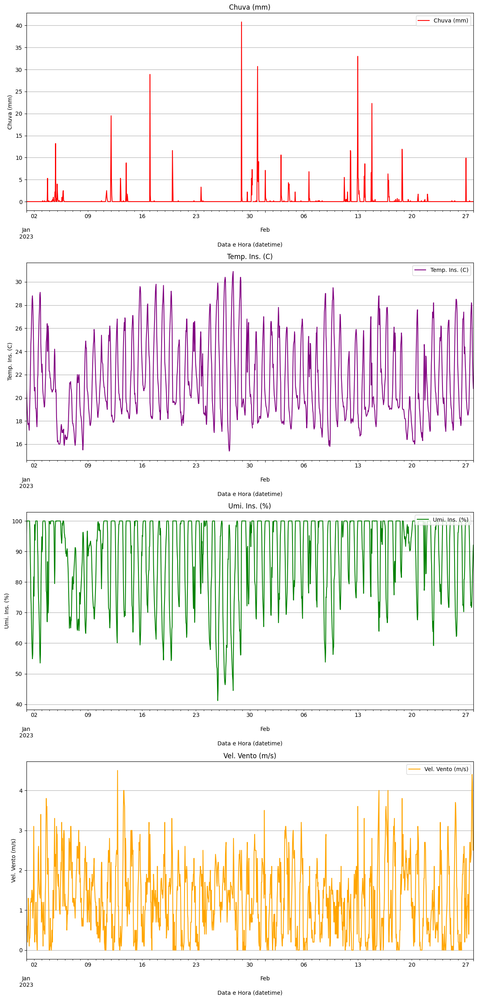

In [772]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

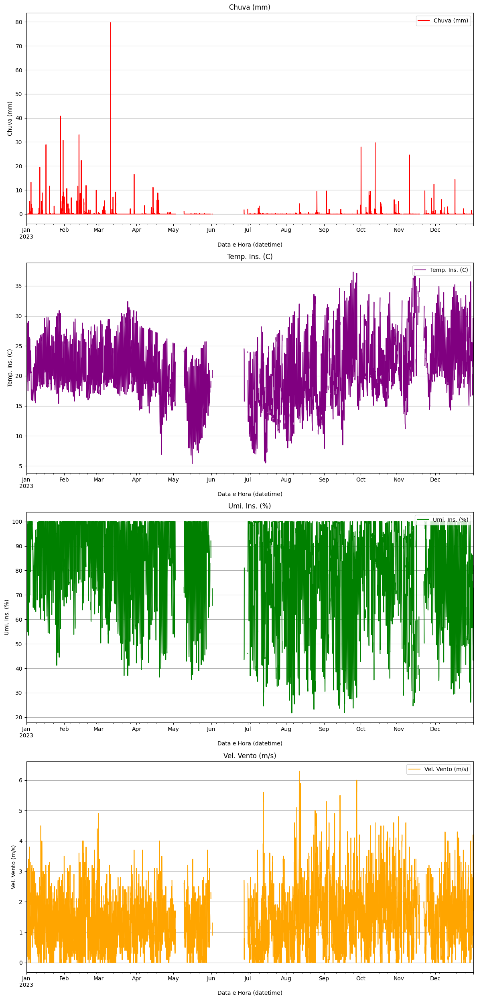

In [773]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [774]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client_df.columns:
    if client_df[column].isnull().any():
        client_df[column] = client_df[column].interpolate(method='linear')  # Interpolação linear

In [775]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [776]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

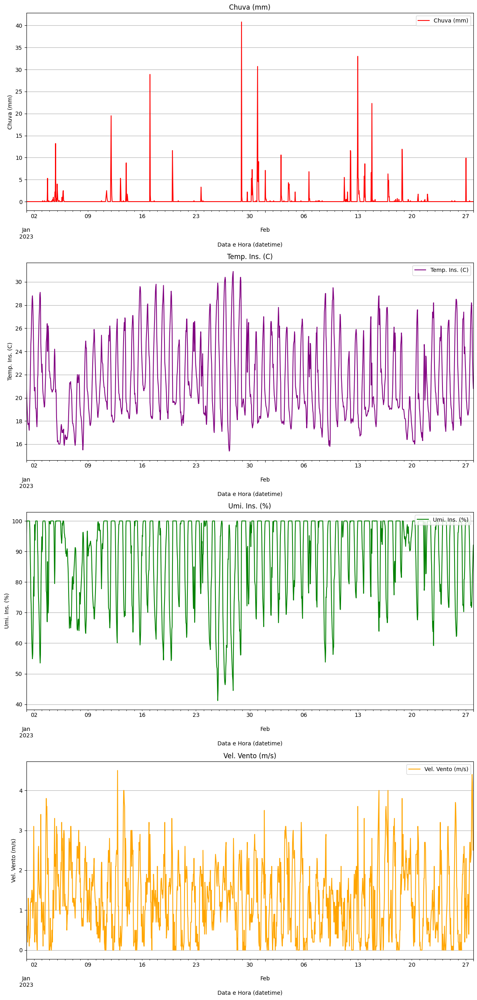

In [777]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

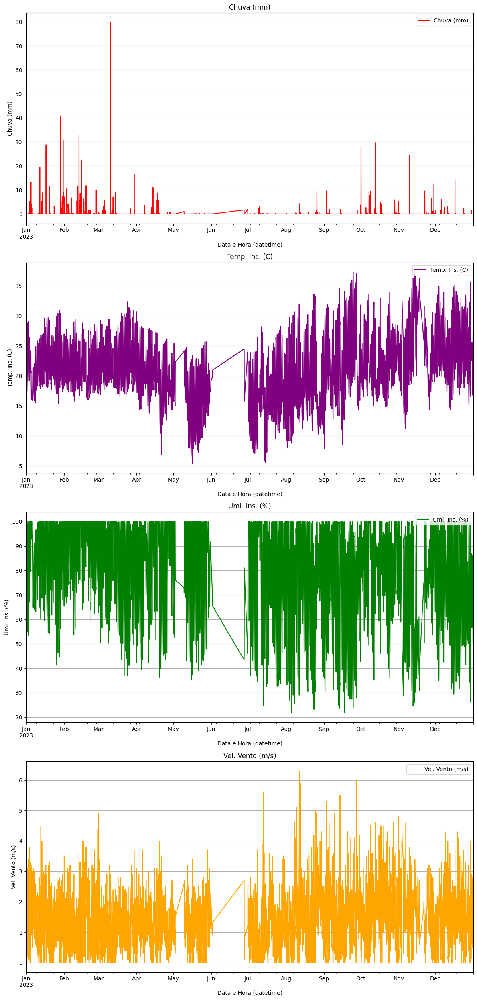

In [778]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [779]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,21.1,93.1,1.1,0.0
2023-01-01 01:00:00,20.2,99.4,0.6,0.0
2023-01-01 02:00:00,19.4,100.0,0.6,0.0
2023-01-01 03:00:00,18.7,100.0,0.6,0.0
2023-01-01 04:00:00,18.1,100.0,0.2,0.0


In [780]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8760, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,0.0,21.1,93.1,1.1
2023-01-01 01:00:00,0.0,20.2,99.4,0.6
2023-01-01 02:00:00,0.0,19.4,100.0,0.6
2023-01-01 03:00:00,0.0,18.7,100.0,0.6
2023-01-01 04:00:00,0.0,18.1,100.0,0.2


In [781]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client_df['Chuva (mm) (t+1)'] = client_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client_df.pop(target_column)
client_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2023-12-31 18:00:00,0.0,0.0,29.6,43.3,2.1
2023-12-31 19:00:00,0.0,0.0,29.4,48.7,4.2
2023-12-31 20:00:00,0.0,0.0,27.7,53.5,3.3
2023-12-31 21:00:00,0.0,0.0,26.3,57.0,3.8
2023-12-31 22:00:00,0.0,0.0,24.2,65.9,3.4


## Saving data as `.csv`

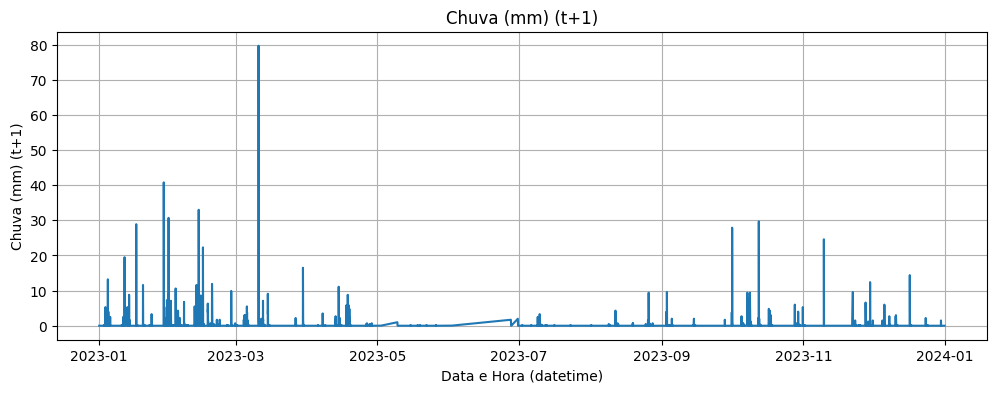

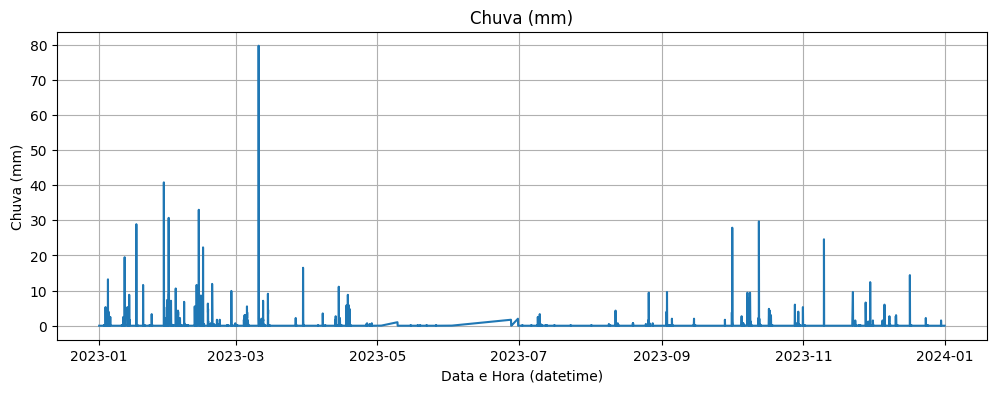

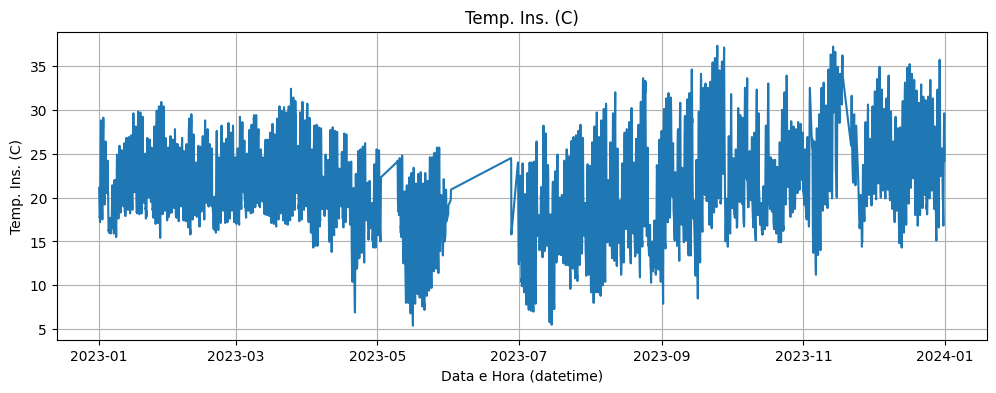

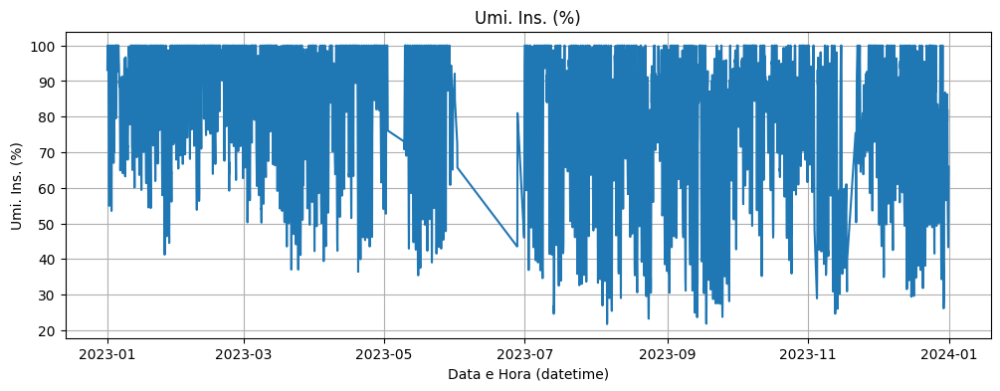

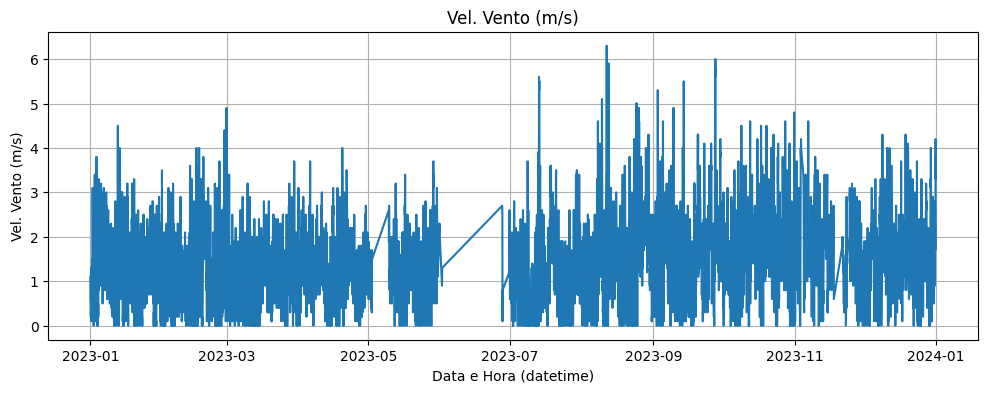

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8759 entries, 2023-01-01 00:00:00 to 2023-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8759 non-null   float64
 1   Chuva (mm)        8759 non-null   float64
 2   Temp. Ins. (C)    8759 non-null   float64
 3   Umi. Ins. (%)     8759 non-null   float64
 4   Vel. Vento (m/s)  8759 non-null   float64
dtypes: float64(5)
memory usage: 410.6 KB


In [782]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client_df.index, client_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client_df.info()

In [783]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2023'
output_dir = 'Datasets tratados/2023'

os.makedirs(output_dir, exist_ok=True)

client_df.to_csv(os.path.join(output_dir, 'Processed_Data_2023-Client-8_V0507_Tatui.csv'),
                 index=True,                        # Include Index in the CSV file
                 date_format='%Y-%m-%d %H:%M:%S'    # Format for the datetime index
                 )

# 9. Client- Dataset (Tatui-FATEC)⭐

## Data collection and pre-processing

In [813]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0508 - Tatui-FATEC - (SEM registros p 2024!!!)/2023/INMET_SE_SP_V0507_TATUI-FATEC-Dataset_01-01-2023_A_31-12-2023.csv'
file_path = 'Datasets Brutos/Estacao_V0508 - Tatui-FATEC - (SEM registros p 2024!!!)/2023/INMET_SE_SP_V0507_TATUI-FATEC-Dataset_01-01-2023_A_31-12-2023.csv'

# Upload CSV file into DataFrame
client_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [814]:
print("Dataframe format:")
print(f" ↪Linhas: {client_df.shape[0]} \n ↪Colunas: {client_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client_df.head()

Dataframe format:
 ↪Linhas: 8760 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2023,0,22.9,NaN,NaN,85.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.5,NaN,NaN,NaN,0.0
1,01/01/2023,100,22.3,NaN,NaN,89.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1,NaN,NaN,NaN,0.0
2,01/01/2023,200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,01/01/2023,300,21.7,NaN,NaN,91.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0
4,01/01/2023,400,21.5,NaN,NaN,92.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1,NaN,NaN,NaN,0.0


In [815]:
# Data general info
print("General Dataset Information:")
print(client_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8760 non-null   object 
 1   Hora (UTC)            8760 non-null   int64  
 2   Temp. Ins. (C)        7344 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         7344 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      7344 non-null   float

In [816]:
print("Descriptive statistics:")
client_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8760.000000,7344.000000,0.0,0.0,7344.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7344.000000,0.0,0.0,0.0,7344.000000
mean,1150.000000,21.743981,NaN,NaN,79.528881,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.507707,NaN,NaN,NaN,0.106019
std,692.258169,5.428179,NaN,NaN,16.954276,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.589929,NaN,NaN,NaN,1.281480
min,0.000000,6.600000,NaN,NaN,27.600000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,18.000000,NaN,NaN,67.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
50%,1150.000000,21.100000,NaN,NaN,84.400000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.300000,NaN,NaN,NaN,0.000000
75%,1725.000000,25.500000,NaN,NaN,93.600000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.800000,NaN,NaN,NaN,0.000000
max,2300.000000,39.300000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.000000,NaN,NaN,NaN,68.400000


In [817]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client_df['Hora (UTC)'] = client_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client_df['Hora Datetime'] = pd.to_datetime(client_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client_df['Data e Hora (datetime)'] = client_df['ï»¿"Data"'] + ' ' + client_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client_df['Data e Hora (datetime)'] = pd.to_datetime(client_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_10224\497734369.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client_df.loc[0, 'Hora (UTC)'] = modified_value


0   2023-01-01 00:00:00
1   2023-01-01 01:00:00
2   2023-01-01 02:00:00
3   2023-01-01 03:00:00
4   2023-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [818]:
client_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2023,0000,22.9,NaN,NaN,85.1,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.5,NaN,NaN,NaN,0.0,00:00:00,2023-01-01 00:00:00
1,01/01/2023,0100,22.3,NaN,NaN,89.8,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.1,NaN,NaN,NaN,0.0,01:00:00,2023-01-01 01:00:00
2,01/01/2023,0200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,02:00:00,2023-01-01 02:00:00
3,01/01/2023,0300,21.7,NaN,NaN,91.9,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0,03:00:00,2023-01-01 03:00:00
4,01/01/2023,0400,21.5,NaN,NaN,92.9,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.1,NaN,NaN,NaN,0.0,04:00:00,2023-01-01 04:00:00


In [819]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client_df = client_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8760, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2023-01-01 00:00:00,22.9,NaN,NaN,85.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.5,NaN,NaN,NaN,0.0
1,2023-01-01 01:00:00,22.3,NaN,NaN,89.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1,NaN,NaN,NaN,0.0
2,2023-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2023-01-01 03:00:00,21.7,NaN,NaN,91.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0
4,2023-01-01 04:00:00,21.5,NaN,NaN,92.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1,NaN,NaN,NaN,0.0


In [820]:
# Indexing of the 'Datetime' Date and Time
client_df.set_index('Data e Hora (datetime)', inplace=True)

client_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,22.9,NaN,NaN,85.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.5,NaN,NaN,NaN,0.0
2023-01-01 01:00:00,22.3,NaN,NaN,89.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1,NaN,NaN,NaN,0.0
2023-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-01 03:00:00,21.7,NaN,NaN,91.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6,NaN,NaN,NaN,0.0
2023-01-01 04:00:00,21.5,NaN,NaN,92.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1,NaN,NaN,NaN,0.0


In [821]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)          1416
Temp. Max. (C)          8760
Temp. Min. (C)          8760
Umi. Ins. (%)           1416
Umi. Max. (%)           8760
Umi. Min. (%)           8760
Pto Orvalho Ins. (C)    8760
Pto Orvalho Max. (C)    8760
Pto Orvalho Min. (C)    8760
Pressao Ins. (hPa)      8760
Pressao Max. (hPa)      8760
Pressao Min. (hPa)      8760
Vel. Vento (m/s)        1416
Dir. Vento (m/s)        8760
Raj. Vento (m/s)        8760
Radiacao (KJ/mÂ²)       8760
Chuva (mm)              1416
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)           16.164384
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)            16.164384
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [822]:
# Dropping columns with 100% missing values
client_df = client_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      16.164384
Umi. Ins. (%)       16.164384
Vel. Vento (m/s)    16.164384
Chuva (mm)          16.164384
dtype: float64


In [823]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [824]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,22.9,85.1,0.5,0.0
2023-01-01 01:00:00,22.3,89.8,0.1,0.0
2023-01-01 02:00:00,NaN,NaN,NaN,NaN
2023-01-01 03:00:00,21.7,91.9,0.6,0.0
2023-01-01 04:00:00,21.5,92.9,0.1,0.0


In [825]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [826]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

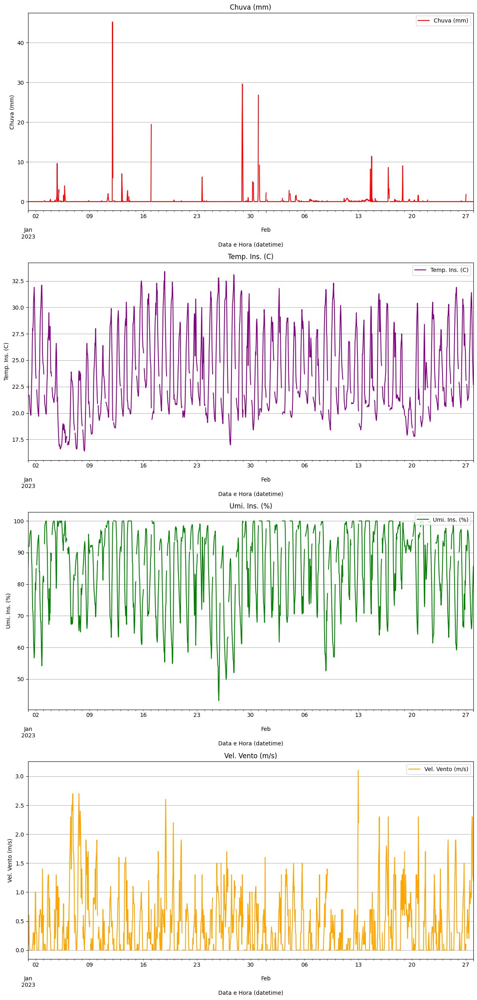

In [827]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

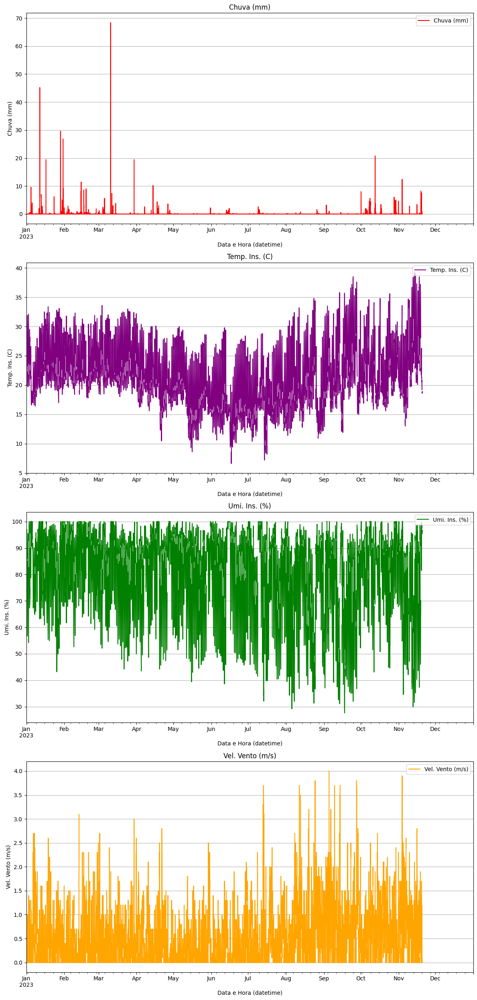

In [828]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [829]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client_df.columns:
    if client_df[column].isnull().any():
        client_df[column] = client_df[column].interpolate(method='linear')  # Interpolação linear

In [830]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [831]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

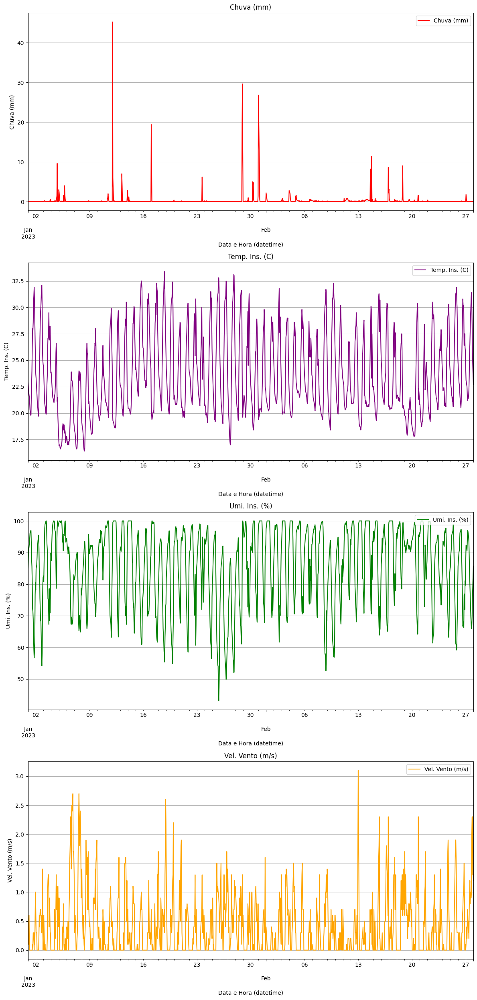

In [832]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

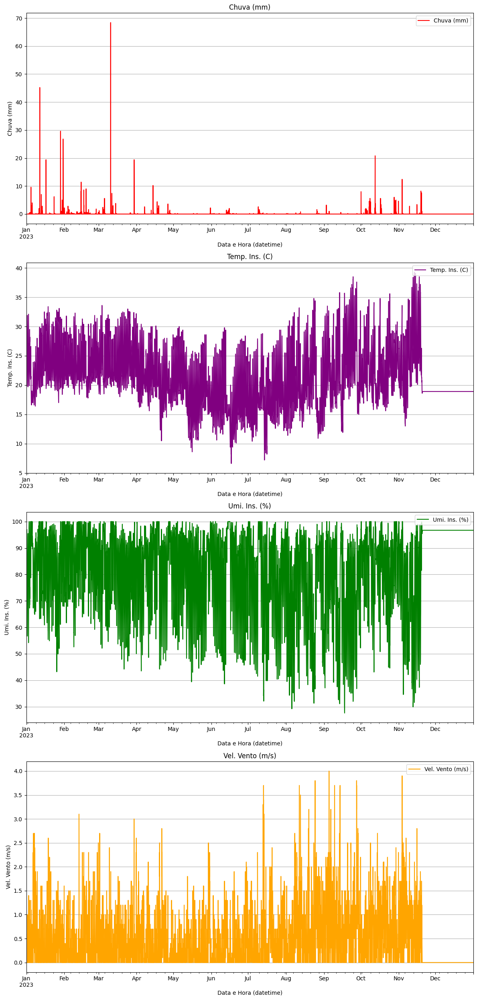

In [833]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [834]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,22.9,85.10,0.50,0.0
2023-01-01 01:00:00,22.3,89.80,0.10,0.0
2023-01-01 02:00:00,22.0,90.85,0.35,0.0
2023-01-01 03:00:00,21.7,91.90,0.60,0.0
2023-01-01 04:00:00,21.5,92.90,0.10,0.0


In [835]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8760, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,0.0,22.9,85.10,0.50
2023-01-01 01:00:00,0.0,22.3,89.80,0.10
2023-01-01 02:00:00,0.0,22.0,90.85,0.35
2023-01-01 03:00:00,0.0,21.7,91.90,0.60
2023-01-01 04:00:00,0.0,21.5,92.90,0.10


In [836]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client_df['Chuva (mm) (t+1)'] = client_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client_df.pop(target_column)
client_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2023-12-31 18:00:00,0.0,0.0,18.9,96.7,0.0
2023-12-31 19:00:00,0.0,0.0,18.9,96.7,0.0
2023-12-31 20:00:00,0.0,0.0,18.9,96.7,0.0
2023-12-31 21:00:00,0.0,0.0,18.9,96.7,0.0
2023-12-31 22:00:00,0.0,0.0,18.9,96.7,0.0


## Saving data as `.csv`

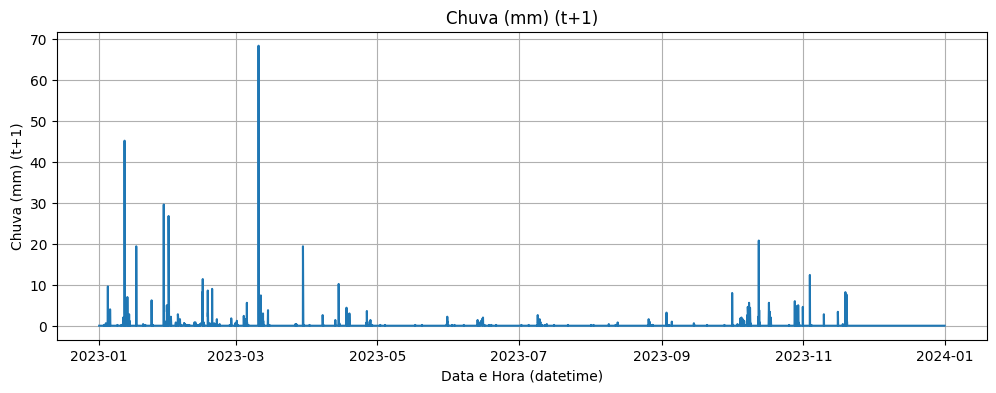

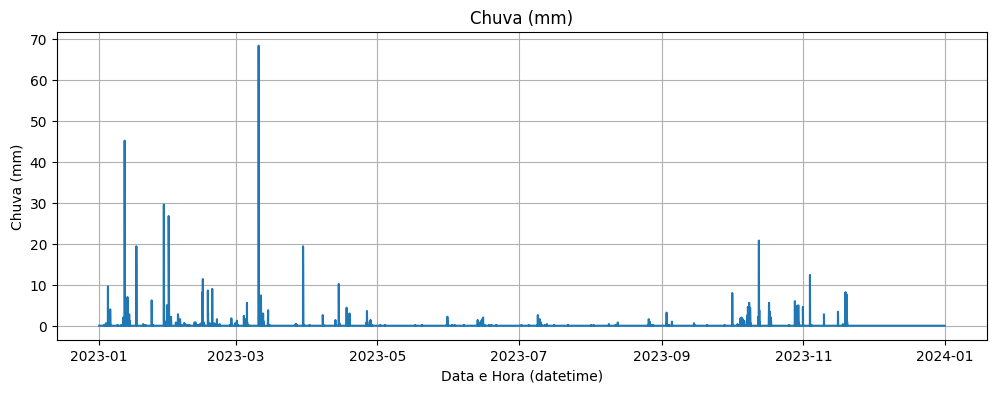

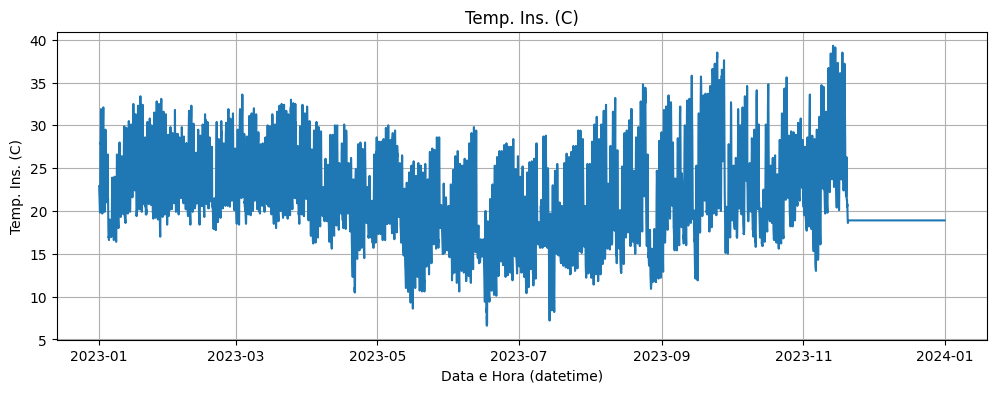

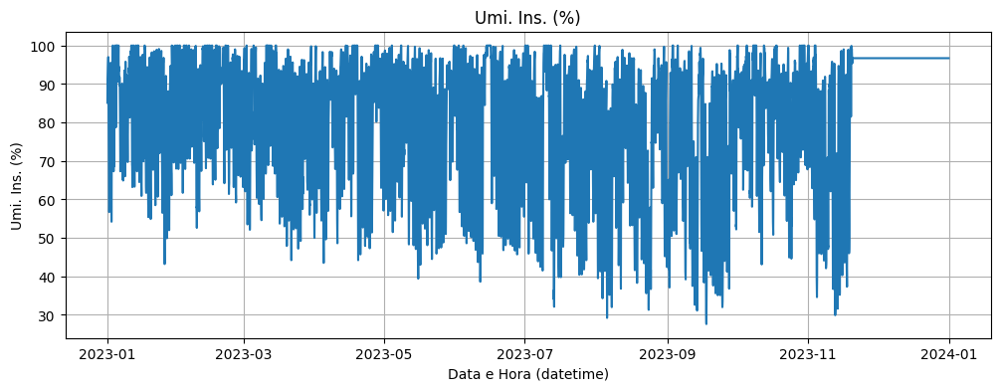

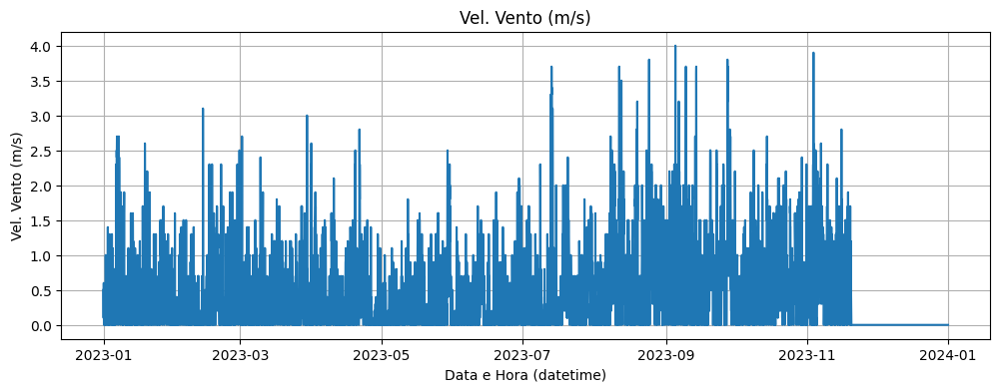

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8759 entries, 2023-01-01 00:00:00 to 2023-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8759 non-null   float64
 1   Chuva (mm)        8759 non-null   float64
 2   Temp. Ins. (C)    8759 non-null   float64
 3   Umi. Ins. (%)     8759 non-null   float64
 4   Vel. Vento (m/s)  8759 non-null   float64
dtypes: float64(5)
memory usage: 410.6 KB


In [837]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client_df.index, client_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client_df.info()

In [838]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2023'
output_dir = 'Datasets tratados/2023'

os.makedirs(output_dir, exist_ok=True)

client_df.to_csv(os.path.join(output_dir, 'Processed_Data_2023-Client-9_V0508_Tatui-FATEC.csv'),
                 index=True,                        # Include Index in the CSV file
                 date_format='%Y-%m-%d %H:%M:%S'    # Format for the datetime index
                 )

# 10. Client- Dataset (São Roque)⭐

## Data collection and pre-processing

In [839]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0533 - Sao Roque/2023/INMET_SE_SP_V0533_SAO_ROQUE-Dataset_01-01-2023_A_31-12-2023.csv'
file_path = 'Datasets Brutos/Estacao_V0533 - Sao Roque/2023/INMET_SE_SP_V0533_SAO_ROQUE-Dataset_01-01-2023_A_31-12-2023.csv'

# Upload CSV file into DataFrame
client2_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [840]:
print("Dataframe format:")
print(f" ↪Linhas: {client2_df.shape[0]} \n ↪Colunas: {client2_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client2_df.head()

Dataframe format:
 ↪Linhas: 8760 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2023,0,19.5,NaN,NaN,95.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,01/01/2023,100,18.9,NaN,NaN,96.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,01/01/2023,200,18.2,NaN,NaN,96.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,01/01/2023,300,17.7,NaN,NaN,97.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,01/01/2023,400,17.2,NaN,NaN,97.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [841]:
# Data general info
print("General Dataset Information:")
print(client2_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8760 non-null   object 
 1   Hora (UTC)            8760 non-null   int64  
 2   Temp. Ins. (C)        8263 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8263 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      8263 non-null   float

In [842]:
print("Descriptive statistics:")
client2_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8760.000000,8263.000000,0.0,0.0,8263.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8263.0,0.0,0.0,0.0,8263.000000
mean,1150.000000,21.666937,NaN,NaN,76.069575,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.171802
std,692.258169,5.472632,NaN,NaN,15.109297,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,1.506183
min,0.000000,5.900000,NaN,NaN,21.600000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.000000
25%,575.000000,18.100000,NaN,NaN,67.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.000000
50%,1150.000000,21.100000,NaN,NaN,81.700000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.000000
75%,1725.000000,25.300000,NaN,NaN,87.400000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.000000
max,2300.000000,37.900000,NaN,NaN,97.400000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,57.900000


In [843]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client2_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client2_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client2_df['Hora (UTC)'] = client2_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client2_df['Hora Datetime'] = pd.to_datetime(client2_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client2_df['Data e Hora (datetime)'] = client2_df['ï»¿"Data"'] + ' ' + client2_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client2_df['Data e Hora (datetime)'] = pd.to_datetime(client2_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client2_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_10224\2898631049.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client2_df.loc[0, 'Hora (UTC)'] = modified_value


0   2023-01-01 00:00:00
1   2023-01-01 01:00:00
2   2023-01-01 02:00:00
3   2023-01-01 03:00:00
4   2023-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [844]:
client2_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2023,0000,19.5,NaN,NaN,95.6,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,00:00:00,2023-01-01 00:00:00
1,01/01/2023,0100,18.9,NaN,NaN,96.2,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,01:00:00,2023-01-01 01:00:00
2,01/01/2023,0200,18.2,NaN,NaN,96.7,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,02:00:00,2023-01-01 02:00:00
3,01/01/2023,0300,17.7,NaN,NaN,97.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,03:00:00,2023-01-01 03:00:00
4,01/01/2023,0400,17.2,NaN,NaN,97.2,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,04:00:00,2023-01-01 04:00:00


In [845]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client2_df = client2_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client2_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client2_df.pop(column)          # remove the column
client2_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client2_df.shape)

client2_df.head()

DataFrame format:
(8760, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2023-01-01 00:00:00,19.5,NaN,NaN,95.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,2023-01-01 01:00:00,18.9,NaN,NaN,96.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,2023-01-01 02:00:00,18.2,NaN,NaN,96.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,2023-01-01 03:00:00,17.7,NaN,NaN,97.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,2023-01-01 04:00:00,17.2,NaN,NaN,97.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [846]:
# Indexing of the 'Datetime' Date and Time
client2_df.set_index('Data e Hora (datetime)', inplace=True)

client2_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,19.5,NaN,NaN,95.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 01:00:00,18.9,NaN,NaN,96.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 02:00:00,18.2,NaN,NaN,96.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 03:00:00,17.7,NaN,NaN,97.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2023-01-01 04:00:00,17.2,NaN,NaN,97.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [847]:
# Check missing values
print("Amount of missing values per column:")
print(client2_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client2_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           497
Temp. Max. (C)          8760
Temp. Min. (C)          8760
Umi. Ins. (%)            497
Umi. Max. (%)           8760
Umi. Min. (%)           8760
Pto Orvalho Ins. (C)    8760
Pto Orvalho Max. (C)    8760
Pto Orvalho Min. (C)    8760
Pressao Ins. (hPa)      8760
Pressao Max. (hPa)      8760
Pressao Min. (hPa)      8760
Vel. Vento (m/s)         497
Dir. Vento (m/s)        8760
Raj. Vento (m/s)        8760
Radiacao (KJ/mÂ²)       8760
Chuva (mm)               497
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            5.673516
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)             5.673516
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [848]:
# Dropping columns with 100% missing values
client2_df = client2_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client2_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      5.673516
Umi. Ins. (%)       5.673516
Vel. Vento (m/s)    5.673516
Chuva (mm)          5.673516
dtype: float64


In [849]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [850]:
client2_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,19.5,95.6,0.0,0.0
2023-01-01 01:00:00,18.9,96.2,0.0,0.0
2023-01-01 02:00:00,18.2,96.7,0.0,0.0
2023-01-01 03:00:00,17.7,97.0,0.0,0.0
2023-01-01 04:00:00,17.2,97.2,0.0,0.0


In [851]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [852]:
# Filters the data by interval
client2_df_intervalo = client2_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

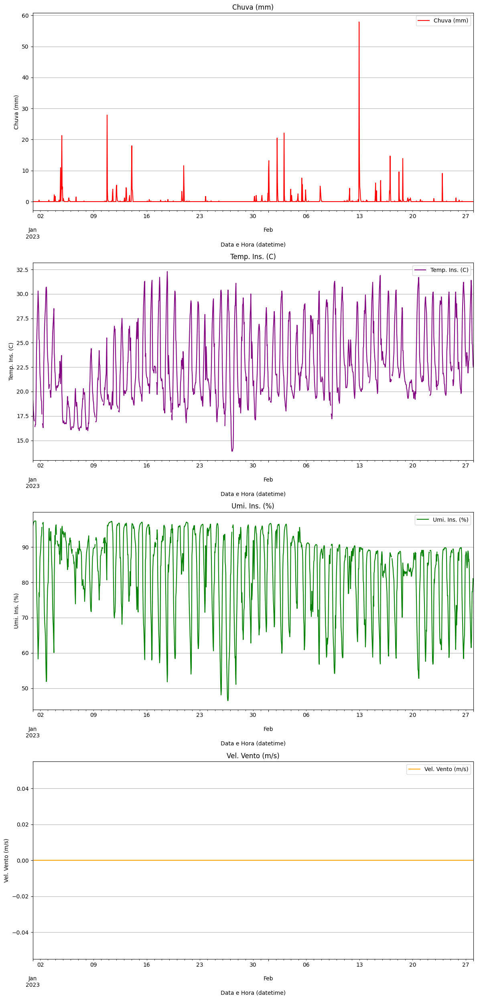

In [853]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df_intervalo.plot(y=client2_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client2_df_intervalo.columns[3])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df_intervalo.columns[0])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client2_df_intervalo.columns[1])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df_intervalo.columns[3])
axes[1].set_ylabel(client2_df_intervalo.columns[0])
axes[2].set_ylabel(client2_df_intervalo.columns[1])
axes[3].set_ylabel(client2_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

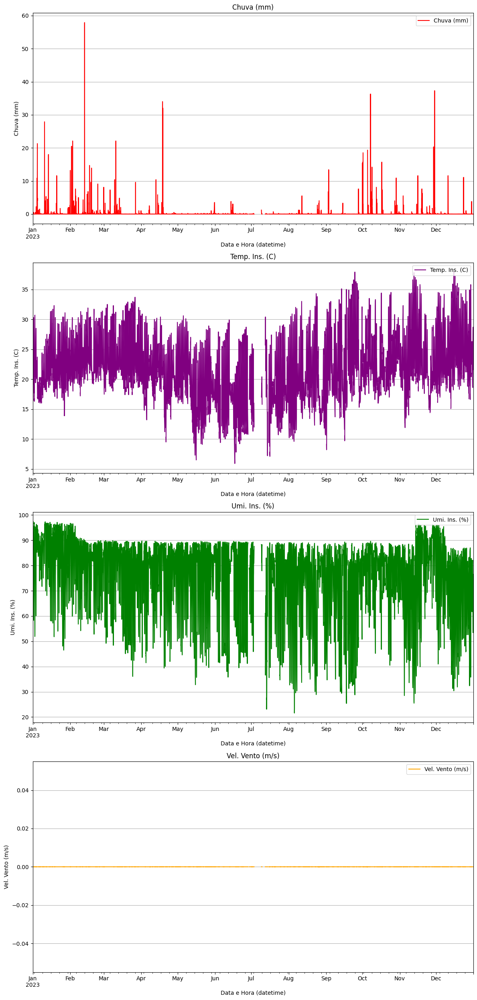

In [854]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df.plot(y=client2_df.columns[3], ax=axes[0], color='red', legend=True, title=client2_df.columns[3])
client2_df.plot(y=client2_df.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df.columns[0])
client2_df.plot(y=client2_df.columns[1], ax=axes[2], color='green', legend=True, title=client2_df.columns[1])
client2_df.plot(y=client2_df.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df.columns[3])
axes[1].set_ylabel(client2_df.columns[0])
axes[2].set_ylabel(client2_df.columns[1])
axes[3].set_ylabel(client2_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [855]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client2_df.columns:
    if client2_df[column].isnull().any():
        client2_df[column] = client2_df[column].interpolate(method='linear')  # Interpolação linear

In [856]:
# Check missing values
print("Amount of missing values per column:")
print(client2_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client2_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [857]:
# Filters the data by interval
client2_df_intervalo = client2_df.loc['2023-01-01 00:00:00':'2023-02-28 00:00:00']

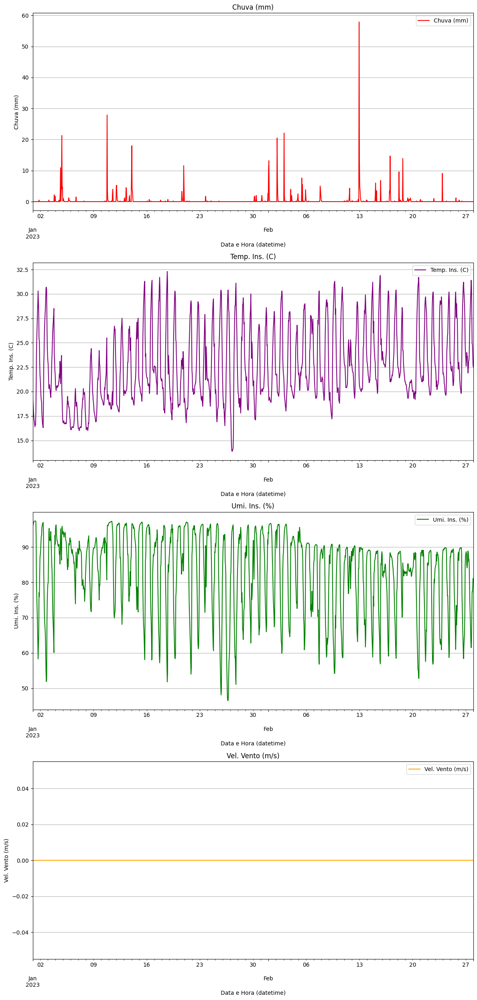

In [858]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df_intervalo.plot(y=client2_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client2_df_intervalo.columns[3])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df_intervalo.columns[0])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client2_df_intervalo.columns[1])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df_intervalo.columns[3])
axes[1].set_ylabel(client2_df_intervalo.columns[0])
axes[2].set_ylabel(client2_df_intervalo.columns[1])
axes[3].set_ylabel(client2_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

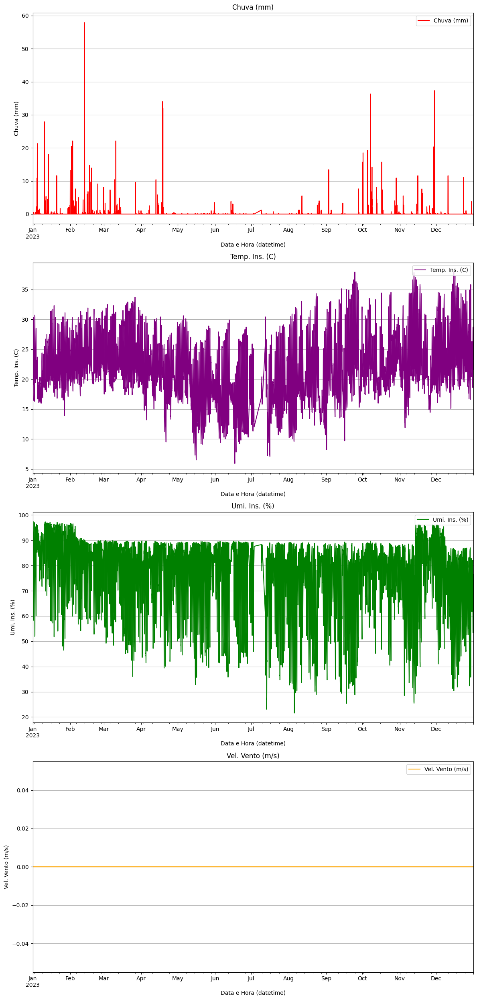

In [859]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df.plot(y=client2_df.columns[3], ax=axes[0], color='red', legend=True, title=client2_df.columns[3])
client2_df.plot(y=client2_df.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df.columns[0])
client2_df.plot(y=client2_df.columns[1], ax=axes[2], color='green', legend=True, title=client2_df.columns[1])
client2_df.plot(y=client2_df.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df.columns[3])
axes[1].set_ylabel(client2_df.columns[0])
axes[2].set_ylabel(client2_df.columns[1])
axes[3].set_ylabel(client2_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [860]:
client2_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,19.5,95.6,0.0,0.0
2023-01-01 01:00:00,18.9,96.2,0.0,0.0
2023-01-01 02:00:00,18.2,96.7,0.0,0.0
2023-01-01 03:00:00,17.7,97.0,0.0,0.0
2023-01-01 04:00:00,17.2,97.2,0.0,0.0


In [861]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client2_df.pop(column)          # remove the column
client2_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client2_df.shape)

client2_df.head()

DataFrame format:
(8760, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2023-01-01 00:00:00,0.0,19.5,95.6,0.0
2023-01-01 01:00:00,0.0,18.9,96.2,0.0
2023-01-01 02:00:00,0.0,18.2,96.7,0.0
2023-01-01 03:00:00,0.0,17.7,97.0,0.0
2023-01-01 04:00:00,0.0,17.2,97.2,0.0


In [862]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client2_df['Chuva (mm) (t+1)'] = client2_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client2_df.pop(target_column)
client2_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client2_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client2_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2023-12-31 18:00:00,0.0,0.0,28.7,57.3,0.0
2023-12-31 19:00:00,0.0,0.0,28.4,59.0,0.0
2023-12-31 20:00:00,0.0,0.0,26.6,62.7,0.0
2023-12-31 21:00:00,0.0,0.0,24.9,67.6,0.0
2023-12-31 22:00:00,0.0,0.0,22.2,75.1,0.0


## Saving data as `.csv`

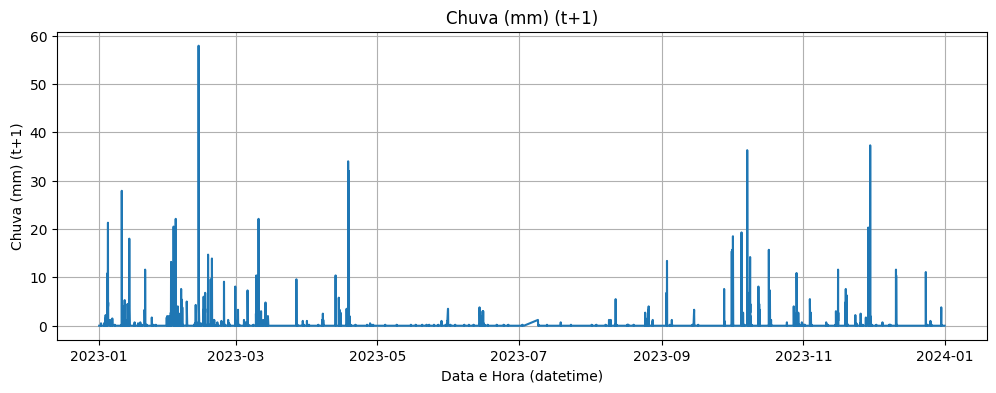

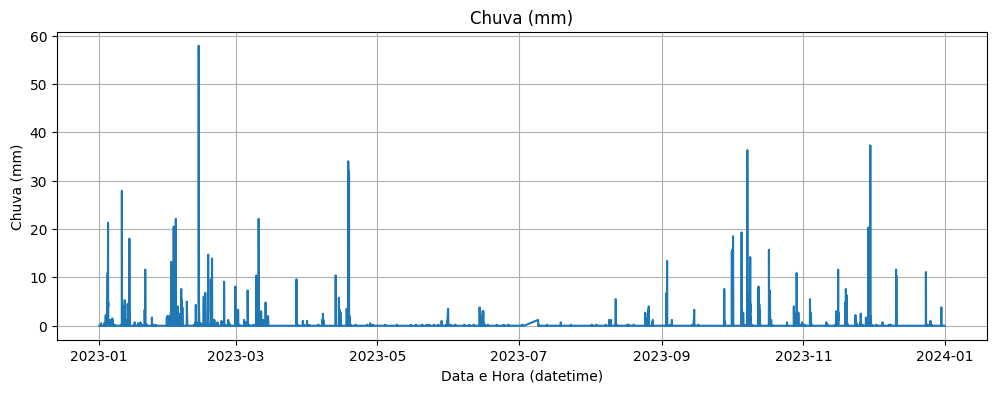

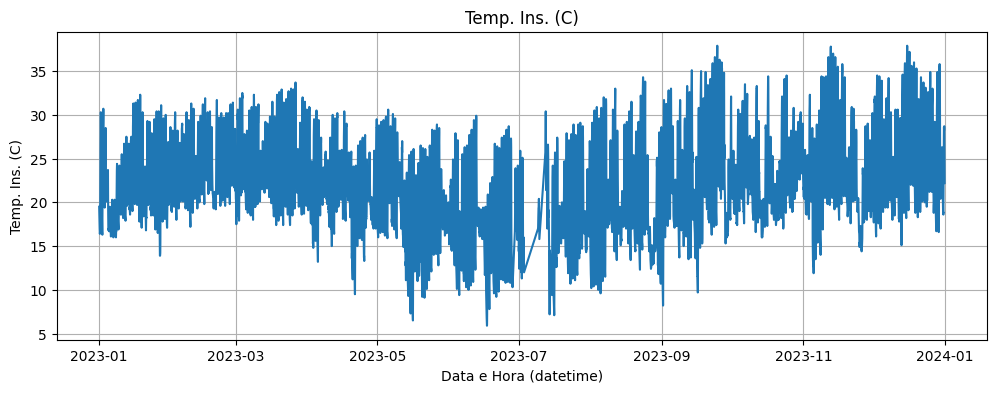

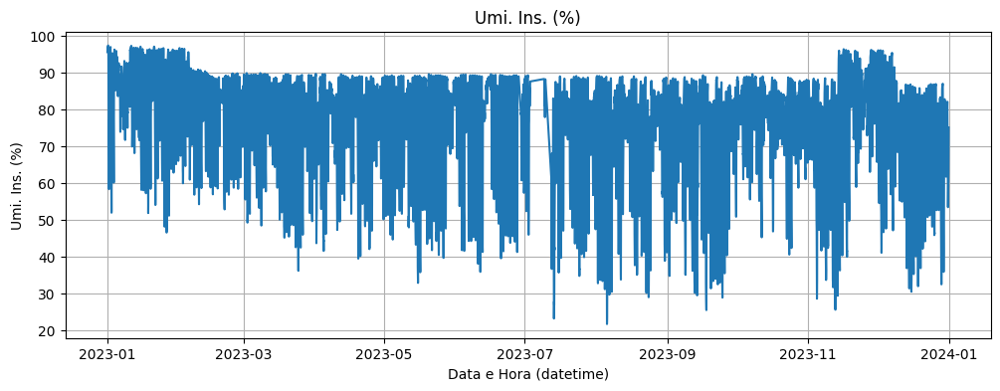

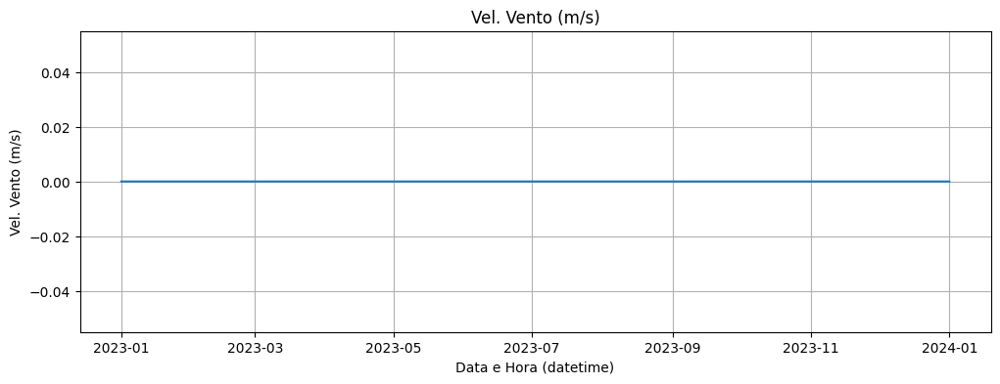

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8759 entries, 2023-01-01 00:00:00 to 2023-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8759 non-null   float64
 1   Chuva (mm)        8759 non-null   float64
 2   Temp. Ins. (C)    8759 non-null   float64
 3   Umi. Ins. (%)     8759 non-null   float64
 4   Vel. Vento (m/s)  8759 non-null   float64
dtypes: float64(5)
memory usage: 410.6 KB


In [863]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client2_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client2_df.index, client2_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client2_df.info()

In [864]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2023'
output_dir = 'Datasets tratados/2023'

os.makedirs(output_dir, exist_ok=True)

client2_df.to_csv(os.path.join(output_dir, 'Processed_Data_2023-Client-10_V0533_Sao Roque.csv'),
                  index=True,                       # Include Index in the CSV file
                  date_format='%Y-%m-%d %H:%M:%S'   # Format for the datetime index
                  )